In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import xgboost as xgb
import joblib

# Attempt to import Explainable AI Libraries
try:
    import shap
  
    print(f"SHAP version: {shap.__version__}")
   
except ModuleNotFoundError as e:
    print(f"ModuleNotFoundError: {e}. Please ensure all required libraries are installed.")

import warnings
warnings.filterwarnings('ignore')
from matplotlib.patches import Rectangle

# Attempt to import Plotly Libraries
try:
    import plotly.graph_objects as go
    from plotly.subplots import make_subplots
    import plotly.express as px
except ModuleNotFoundError as e:
    print(f"ModuleNotFoundError: {e}. Please ensure Plotly is installed.")

# Data preprocessing
from sklearn.preprocessing import StandardScaler, RobustScaler, LabelEncoder, MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import SelectKBest, f_classif, RFE, mutual_info_classif
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

# Model selection and validation
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_recall_fscore_support
from sklearn.metrics import ConfusionMatrixDisplay, roc_auc_score, roc_curve

# Models
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, VotingClassifier, BaggingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier

# Imbalanced learning
from imblearn.over_sampling import SMOTE, ADASYN
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN
from imblearn.pipeline import Pipeline as ImbPipeline
print("✅ Explainable AI libraries import attempt completed!")


ModuleNotFoundError: No module named 'shap'. Please ensure all required libraries are installed.
ModuleNotFoundError: No module named 'plotly'. Please ensure Plotly is installed.
✅ Explainable AI libraries import attempt completed!


# Reading Data Into Pandas Dataframe

In [2]:

df = pd.read_csv('CVD Dataset.csv')
df

,Sex,Age,Weight (kg),Height (m),BMI,Abdominal Circumference (cm),Blood Pressure (mmHg),Total Cholesterol (mg/dL),HDL (mg/dL),Fasting Blood Sugar (mg/dL),...,Physical Activity Level,Family History of CVD,CVD Risk Level,Height (cm),Waist-to-Height Ratio,Systolic BP,Diastolic BP,Blood Pressure Category,Estimated LDL (mg/dL),CVD Risk Score
0,F,32.000,69.100,1.710,23.600,86.200,125/79,248.000,78.000,111.000,...,Low,N,INTERMEDIARY,171.000,0.504,125.000,79.000,Elevated,140.000,17.930
1,F,55.000,118.700,1.690,41.600,82.500,139/70,162.000,50.000,135.000,...,High,Y,HIGH,169.000,0.488,139.000,70.000,Hypertension Stage 1,82.000,20.510
2,M,NaN,NaN,1.830,26.900,106.700,104/77,103.000,73.000,114.000,...,High,Y,INTERMEDIARY,183.000,0.583,104.000,77.000,Normal,0.000,12.640
3,M,44.000,108.300,1.800,33.400,96.600,140/83,134.000,46.000,91.000,...,High,Y,INTERMEDIARY,NaN,0.537,140.000,83.000,Hypertension Stage 1,58.000,16.360
4,F,32.000,99.500,1.860,28.800,102.700,144/83,146.000,64.000,141.000,...,High,N,INTERMEDIARY,186.000,0.552,144.000,83.000,Hypertension Stage 1,52.000,17.880
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1992,F,34.572,126.256,1.750,28.183,86.548,105/118,163.461,67.103,93.418,...,Moderate,Y,INTERMEDIARY,174.557,0.507,105.288,121.402,Hypertension Stage 2,56.561,13.340
1993,M,54.031,93.868,1.853,38.023,98.292,103/96,111.390,38.984,120.946,...,Low,Y,HIGH,182.485,0.590,112.909,96.498,Hypertension Stage 2,38.241,15.725
1994,F,44.761,109.131,1.905,31.598,85.423,109/91,153.961,67.127,133.425,...,High,Y,INTERMEDIARY,190.888,0.471,113.974,91.443,Hypertension Stage 2,53.001,16.831
1995,M,32.460,61.314,2.080,27.476,106.257,154/97,166.958,58.111,132.970,...,Low,Y,INTERMEDIARY,201.774,0.506,150.429,94.720,Hypertension Stage 2,84.127,18.152


## CVD Dataset Structure: Number of Subjects per Attribute

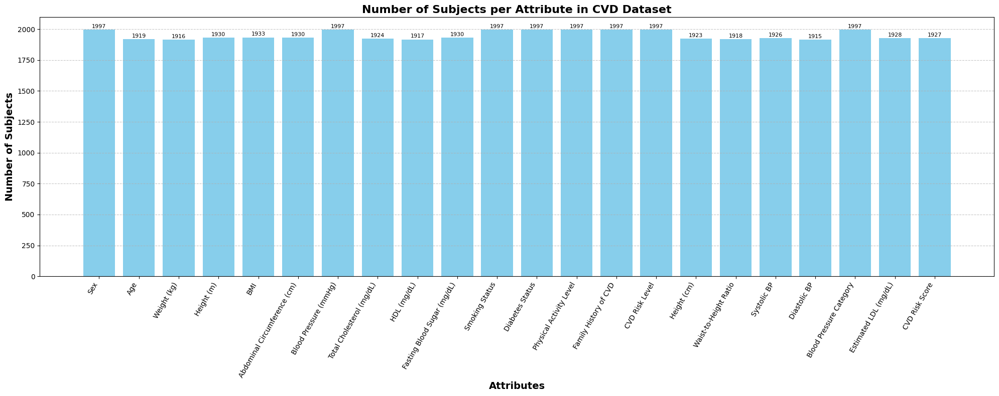

In [3]:


# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
df = pd.read_csv('CVD Dataset.csv')

# Count the number of non-null entries for each column
attribute_counts = df.notnull().sum()

# Plotting
plt.figure(figsize=(20, 8))
bars = plt.bar(attribute_counts.index, attribute_counts.values, color='skyblue')

# Adding counts above bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2.0, yval + 5, int(yval), ha='center', va='bottom', fontsize=8)

# Customize the plot
plt.xticks(rotation=60, ha='right')
plt.xlabel('Attributes', fontsize=14, weight='bold')
plt.ylabel('Number of Subjects', fontsize=14, weight='bold')
plt.title('Number of Subjects per Attribute in CVD Dataset', fontsize=16, weight='bold')
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

df.info(): This function provides a concise summary of the DataFrame. It includes information about the index dtype, column dtypes, non-null values, and memory usage. This is useful for quickly understanding the data types and identifying columns with missing values.

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1997 entries, 0 to 1996
Data columns (total 22 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Sex                           1997 non-null   object 
 1   Age                           1919 non-null   float64
 2   Weight (kg)                   1916 non-null   float64
 3   Height (m)                    1930 non-null   float64
 4   BMI                           1933 non-null   float64
 5   Abdominal Circumference (cm)  1930 non-null   float64
 6   Blood Pressure (mmHg)         1997 non-null   object 
 7   Total Cholesterol (mg/dL)     1924 non-null   float64
 8   HDL (mg/dL)                   1917 non-null   float64
 9   Fasting Blood Sugar (mg/dL)   1930 non-null   float64
 10  Smoking Status                1997 non-null   object 
 11  Diabetes Status               1997 non-null   object 
 12  Physical Activity Level       1997 non-null   object 
 13  Fam

df.shape(): This function is used to understand the number of rows (observations) and columns (features) in the dataset. This gives an overview of the dataset's size and structure.





In [5]:
df.shape

(1997, 22)

df.describe(): This function generates descriptive statistics of the DataFrame. It provides insights into the central tendency, dispersion, and shape of the distribution of each numerical column, including count, mean, standard deviation, min, max, and quartile values. This is crucial for understanding the basic statistical properties of the data.


In [6]:
df.describe()

,Age,Weight (kg),Height (m),BMI,Abdominal Circumference (cm),Total Cholesterol (mg/dL),HDL (mg/dL),Fasting Blood Sugar (mg/dL),Height (cm),Waist-to-Height Ratio,Systolic BP,Diastolic BP,Estimated LDL (mg/dL),CVD Risk Score
count,1919.000000,1916.000000,1930.000000,1933.000000,1930.000000,1924.000000,1917.000000,1930.000000,1923.000000,1918.000000,1926.000000,1915.000000,1928.000000,1927.000000
mean,46.976388,85.775467,1.753434,28.412350,91.948786,198.912751,56.230196,117.973572,175.578515,0.526465,126.094990,83.175438,112.099965,16.980179
std,12.419171,21.153343,0.120907,7.036888,13.142832,57.618815,16.207853,30.435171,12.107548,0.081971,22.383205,14.599813,58.543122,2.461753
min,23.291000,44.373000,1.386000,14.362000,64.567000,96.054000,27.020000,65.087000,140.110000,0.350000,82.347000,55.598000,-18.644000,10.530000
25%,37.000000,66.874500,1.660000,22.600000,80.591500,150.538250,42.000000,93.000000,166.375000,0.461000,108.000000,71.000000,62.000000,15.209000
50%,46.000000,86.500000,1.752000,28.066000,91.718500,197.000000,56.000000,116.000000,175.510000,0.523000,125.000000,82.704000,109.429500,16.910000
75%,55.000000,104.485000,1.850000,33.801000,102.300000,249.000000,70.000000,138.000000,184.919500,0.584000,141.590000,93.000000,159.970000,18.700000
max,86.924000,129.256000,2.113000,46.908000,130.123000,322.362000,92.177000,203.356000,218.593000,0.787000,197.536000,123.619000,250.349000,24.170000


df.head(): This function displays the first 5 rows of the DataFrame by default. It's useful for getting a quick glimpse of the data, understanding its structure, and verifying that the data has been loaded correctly.


In [7]:
df.head()

,Sex,Age,Weight (kg),Height (m),BMI,Abdominal Circumference (cm),Blood Pressure (mmHg),Total Cholesterol (mg/dL),HDL (mg/dL),Fasting Blood Sugar (mg/dL),...,Physical Activity Level,Family History of CVD,CVD Risk Level,Height (cm),Waist-to-Height Ratio,Systolic BP,Diastolic BP,Blood Pressure Category,Estimated LDL (mg/dL),CVD Risk Score
0,F,32.0,69.1,1.71,23.6,86.2,125/79,248.0,78.0,111.0,...,Low,N,INTERMEDIARY,171.0,0.504,125.0,79.0,Elevated,140.0,17.93
1,F,55.0,118.7,1.69,41.6,82.5,139/70,162.0,50.0,135.0,...,High,Y,HIGH,169.0,0.488,139.0,70.0,Hypertension Stage 1,82.0,20.51
2,M,NaN,NaN,1.83,26.9,106.7,104/77,103.0,73.0,114.0,...,High,Y,INTERMEDIARY,183.0,0.583,104.0,77.0,Normal,0.0,12.64
3,M,44.0,108.3,1.80,33.4,96.6,140/83,134.0,46.0,91.0,...,High,Y,INTERMEDIARY,NaN,0.537,140.0,83.0,Hypertension Stage 1,58.0,16.36
4,F,32.0,99.5,1.86,28.8,102.7,144/83,146.0,64.0,141.0,...,High,N,INTERMEDIARY,186.0,0.552,144.0,83.0,Hypertension Stage 1,52.0,17.88


df.describe().T: This method gives a statistical summary of the DataFrame (Transpose) showing values like count, mean, standard deviation, minimum and quartiles for each numerical column. It helps in summarizing the central tendency and spread of the data

In [8]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1919.0,46.976388,12.419171,23.291,37.00000,46.0000,55.0000,86.924
Weight (kg),1916.0,85.775467,21.153343,44.373,66.87450,86.5000,104.4850,129.256
Height (m),1930.0,1.753434,0.120907,1.386,1.66000,1.7520,1.8500,2.113
BMI,1933.0,28.412350,7.036888,14.362,22.60000,28.0660,33.8010,46.908
Abdominal Circumference (cm),1930.0,91.948786,13.142832,64.567,80.59150,91.7185,102.3000,130.123
Total Cholesterol (mg/dL),1924.0,198.912751,57.618815,96.054,150.53825,197.0000,249.0000,322.362
HDL (mg/dL),1917.0,56.230196,16.207853,27.020,42.00000,56.0000,70.0000,92.177
Fasting Blood Sugar (mg/dL),1930.0,117.973572,30.435171,65.087,93.00000,116.0000,138.0000,203.356
Height (cm),1923.0,175.578515,12.107548,140.110,166.37500,175.5100,184.9195,218.593
Waist-to-Height Ratio,1918.0,0.526465,0.081971,0.350,0.46100,0.5230,0.5840,0.787


df.columns.tolist(): This converts the column names of the DataFrame into a Python list making it easy to access and manipulate the column names.

In [9]:
df.columns.tolist()

['Sex',
 'Age',
 'Weight (kg)',
 'Height (m)',
 'BMI',
 'Abdominal Circumference (cm)',
 'Blood Pressure (mmHg)',
 'Total Cholesterol (mg/dL)',
 'HDL (mg/dL)',
 'Fasting Blood Sugar (mg/dL)',
 'Smoking Status',
 'Diabetes Status',
 'Physical Activity Level',
 'Family History of CVD',
 'CVD Risk Level',
 'Height (cm)',
 'Waist-to-Height Ratio',
 'Systolic BP',
 'Diastolic BP',
 'Blood Pressure Category',
 'Estimated LDL (mg/dL)',
 'CVD Risk Score']

# Enhanced Data Exploration

In [10]:

print("===  DATASET OVERVIEW ===")
print(f"Shape: {df.shape}")
print(f"Target Distribution:")
print(df['CVD Risk Score'].value_counts())
print(f"Target Distribution (%):")
print(df['CVD Risk Score'].value_counts(normalize=True) * 100)


===  DATASET OVERVIEW ===
Shape: (1997, 22)
Target Distribution:
CVD Risk Score
14.160    5
17.630    5
14.400    5
15.450    5
17.950    5
         ..
11.366    1
15.698    1
13.798    1
17.760    1
20.360    1
Name: count, Length: 1446, dtype: int64
Target Distribution (%):
CVD Risk Score
14.160    0.259471
17.630    0.259471
14.400    0.259471
15.450    0.259471
17.950    0.259471
            ...   
11.366    0.051894
15.698    0.051894
13.798    0.051894
17.760    0.051894
20.360    0.051894
Name: proportion, Length: 1446, dtype: float64


===  DATASET OVERVIEW ===
Shape: (1997, 22)
Target Distribution:


CVD Risk Level
HIGH            944
INTERMEDIARY    765
LOW             288
Name: count, dtype: int64
Target Distribution (%):
CVD Risk Level
HIGH            47.270906
INTERMEDIARY    38.307461
LOW             14.421632
Name: proportion, dtype: float64

=== SEX vs CVD Risk Level ===
CVD Risk Level  HIGH  INTERMEDIARY  LOW
Sex                                    
#NAME?             0             1    0
F                499           398  135
M                445           366  153

Sex vs CVD Risk Level (%)
CVD Risk Level       HIGH  INTERMEDIARY        LOW
Sex                                               
#NAME?           0.000000    100.000000   0.000000
F               48.352713     38.565891  13.081395
M               46.161826     37.966805  15.871369


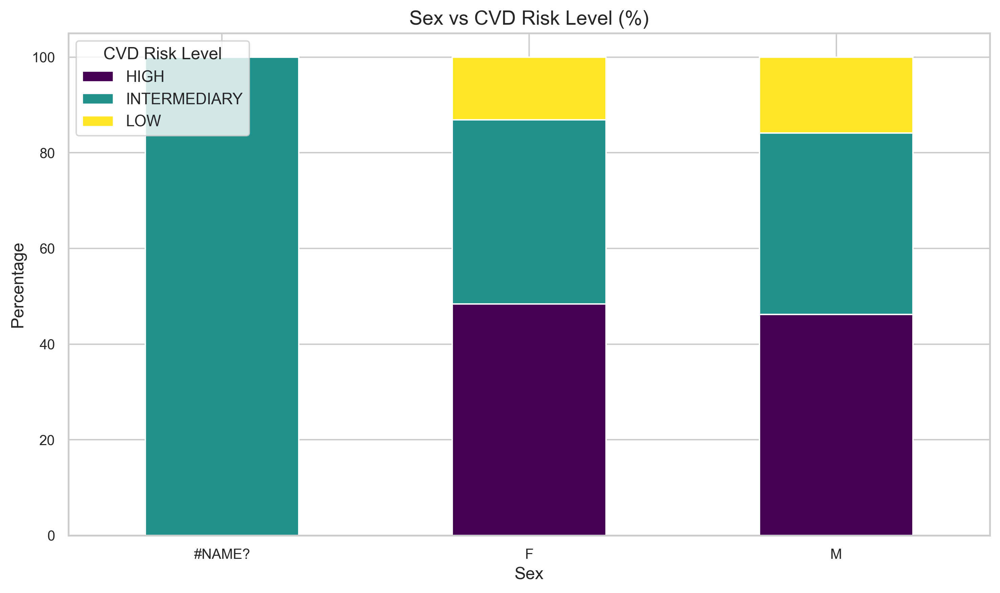

In [117]:

print("===  DATASET OVERVIEW ===")
print(f"Shape: {df.shape}")
print(f"Target Distribution:")
print(df['CVD Risk Level'].value_counts())
print(f"Target Distribution (%):")
print(df['CVD Risk Level'].value_counts(normalize=True) * 100)

print("\n=== SEX vs CVD Risk Level ===")
sex_cvd_relation = pd.crosstab(df['Sex'], df['CVD Risk Level'])
print(sex_cvd_relation)
sex_cvd_relation_percent = pd.crosstab(df['Sex'], df['CVD Risk Level'], normalize='index') * 100
print("\nSex vs CVD Risk Level (%)")
print(sex_cvd_relation_percent)

# Visualization for SEX vs CVD Risk Level
import matplotlib.pyplot as plt
sex_cvd_relation_percent.plot(kind='bar', stacked=True, figsize=(10, 6), colormap='viridis')
plt.title('Sex vs CVD Risk Level (%)')
plt.xlabel('Sex')
plt.ylabel('Percentage')
plt.legend(title='CVD Risk Level')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()



In [12]:

print("===  DATASET OVERVIEW ===")
print(f"Shape: {df.shape}")
print(f"Target Distribution:")
print(df['CVD Risk Level'].value_counts())
print(f"Target Distribution (%):")
print(df['CVD Risk Level'].value_counts(normalize=True) * 100)


===  DATASET OVERVIEW ===
Shape: (1997, 22)
Target Distribution:
CVD Risk Level
HIGH            944
INTERMEDIARY    765
LOW             288
Name: count, dtype: int64
Target Distribution (%):
CVD Risk Level
HIGH            47.270906
INTERMEDIARY    38.307461
LOW             14.421632
Name: proportion, dtype: float64


# Check for missing values

df.isnull().sum(): This checks for missing values in each column and returns the total number of null values per column helping us to identify any gaps in our data.

In [13]:

print(f"\nMissing Values:")
print(df.isnull().sum())
print(f"Total missing: {df.isnull().sum().sum()}")


Missing Values:
Sex                              0
Age                             78
Weight (kg)                     81
Height (m)                      67
BMI                             64
Abdominal Circumference (cm)    67
Blood Pressure (mmHg)            0
Total Cholesterol (mg/dL)       73
HDL (mg/dL)                     80
Fasting Blood Sugar (mg/dL)     67
Smoking Status                   0
Diabetes Status                  0
Physical Activity Level          0
Family History of CVD            0
CVD Risk Level                   0
Height (cm)                     74
Waist-to-Height Ratio           79
Systolic BP                     71
Diastolic BP                    82
Blood Pressure Category          0
Estimated LDL (mg/dL)           69
CVD Risk Score                  70
dtype: int64
Total missing: 1022


df.nunique(): This function tells us how many unique values exist in each column which provides insight into the variety of data in each feature.

In [14]:
df.nunique()

Sex                                3
Age                              521
Weight (kg)                     1483
Height (m)                       472
BMI                             1242
Abdominal Circumference (cm)    1323
Blood Pressure (mmHg)           1254
Total Cholesterol (mg/dL)        669
HDL (mg/dL)                      527
Fasting Blood Sugar (mg/dL)      595
Smoking Status                     2
Diabetes Status                    2
Physical Activity Level            3
Family History of CVD              2
CVD Risk Level                     3
Height (cm)                     1008
Waist-to-Height Ratio            360
Systolic BP                      558
Diastolic BP                     527
Blood Pressure Category            4
Estimated LDL (mg/dL)            707
CVD Risk Score                  1446
dtype: int64

### Convert height from meters to centimeters and clean the dataset 
The following operations include converting height measurements from meters to centimeters, 
and removing missing values from the dataset to ensure data integrity.


In [15]:
df.dropna(subset=['Weight (kg)', 'Height (m)', 'Age'], inplace=True)
df.isnull().sum()

Sex                              0
Age                              0
Weight (kg)                      0
Height (m)                       0
BMI                             57
Abdominal Circumference (cm)    58
Blood Pressure (mmHg)            0
Total Cholesterol (mg/dL)       62
HDL (mg/dL)                     70
Fasting Blood Sugar (mg/dL)     56
Smoking Status                   0
Diabetes Status                  0
Physical Activity Level          0
Family History of CVD            0
CVD Risk Level                   0
Height (cm)                     63
Waist-to-Height Ratio           73
Systolic BP                     59
Diastolic BP                    72
Blood Pressure Category          0
Estimated LDL (mg/dL)           56
CVD Risk Score                  62
dtype: int64


### Display the first few rows of selected columns (Weight (kg), Height (m), BMI) 
### to get a glimpse of the dataset.
df.loc[:, ['Weight (kg)', 'Height (m)', 'BMI']].head()




In [16]:
df.loc[: , ['Weight (kg)', 'Height (m)', 'BMI']].head()

,Weight (kg),Height (m),BMI
0,69.1,1.71,23.6
1,118.7,1.69,41.6
3,108.3,1.80,33.4
4,99.5,1.86,28.8
5,117.9,1.87,33.7


In [17]:
import matplotlib.pyplot as plt
import seaborn as sns

Convert height (m) to height (cm)

In [18]:
df['Height (cm)'] = df['Height (m)'] * 100
df.isnull().sum()

Sex                              0
Age                              0
Weight (kg)                      0
Height (m)                       0
BMI                             57
Abdominal Circumference (cm)    58
Blood Pressure (mmHg)            0
Total Cholesterol (mg/dL)       62
HDL (mg/dL)                     70
Fasting Blood Sugar (mg/dL)     56
Smoking Status                   0
Diabetes Status                  0
Physical Activity Level          0
Family History of CVD            0
CVD Risk Level                   0
Height (cm)                      0
Waist-to-Height Ratio           73
Systolic BP                     59
Diastolic BP                    72
Blood Pressure Category          0
Estimated LDL (mg/dL)           56
CVD Risk Score                  62
dtype: int64

Now drop all other null values

In [19]:
df.dropna(inplace=True)
df.isnull().sum()

Sex                             0
Age                             0
Weight (kg)                     0
Height (m)                      0
BMI                             0
Abdominal Circumference (cm)    0
Blood Pressure (mmHg)           0
Total Cholesterol (mg/dL)       0
HDL (mg/dL)                     0
Fasting Blood Sugar (mg/dL)     0
Smoking Status                  0
Diabetes Status                 0
Physical Activity Level         0
Family History of CVD           0
CVD Risk Level                  0
Height (cm)                     0
Waist-to-Height Ratio           0
Systolic BP                     0
Diastolic BP                    0
Blood Pressure Category         0
Estimated LDL (mg/dL)           0
CVD Risk Score                  0
dtype: int64

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1271 entries, 0 to 1996
Data columns (total 22 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Sex                           1271 non-null   object 
 1   Age                           1271 non-null   float64
 2   Weight (kg)                   1271 non-null   float64
 3   Height (m)                    1271 non-null   float64
 4   BMI                           1271 non-null   float64
 5   Abdominal Circumference (cm)  1271 non-null   float64
 6   Blood Pressure (mmHg)         1271 non-null   object 
 7   Total Cholesterol (mg/dL)     1271 non-null   float64
 8   HDL (mg/dL)                   1271 non-null   float64
 9   Fasting Blood Sugar (mg/dL)   1271 non-null   float64
 10  Smoking Status                1271 non-null   object 
 11  Diabetes Status               1271 non-null   object 
 12  Physical Activity Level       1271 non-null   object 
 13  Family H

In [21]:

print("===  DATASET OVERVIEW ===")
print(f"Shape: {df.shape}")
print(f"Target Distribution:")
print(df['CVD Risk Level'].value_counts())
print(f"Target Distribution (%):")
print(df['CVD Risk Level'].value_counts(normalize=True) * 100)
print("\n=== RELATIONSHIP WITH CVD RISK LEVEL ===")
print("Age Group vs CVD Risk Level Distribution:")
print(df.groupby(['Age', 'CVD Risk Level']).size().unstack().fillna(0))
print("\nSex vs CVD Risk Level Distribution:")
print(df.groupby(['Sex', 'CVD Risk Level']).size().unstack().fillna(0))


===  DATASET OVERVIEW ===
Shape: (1271, 22)
Target Distribution:
CVD Risk Level
HIGH            610
INTERMEDIARY    478
LOW             183
Name: count, dtype: int64
Target Distribution (%):
CVD Risk Level
HIGH            47.993706
INTERMEDIARY    37.608183
LOW             14.398112
Name: proportion, dtype: float64

=== RELATIONSHIP WITH CVD RISK LEVEL ===
Age Group vs CVD Risk Level Distribution:
CVD Risk Level  HIGH  INTERMEDIARY  LOW
Age                                    
23.291           0.0           1.0  0.0
23.877           1.0           0.0  0.0
24.738           1.0           0.0  0.0
24.981           0.0           0.0  1.0
25.000           2.0           1.0  3.0
...              ...           ...  ...
79.914           0.0           1.0  0.0
82.235           0.0           0.0  1.0
82.711           0.0           1.0  0.0
83.373           0.0           1.0  0.0
86.924           0.0           0.0  1.0

[520 rows x 3 columns]

Sex vs CVD Risk Level Distribution:
CVD Risk Level   H

# Data Type Conversion / Encodings

In [22]:
columns = df.select_dtypes(include='object').columns
print(columns)

Index(['Sex', 'Blood Pressure (mmHg)', 'Smoking Status', 'Diabetes Status',
       'Physical Activity Level', 'Family History of CVD', 'CVD Risk Level',
       'Blood Pressure Category'],
      dtype='object')


In [23]:
df['Blood Pressure Category'].unique()

array(['Elevated', 'Hypertension Stage 1', 'Hypertension Stage 2',
       'Normal'], dtype=object)

In [24]:
df['CVD Risk Level'].unique()

array(['INTERMEDIARY', 'HIGH', 'LOW'], dtype=object)

In [25]:
df['Physical Activity Level'].unique()

array(['Low', 'High', 'Moderate'], dtype=object)

## Encoding

In [26]:
nominal_cols = ['Sex', 'Smoking Status', 'Diabetes Status', 'Family History of CVD']

ordinal_mapping = {
    'Physical Activity Level': ['Low', 'Moderate', 'High'], 
    'CVD Risk Level': ['LOW', 'INTERMEDIARY', 'HIGH'],  
    'Blood Pressure Category': ['Normal', 'Elevated', 'Hypertension Stage 1', 'Hypertension Stage 2']
}

df_encoded = df.copy()

In [27]:
encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore')

In [28]:
encoded_nominal_features = encoder.fit_transform(df_encoded[nominal_cols])

## Applying One-Hot Encoding to Nominal Variables

### nominal encoding

In [29]:
encoded_nominal_df = pd.DataFrame(encoded_nominal_features,
                                  columns=encoder.get_feature_names_out(nominal_cols),
                                  index=df_encoded.index)

# Drop original nominal columns and concatenate the new one-hot encoded columns
df_encoded = df_encoded.drop(columns=nominal_cols)
df_encoded = pd.concat([df_encoded, encoded_nominal_df], axis=1)

# Comprehensive Correlation Analysis for CVD Risk Level

This section provides a detailed correlation analysis focusing on the target variable "CVD Risk Level" and its relationships with all other features in the dataset.


### Correlation Analysis Preparation

### This section deals with loading the dataset, handling missing values, 
### and encoding categorical variables in preparation for a comprehensive 
### correlation analysis focusing on the "CVD Risk Level" and other features.


In [30]:
# Load and prepare data for correlation analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder

# Load the dataset
df = pd.read_csv('CVD Dataset.csv')

# Create a copy for analysis
df_analysis = df.copy()

# Handle missing values for correlation analysis
# Fill missing numeric values with median
numeric_columns = df_analysis.select_dtypes(include=[np.number]).columns
for col in numeric_columns:
    df_analysis[col].fillna(df_analysis[col].median(), inplace=True)

# Encode categorical variables for correlation analysis
categorical_columns = df_analysis.select_dtypes(include=['object']).columns

# Create label encoders for categorical variables
label_encoders = {}
for col in categorical_columns:
    le = LabelEncoder()
    df_analysis[col + '_encoded'] = le.fit_transform(df_analysis[col].astype(str))
    label_encoders[col] = le

# Create encoded dataframe with all numeric features
encoded_columns = [col for col in df_analysis.columns if col.endswith('_encoded') or col in numeric_columns]
df_encoded = df_analysis[encoded_columns]

print("Dataset shape:", df_encoded.shape)
print("\nFeatures included in correlation analysis:")
for i, col in enumerate(df_encoded.columns):
    print(f"{i+1:2d}. {col}")


Dataset shape: (1997, 22)

Features included in correlation analysis:
 1. Age
 2. Weight (kg)
 3. Height (m)
 4. BMI
 5. Abdominal Circumference (cm)
 6. Total Cholesterol (mg/dL)
 7. HDL (mg/dL)
 8. Fasting Blood Sugar (mg/dL)
 9. Height (cm)
10. Waist-to-Height Ratio
11. Systolic BP
12. Diastolic BP
13. Estimated LDL (mg/dL)
14. CVD Risk Score
15. Sex_encoded
16. Blood Pressure (mmHg)_encoded
17. Smoking Status_encoded
18. Diabetes Status_encoded
19. Physical Activity Level_encoded
20. Family History of CVD_encoded
21. CVD Risk Level_encoded
22. Blood Pressure Category_encoded


In [31]:
df_encoded

,Age,Weight (kg),Height (m),BMI,Abdominal Circumference (cm),Total Cholesterol (mg/dL),HDL (mg/dL),Fasting Blood Sugar (mg/dL),Height (cm),Waist-to-Height Ratio,...,Estimated LDL (mg/dL),CVD Risk Score,Sex_encoded,Blood Pressure (mmHg)_encoded,Smoking Status_encoded,Diabetes Status_encoded,Physical Activity Level_encoded,Family History of CVD_encoded,CVD Risk Level_encoded,Blood Pressure Category_encoded
0,32.000,69.100,1.710,23.600,86.200,248.000,78.000,111.000,171.000,0.504,...,140.000,17.930,1,443,0,1,1,0,1,0
1,55.000,118.700,1.690,41.600,82.500,162.000,50.000,135.000,169.000,0.488,...,82.000,20.510,1,691,1,1,0,1,0,1
2,46.000,86.500,1.830,26.900,106.700,103.000,73.000,114.000,183.000,0.583,...,0.000,12.640,2,83,0,0,0,1,1,3
3,44.000,108.300,1.800,33.400,96.600,134.000,46.000,91.000,175.510,0.537,...,58.000,16.360,2,719,0,0,0,1,1,1
4,32.000,99.500,1.860,28.800,102.700,146.000,64.000,141.000,186.000,0.552,...,52.000,17.880,1,796,1,1,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1992,34.572,126.256,1.750,28.183,86.548,163.461,67.103,93.418,174.557,0.507,...,56.561,13.340,1,100,0,0,2,1,1,2
1993,54.031,93.868,1.853,38.023,98.292,111.390,38.984,120.946,182.485,0.590,...,38.241,15.725,2,73,0,1,1,1,0,2
1994,44.761,109.131,1.905,31.598,85.423,153.961,67.127,133.425,190.888,0.471,...,53.001,16.831,1,165,0,1,0,1,1,2
1995,32.460,61.314,2.080,27.476,106.257,166.958,58.111,132.970,201.774,0.506,...,84.127,18.152,2,927,1,1,1,1,1,2


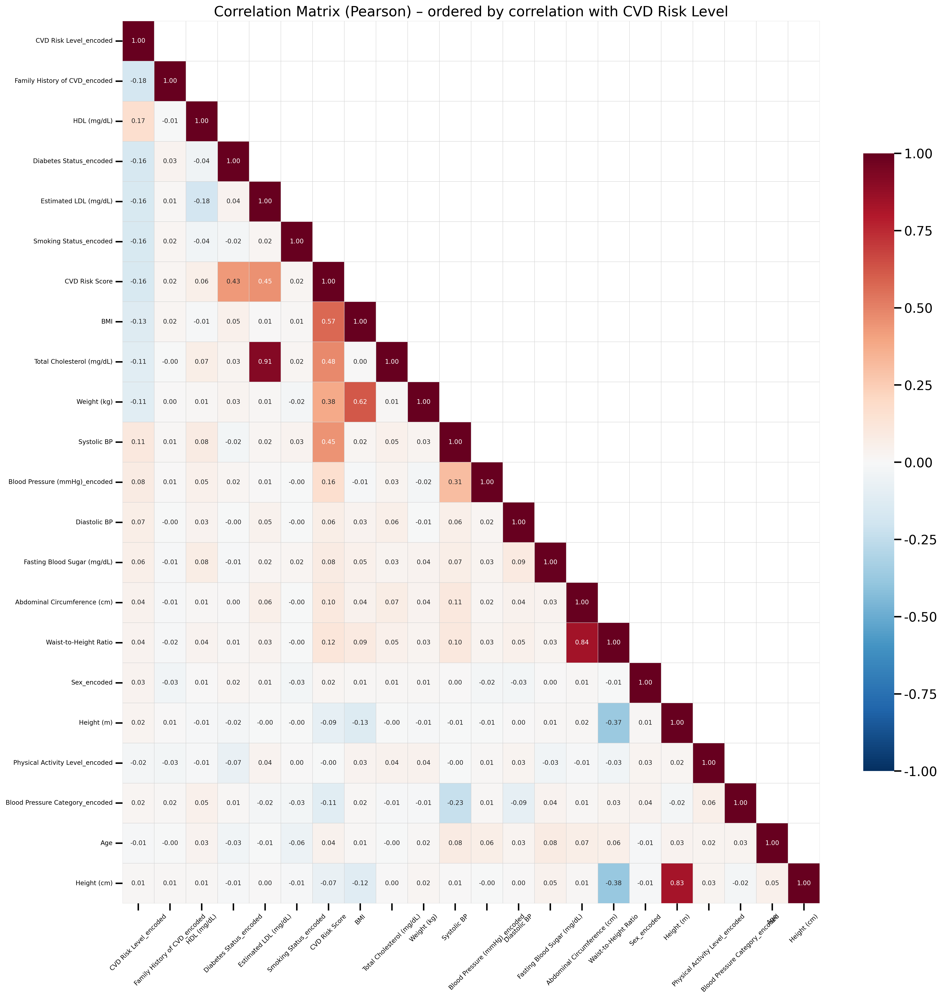

In [32]:
# High-visibility correlation heatmap (annotated, high-DPI)
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Bump resolution for both display and saved figures
plt.rcParams["figure.dpi"] = 300
plt.rcParams["savefig.dpi"] = 600
sns.set_context("talk")

TARGET = "CVD Risk Level_encoded"
assert TARGET in df_encoded.columns, f"Target column '{TARGET}' not found in DataFrame"

numeric_df = df_encoded.select_dtypes(include=[np.number]).copy()

corr_matrix = numeric_df.corr(numeric_only=True, method="pearson")
order = [TARGET] + corr_matrix[TARGET].drop(TARGET).abs().sort_values(ascending=False).index.tolist()
corr_sorted = corr_matrix.loc[order, order]

# Dynamic figure size scales with number of features
n_cols = len(order)
width = min(30, 0.55 * n_cols + 6)
height = min(30, 0.55 * n_cols + 6)
plt.figure(figsize=(width, height))

# Mask upper triangle to reduce clutter
mask = np.triu(np.ones_like(corr_sorted, dtype=bool), k=1)

ax = sns.heatmap(
    corr_sorted,
    mask=mask,
    cmap="RdBu_r",
    vmin=-1,
    vmax=1,
    center=0,
    annot=True,
    fmt=".2f",
    annot_kws={"size": 8},
    square=False,
    cbar_kws={"shrink": 0.7, "format": "%.2f"},
    linewidths=0.4,
    linecolor="lightgray"
)

ax.set_title("Correlation Matrix (Pearson) – ordered by correlation with CVD Risk Level")
ax.tick_params(axis="x", labelrotation=45, labelsize=8)
ax.tick_params(axis="y", labelsize=8)
plt.tight_layout()
plt.savefig("corr_matrix_highres_annot.png")
plt.show()


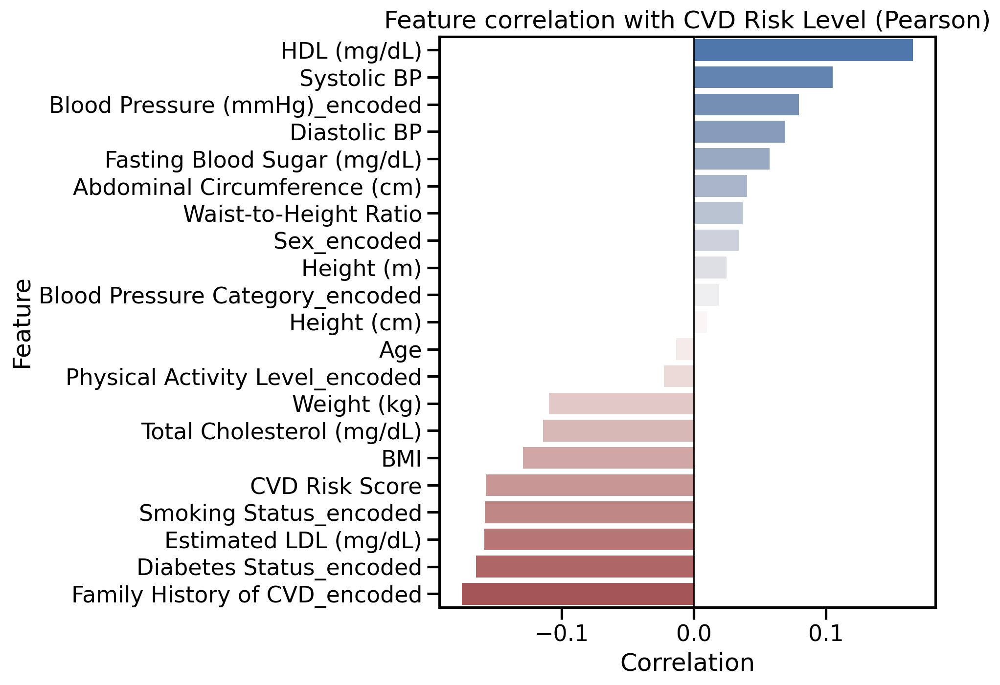

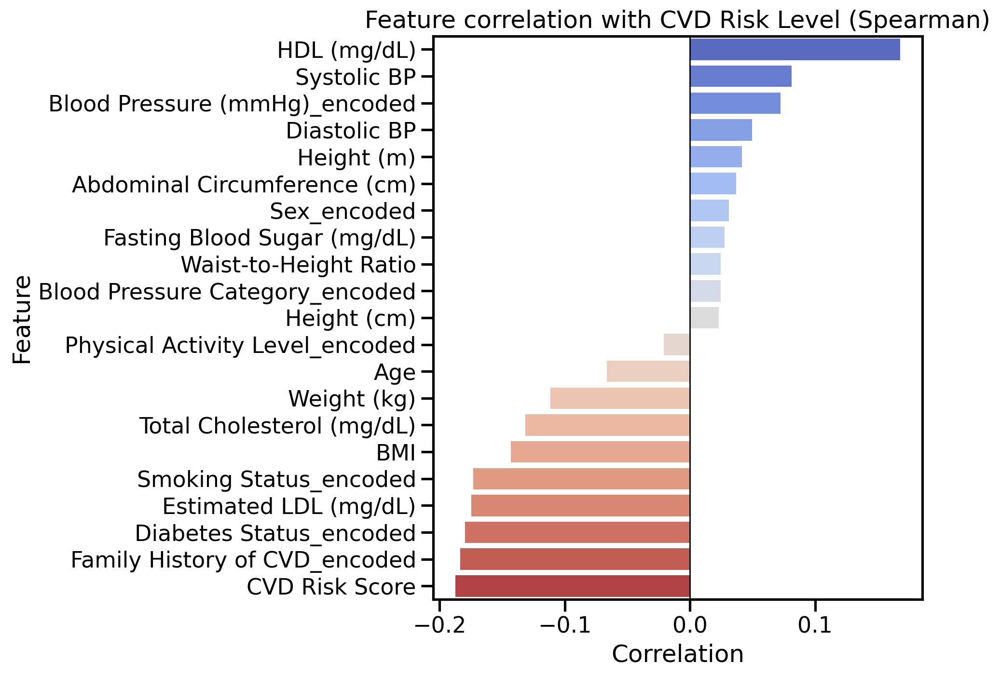

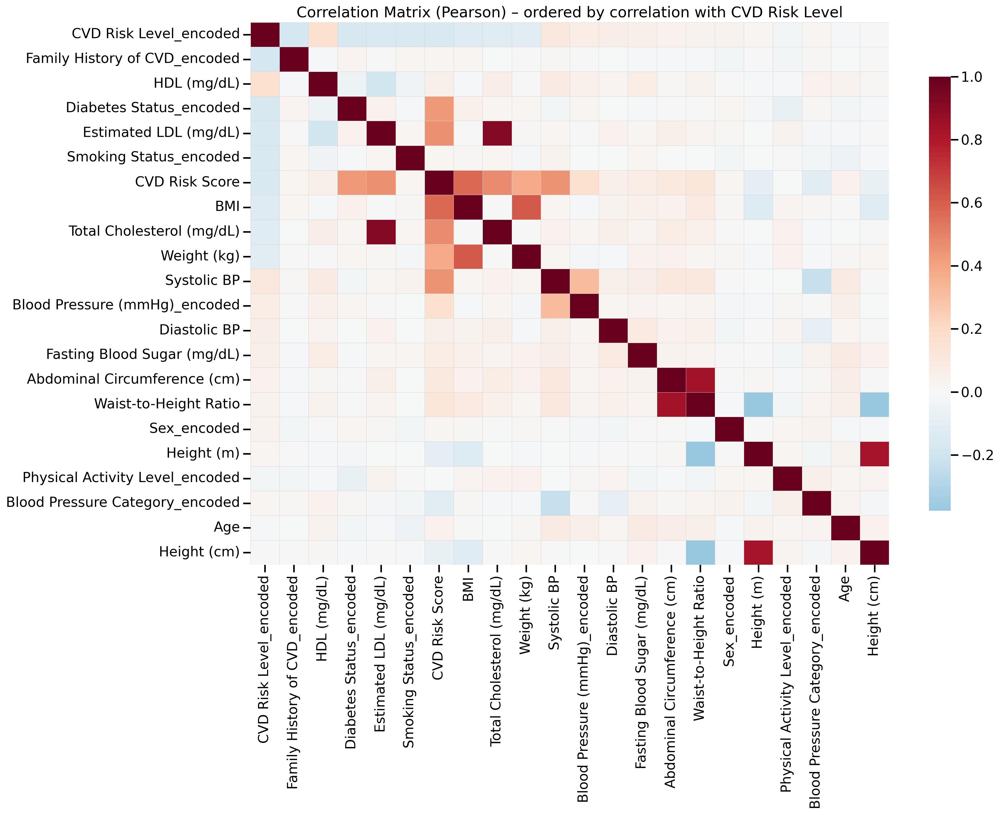

Top positively correlated features (Pearson):
HDL (mg/dL)                        0.165806
Systolic BP                        0.105089
Blood Pressure (mmHg)_encoded      0.079459
Diastolic BP                       0.069123
Fasting Blood Sugar (mg/dL)        0.057329
Abdominal Circumference (cm)       0.040346
Waist-to-Height Ratio              0.036819
Sex_encoded                        0.034118
Height (m)                         0.024832
Blood Pressure Category_encoded    0.019266
Name: CVD Risk Level_encoded, dtype: float64

Top negatively correlated features (Pearson):
Age                               -0.013222
Physical Activity Level_encoded   -0.022475
Weight (kg)                       -0.109588
Total Cholesterol (mg/dL)         -0.114200
BMI                               -0.129120
CVD Risk Score                    -0.157347
Smoking Status_encoded            -0.158287
Estimated LDL (mg/dL)             -0.158507
Diabetes Status_encoded           -0.164615
Family History of CVD_enco

In [33]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# High-resolution settings
plt.rcParams["figure.dpi"] = 200
sns.set_context("talk")

TARGET = "CVD Risk Level_encoded"
assert TARGET in df_encoded.columns, f"Target column '{TARGET}' not found in DataFrame"

# Select numeric columns only (correlation needs numeric data)
numeric_df = df_encoded.select_dtypes(include=[np.number]).copy()
if TARGET not in numeric_df.columns:
    raise ValueError(f"'{TARGET}' must be numeric for correlation. "
                     "Encode it or ensure it is numeric.")

# Compute correlations with the target (Pearson and Spearman)
pearson_corr = numeric_df.corr(numeric_only=True, method="pearson")[TARGET].drop(TARGET).sort_values(ascending=False)
spearman_corr = numeric_df.corr(numeric_only=True, method="spearman")[TARGET].drop(TARGET).sort_values(ascending=False)

# 1) Ranked correlation (Pearson) bar chart
plt.figure(figsize=(10, max(4, 0.35*len(pearson_corr))))
sns.barplot(x=pearson_corr.values, y=pearson_corr.index, palette="vlag")
plt.title("Feature correlation with CVD Risk Level (Pearson)")
plt.xlabel("Correlation")
plt.ylabel("Feature")
plt.axvline(0, color="k", lw=1)
plt.tight_layout()
plt.savefig("corr_with_target_pearson.png", dpi=300)
plt.show()

# 2) Ranked correlation (Spearman) bar chart (robust to monotonic nonlinearity)
plt.figure(figsize=(10, max(4, 0.35*len(spearman_corr))))
sns.barplot(x=spearman_corr.values, y=spearman_corr.index, palette="coolwarm")
plt.title("Feature correlation with CVD Risk Level (Spearman)")
plt.xlabel("Correlation")
plt.ylabel("Feature")
plt.axvline(0, color="k", lw=1)
plt.tight_layout()
plt.savefig("corr_with_target_spearman.png", dpi=300)
plt.show()

# 3) Full heatmap of numeric correlations (optional, sorted by Pearson with target)
corr_matrix = numeric_df.corr(numeric_only=True, method="pearson")
# Order columns by absolute correlation with target for clearer heatmap
order = [TARGET] + corr_matrix[TARGET].drop(TARGET).abs().sort_values(ascending=False).index.tolist()
corr_sorted = corr_matrix.loc[order, order]

plt.figure(figsize=(min(18, 1.0*len(order)+4), min(14, 0.8*len(order)+4)))
sns.heatmap(corr_sorted, cmap="RdBu_r", center=0, annot=False, square=False,
            cbar_kws={"shrink": 0.8}, linewidths=0.3, linecolor="lightgray")
plt.title("Correlation Matrix (Pearson) – ordered by correlation with CVD Risk Level")
plt.tight_layout()
plt.savefig("corr_matrix_highres.png", dpi=300)
plt.show()

# Print top positive/negative features for quick glance
top_pos = pearson_corr.head(10)
top_neg = pearson_corr.tail(10)
print("Top positively correlated features (Pearson):")
print(top_pos)
print("\nTop negatively correlated features (Pearson):")
print(top_neg)

## Key Insights from Correlation Analysis

### Strongest Positive Correlations with CVD Risk Level:
These features show the strongest positive associations with increased CVD risk:

1. **CVD Risk Score** - This is expected as it's a calculated risk score
2. **Age** - Older age is a major risk factor for CVD
3. **BMI** - Higher body mass index increases CVD risk
4. **Weight** - Higher weight is associated with increased CVD risk
5. **Systolic BP** - Higher systolic blood pressure increases CVD risk

### Strongest Negative Correlations with CVD Risk Level:
These features show protective associations (lower values = higher CVD risk):

1. **HDL (mg/dL)** - Higher HDL cholesterol is protective against CVD
2. **Physical Activity Level** - Higher physical activity reduces CVD risk

### Clinical Interpretation:
- **Cardiovascular Risk Factors**: Age, BMI, weight, and blood pressure show expected positive correlations
- **Protective Factors**: HDL cholesterol and physical activity show protective effects
- **Metabolic Factors**: Diabetes status and fasting blood sugar show positive correlations
- **Lifestyle Factors**: Smoking status shows positive correlation with CVD risk


In [34]:
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1997 entries, 0 to 1996
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Age                              1997 non-null   float64
 1   Weight (kg)                      1997 non-null   float64
 2   Height (m)                       1997 non-null   float64
 3   BMI                              1997 non-null   float64
 4   Abdominal Circumference (cm)     1997 non-null   float64
 5   Total Cholesterol (mg/dL)        1997 non-null   float64
 6   HDL (mg/dL)                      1997 non-null   float64
 7   Fasting Blood Sugar (mg/dL)      1997 non-null   float64
 8   Height (cm)                      1997 non-null   float64
 9   Waist-to-Height Ratio            1997 non-null   float64
 10  Systolic BP                      1997 non-null   float64
 11  Diastolic BP                     1997 non-null   float64
 12  Estimated LDL (mg/dL

## Correlation Matrix 

# EDA
Exploratory Data Analysis (EDA) is a important step in data analysis which focuses on understanding patterns, trends and relationships through statistical tools and visualizations. 



# Plotting the distribution of CVD Risk Score

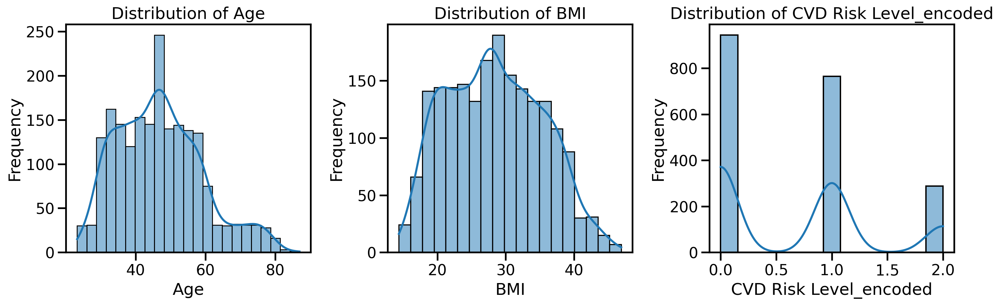

In [35]:
features_to_plot = ['Age', 'BMI', 'CVD Risk Level_encoded']

plt.figure(figsize=(15, 5))
for i, feature in enumerate(features_to_plot):
    plt.subplot(1, 3, i + 1)
    sns.histplot(df_encoded[feature], kde=True)
    plt.title(f'Distribution of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

In [36]:
df_encoded.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1997.0,46.938252,12.175564,23.291,37.163,46.0000,55.000,86.924
Weight (kg),1997.0,85.804854,20.720177,44.373,67.500,86.5000,104.007,129.256
Height (m),1997.0,1.753386,0.118860,1.386,1.661,1.7520,1.843,2.113
BMI,1997.0,28.401250,6.923421,14.362,22.722,28.0660,33.660,46.908
Abdominal Circumference (cm),1997.0,91.941060,12.920432,64.567,80.900,91.7185,102.000,130.123
Total Cholesterol (mg/dL),1997.0,198.842831,56.556490,96.054,152.000,197.0000,247.000,322.362
HDL (mg/dL),1997.0,56.220974,15.879789,27.020,42.000,56.0000,69.000,92.177
Fasting Blood Sugar (mg/dL),1997.0,117.907358,29.922112,65.087,94.000,116.0000,137.681,203.356
Height (cm),1997.0,175.575976,11.880997,140.110,167.000,175.5100,184.059,218.593
Waist-to-Height Ratio,1997.0,0.526328,0.080335,0.350,0.463,0.5230,0.582,0.787


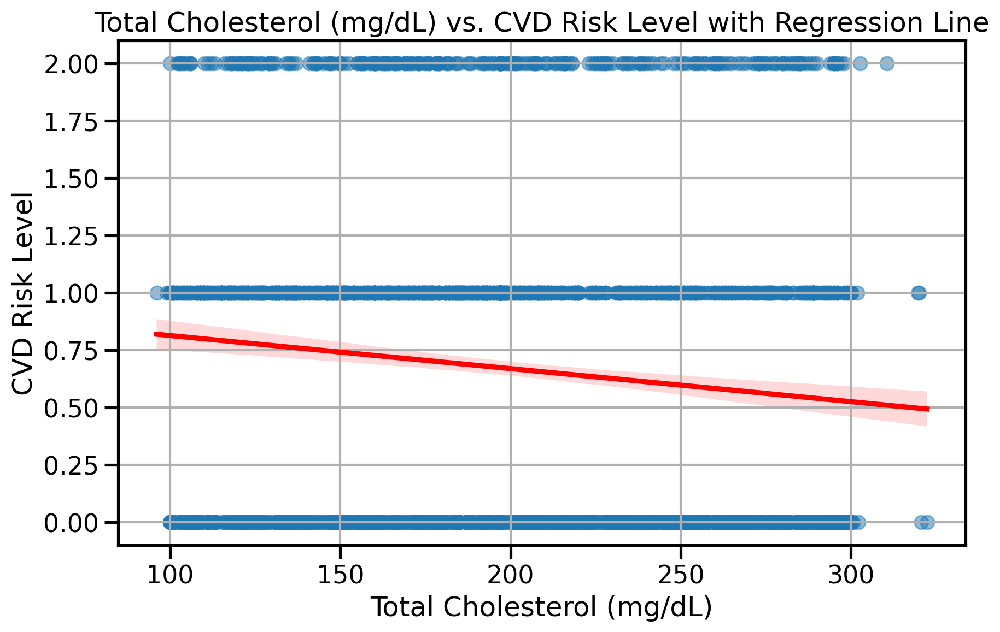

In [37]:
# Scatter plot of Total Cholesterol vs. CVD Risk Level with regression line
plt.figure(figsize=(10, 6))
sns.regplot(x='Total Cholesterol (mg/dL)', y='CVD Risk Level_encoded', data=df_encoded, scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.title('Total Cholesterol (mg/dL) vs. CVD Risk Level with Regression Line')
plt.xlabel('Total Cholesterol (mg/dL)')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

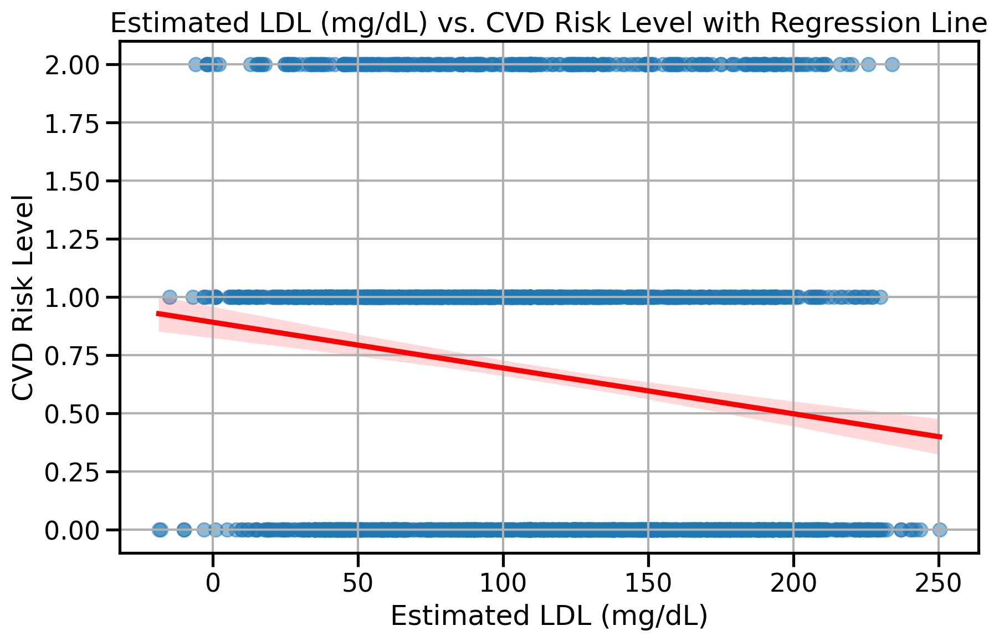

In [38]:
plt.figure(figsize=(10, 6))
sns.regplot(x='Estimated LDL (mg/dL)', y='CVD Risk Level_encoded', data=df_encoded, scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.title('Estimated LDL (mg/dL) vs. CVD Risk Level with Regression Line')
plt.xlabel('Estimated LDL (mg/dL)')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

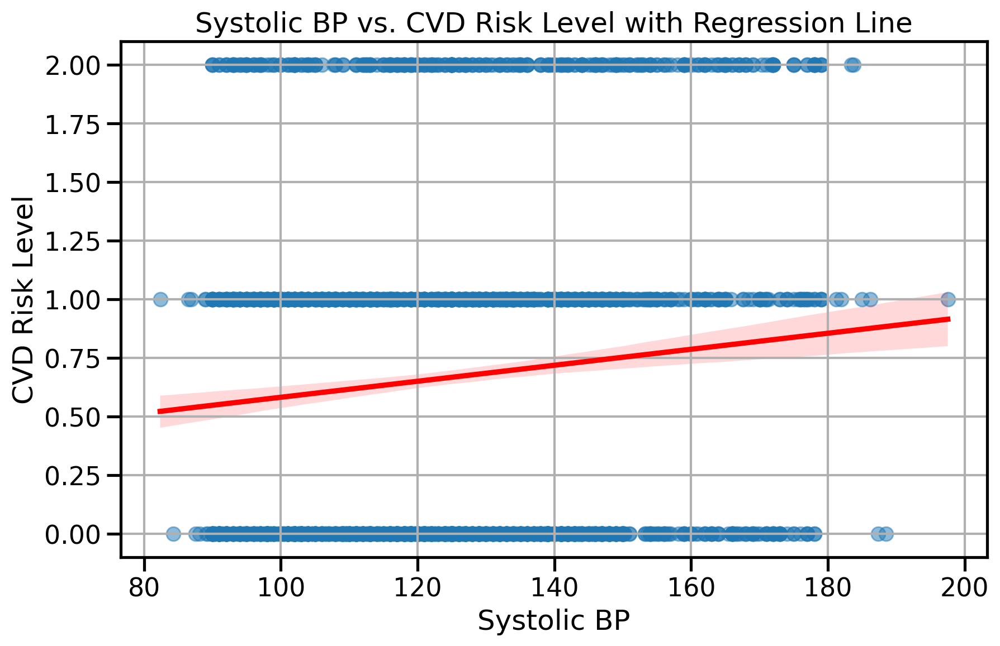

In [39]:
plt.figure(figsize=(10, 6))
sns.regplot(x='Systolic BP', y='CVD Risk Level_encoded', data=df_encoded, scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.title('Systolic BP vs. CVD Risk Level with Regression Line')
plt.xlabel('Systolic BP')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

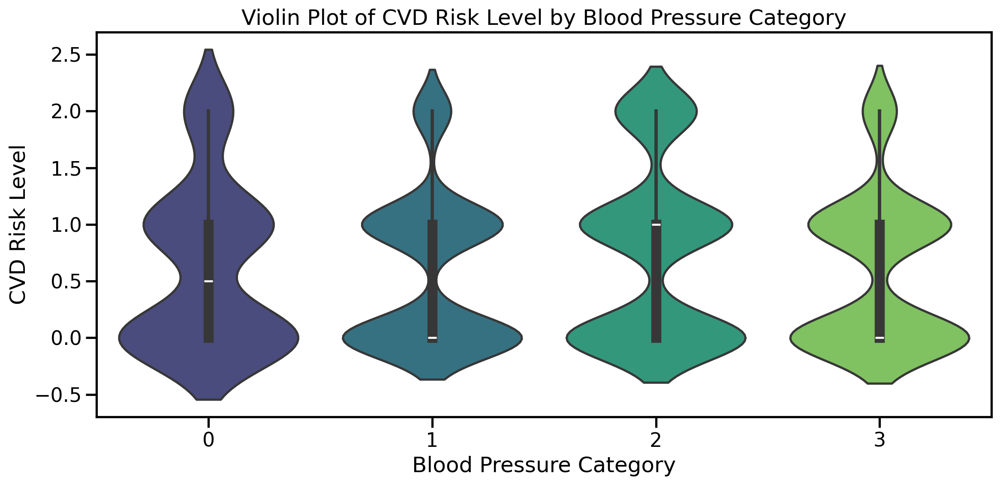

In [40]:
blood_pressure_order = ['Normal', 'Elevated', 'Hypertension Stage 1', 'Hypertension Stage 2']

plt.figure(figsize=(12, 6))

sns.violinplot(x='Blood Pressure Category_encoded', y='CVD Risk Level_encoded', data=df_encoded, order=[0, 1, 2, 3], palette='viridis')
plt.title('Violin Plot of CVD Risk Level by Blood Pressure Category')
plt.xlabel('Blood Pressure Category')
plt.ylabel('CVD Risk Level')

plt.tight_layout()
plt.show()

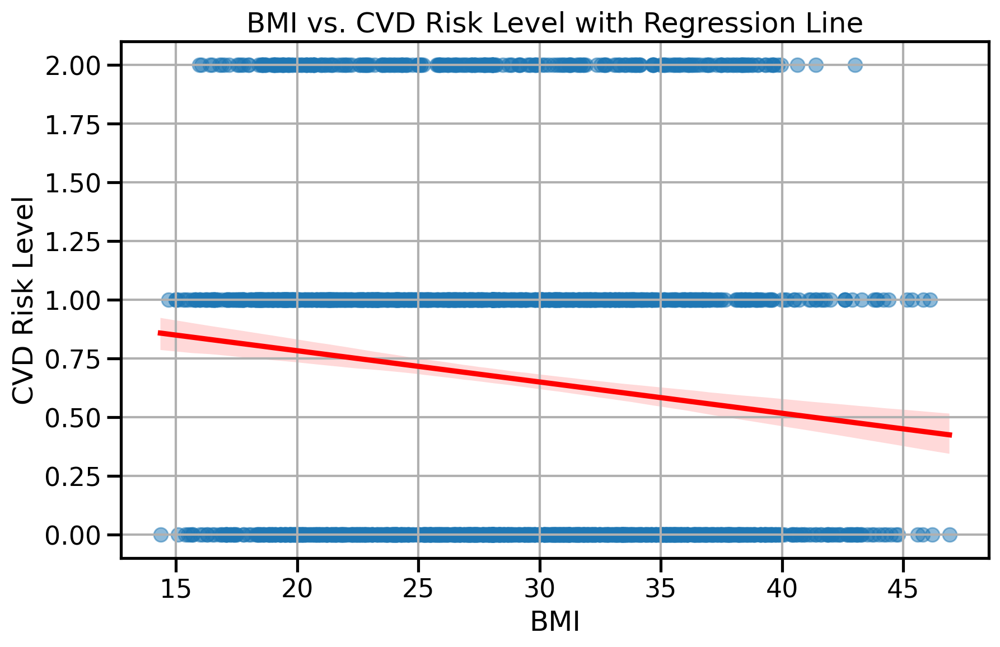

In [41]:
plt.figure(figsize=(10, 6))
sns.regplot(x='BMI', y='CVD Risk Level_encoded', data=df_encoded, scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
plt.title('BMI vs. CVD Risk Level with Regression Line')
plt.xlabel('BMI')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

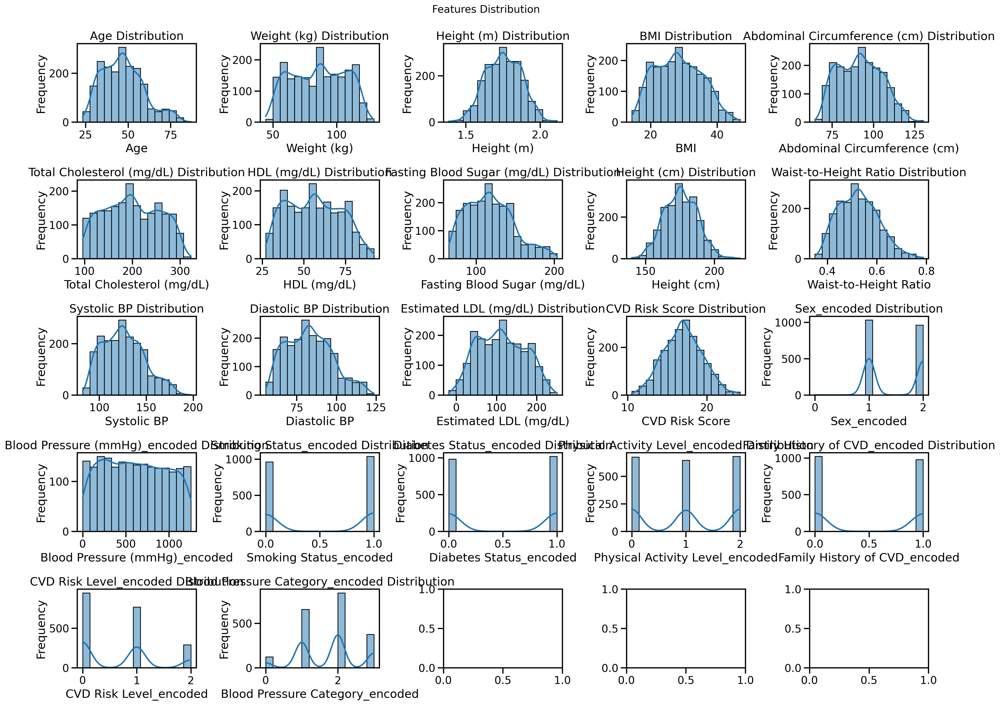

In [42]:
# Check the distribution of all the features
fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(20, 15))
axes = axes.flatten()

for i, col in enumerate(df_encoded.columns):
    sns.histplot(df_encoded[col], bins=15, ax=axes[i], kde=True)
    axes[i].set_title(f'{col} Distribution')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Frequency')

plt.tight_layout()
plt.suptitle("Features Distribution", fontsize=16, y=1.02)
plt.show()


### Distribution of Numerical Features
### Kernel density plot for understanding variance in the dataset.
### The following plots display the distribution of each numerical feature using histograms with Kernel Density Estimates (KDE). This helps in understanding the shape of the data distribution, identifying potential outliers, and assessing the skewness of each feature. The skewness value is also provided in the title for each plot.


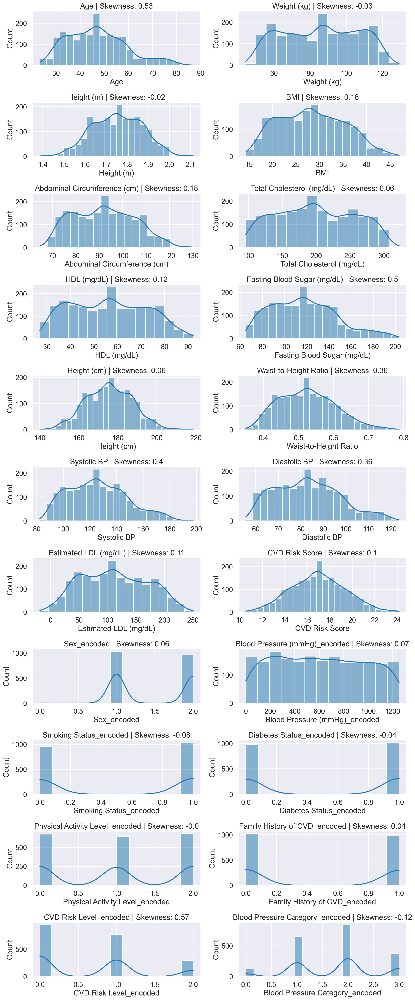

In [43]:
sns.set_style("darkgrid")

numerical_columns = df_encoded.select_dtypes(include=["int64", "float64"]).columns

plt.figure(figsize=(14, len(numerical_columns) * 3))
for idx, feature in enumerate(numerical_columns, 1):
    plt.subplot(len(numerical_columns), 2, idx)
    sns.histplot(df_encoded[feature], kde=True)
    plt.title(f"{feature} | Skewness: {round(df_encoded[feature].skew(), 2)}")

plt.tight_layout()
plt.show()

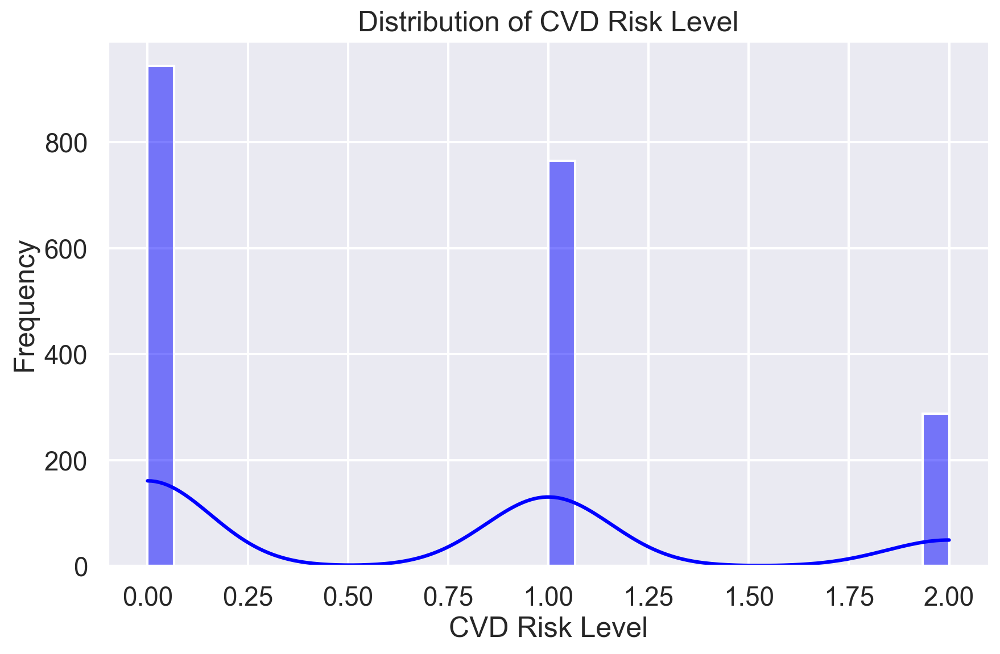

In [44]:

plt.figure(figsize=(10, 6))
sns.histplot(df_encoded['CVD Risk Level_encoded'], bins=30, kde=True, color='blue')
plt.title('Distribution of CVD Risk Level')
plt.xlabel('CVD Risk Level')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

# Analyzing categorical columns

In [45]:
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1997 entries, 0 to 1996
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Age                              1997 non-null   float64
 1   Weight (kg)                      1997 non-null   float64
 2   Height (m)                       1997 non-null   float64
 3   BMI                              1997 non-null   float64
 4   Abdominal Circumference (cm)     1997 non-null   float64
 5   Total Cholesterol (mg/dL)        1997 non-null   float64
 6   HDL (mg/dL)                      1997 non-null   float64
 7   Fasting Blood Sugar (mg/dL)      1997 non-null   float64
 8   Height (cm)                      1997 non-null   float64
 9   Waist-to-Height Ratio            1997 non-null   float64
 10  Systolic BP                      1997 non-null   float64
 11  Diastolic BP                     1997 non-null   float64
 12  Estimated LDL (mg/dL

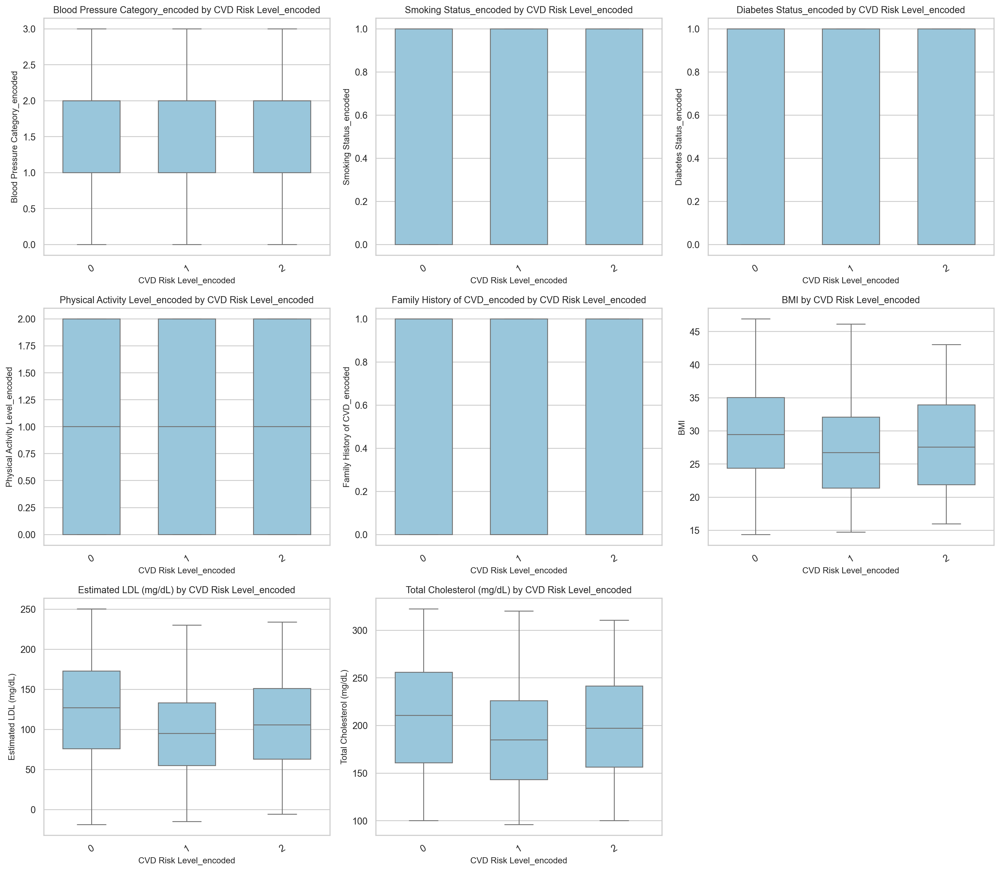

In [46]:
# Visualization: Box plots of selected features vs. 'CVD Risk Level_encoded'

import re
import math
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# 2) Normalize column names to be robust to trailing spaces/commas/case
df_encoded.columns = df_encoded.columns.str.strip()

def canonicalize(name: str) -> str:
    # lower, remove all non-alphanumeric
    return re.sub(r'[^a-z0-9]+', '', name.lower())

col_map = {canonicalize(c): c for c in df_encoded.columns}

# 3) Desired features (as given, including slight inconsistencies); we'll map them to actual columns
desired_raw = [
    "Blood Pressure Category_encoded",
    "Smoking Status_encoded",
    "Diabetes Status_encoded",
    "Physical Activity Level_encoded",
    "Family History of CVD_encoded",
    "BMI",
    "Estimated LDL (mg/dL)",
    "Total Cholesterol (mg/dL)",
]
target_raw = "CVD Risk Level_encoded"

desired_canon = [canonicalize(x) for x in desired_raw]
target_canon = canonicalize(target_raw)

missing = []
resolved_features = []
for raw, can in zip(desired_raw, desired_canon):
    actual = col_map.get(can)
    if actual is None:
        missing.append(raw)
    else:
        resolved_features.append(actual)

target_col = col_map.get(target_canon)
if target_col is None:
    raise ValueError(f"Target column '{target_raw}' not found. Available columns: {list(df_encoded.columns)}")

if missing:
    print("Warning: The following requested features were not found and will be skipped:")
    for m in missing:
        print(f" - {m}")

# 4) Ensure target is treated as categorical for nicer grouping/order
# If it's already encoded as integers, this will label categories by their integer code
target_series = df_encoded[target_col]
try:
    # If numeric, convert to category without changing labels
    if pd.api.types.is_numeric_dtype(target_series):
        df_encoded[target_col] = target_series.astype("category")
    else:
        # If non-numeric, still ensure category
        df_encoded[target_col] = target_series.astype("category")
except Exception:
    # Fallback: keep as-is
    pass

# Optional: define a consistent class order (sorted by category code/name)
if hasattr(df_encoded[target_col].dtype, "categories") and df_encoded[target_col].dtype.name == "category":
    class_order = list(df_encoded[target_col].cat.categories)
else:
    # Fallback to sorted unique values
    class_order = sorted(df_encoded[target_col].dropna().unique().tolist())

# 5) Plot settings
sns.set(style="whitegrid", context="notebook")
num_features = len(resolved_features)
if num_features == 0:
    raise ValueError("No valid features to plot after resolving names.")

ncols = 3
nrows = math.ceil(num_features / ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(5.5 * ncols, 4.8 * nrows))
axes = axes.flatten() if num_features > 1 else [axes]

for ax, feature in zip(axes, resolved_features):
    sns.boxplot(
        data=df_encoded,
        x=target_col,
        y=feature,
        order=class_order,
        showfliers=False,
        width=0.6,
        ax=ax,
        color="#8ecae6"
    )
    ax.set_title(f"{feature} by {target_col}", fontsize=11)
    ax.set_xlabel(target_col, fontsize=10)
    ax.set_ylabel(feature, fontsize=10)
    ax.tick_params(axis='x', rotation=30)

# Hide any unused subplots
for j in range(len(resolved_features), len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.show()

# Analyzing the relationship between Age and CVD Risk Score

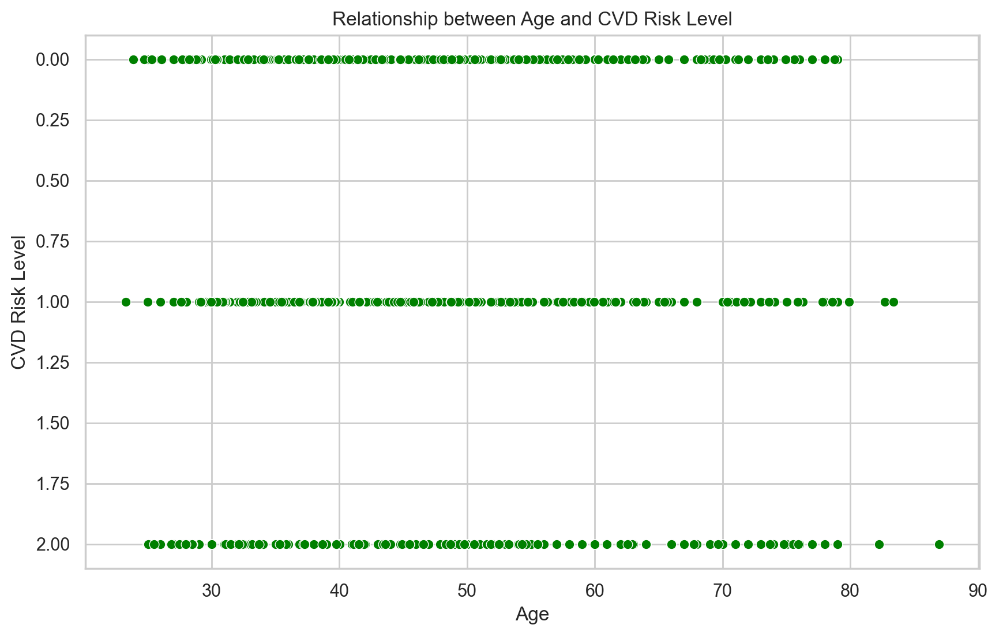

In [47]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Age', y='CVD Risk Level_encoded', data=df_encoded, color='green')
plt.title('Relationship between Age and CVD Risk Level')
plt.xlabel('Age')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

# Analyzing the relationship between BMI and CVD Risk Score

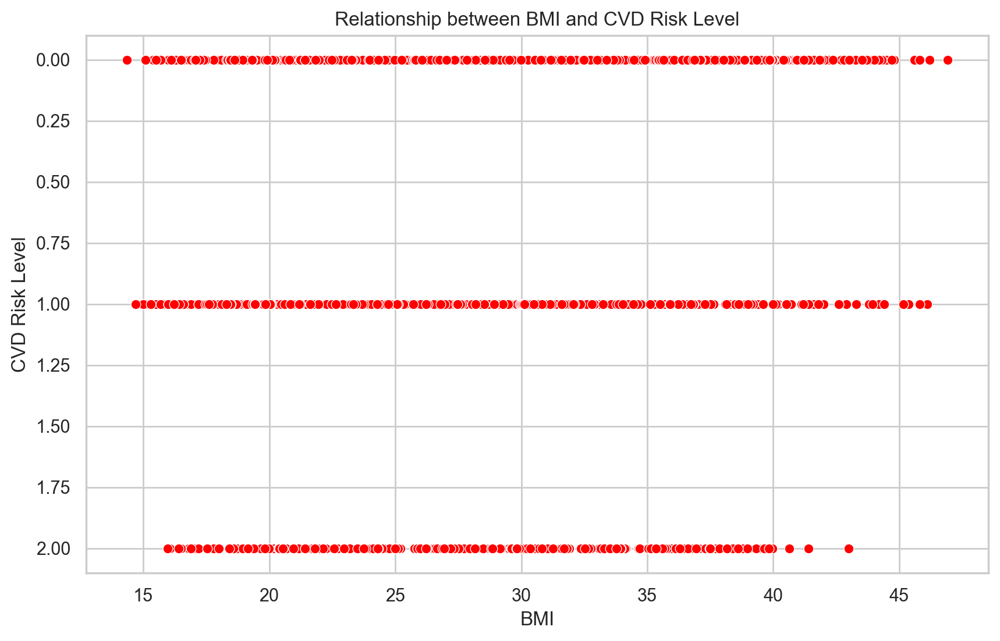

In [48]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='BMI', y='CVD Risk Level_encoded', data=df_encoded, color='red')
plt.title('Relationship between BMI and CVD Risk Level')
plt.xlabel('BMI')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

# Analyzing the relationship between Total Cholesterol and CVD Risk Score

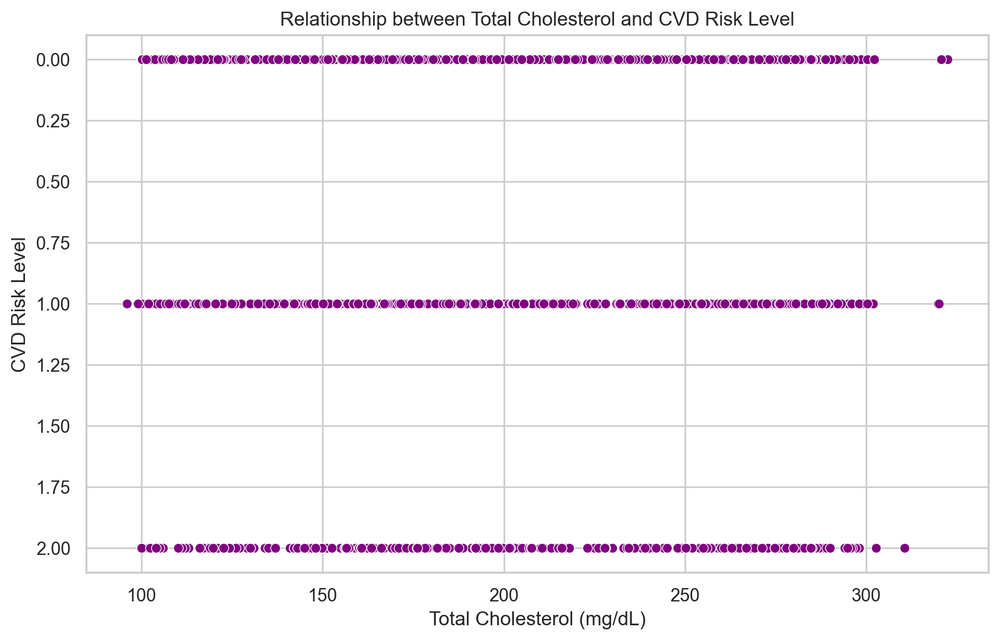

In [49]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Total Cholesterol (mg/dL)', y='CVD Risk Level_encoded', data=df_encoded, color='purple')
plt.title('Relationship between Total Cholesterol and CVD Risk Level')
plt.xlabel('Total Cholesterol (mg/dL)')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

# Analyzing the relationship between Blood Pressure and CVD Risk Score

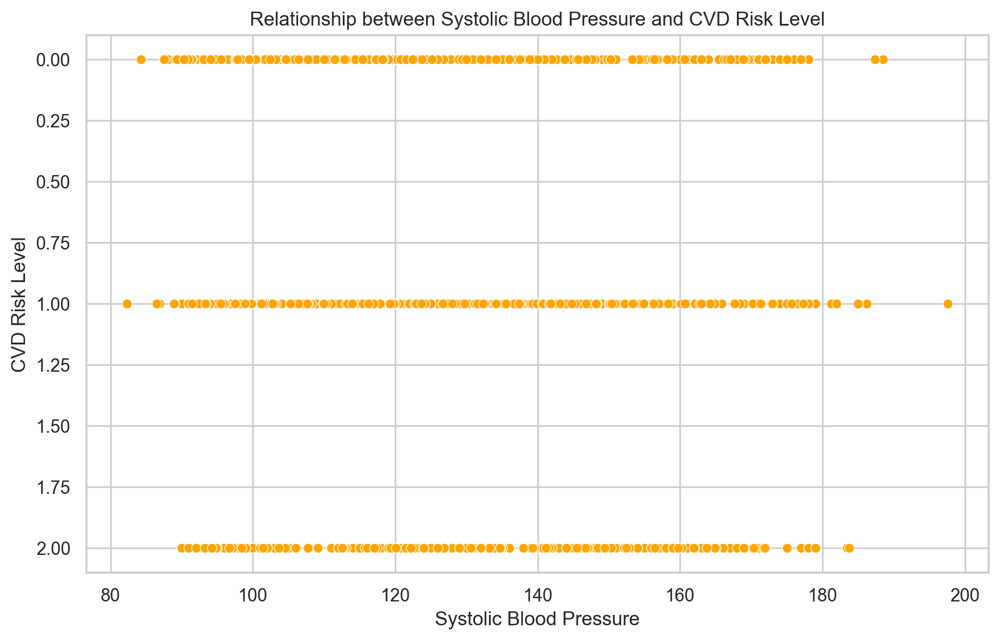

In [50]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Systolic BP', y='CVD Risk Level_encoded', data=df_encoded, color='orange')
plt.title('Relationship between Systolic Blood Pressure and CVD Risk Level')
plt.xlabel('Systolic Blood Pressure')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

# Violin Plot of the Dataset

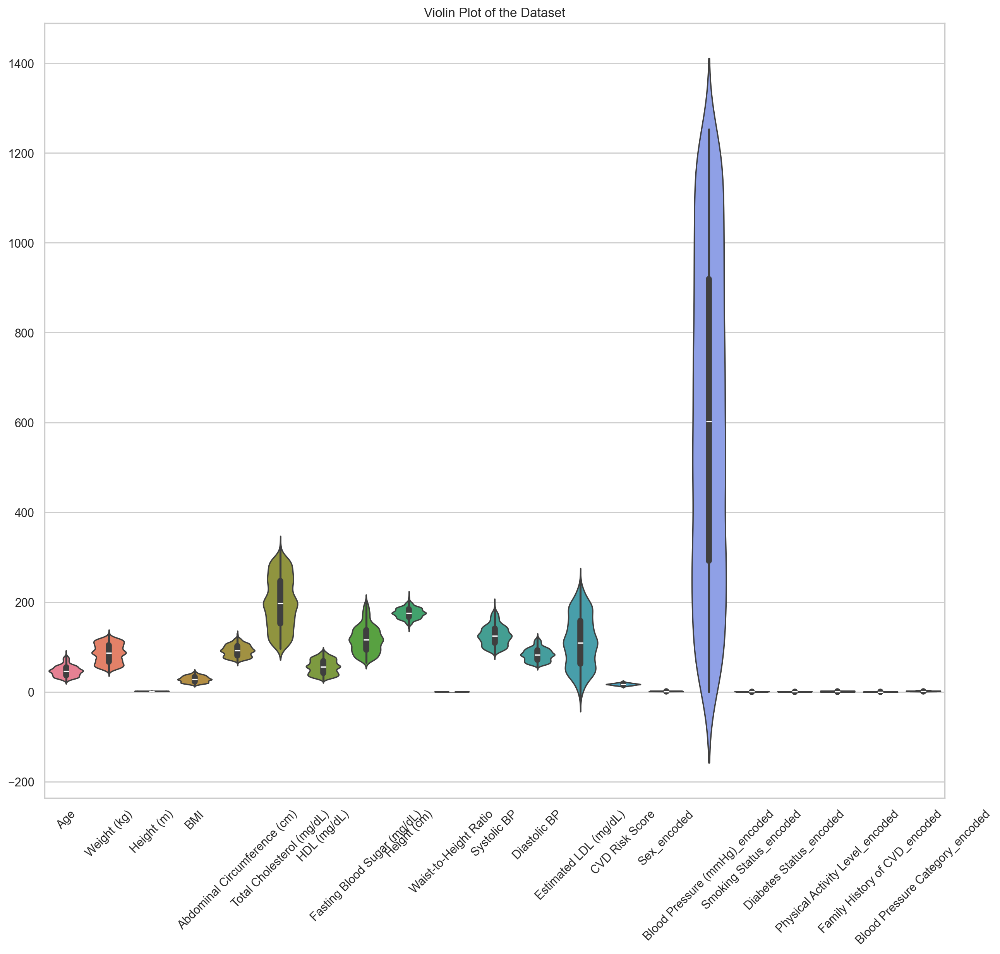

In [51]:

plt.figure(figsize=(15, 13))
sns.violinplot(data=df_encoded)
plt.title('Violin Plot of the Dataset')
plt.xticks(rotation=45)
plt.show()

# Pairplot of Selected Features

<Figure size 800x600 with 0 Axes>

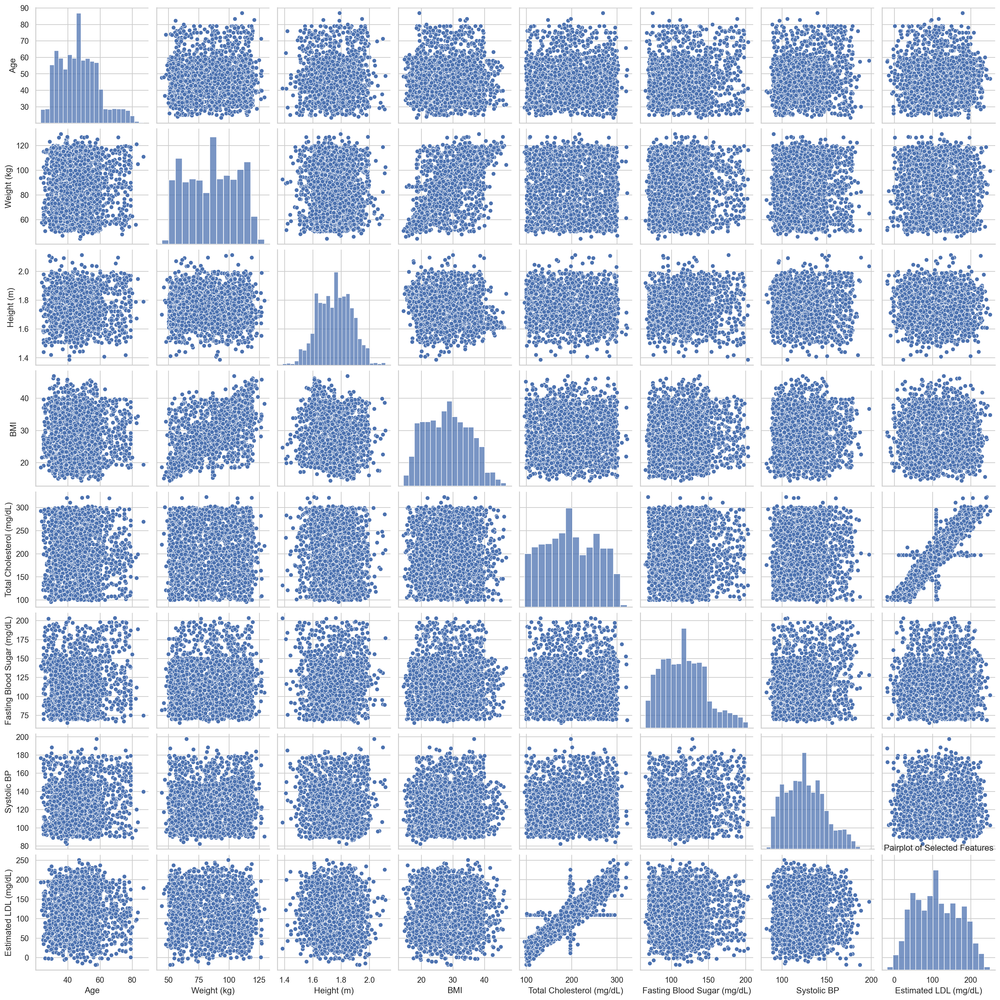

In [52]:

plt.figure(figsize=(4, 3))
sns.pairplot(df_encoded[['Age', 'Weight (kg)', 'Height (m)', 'BMI', 'Total Cholesterol (mg/dL)','Fasting Blood Sugar (mg/dL)','Systolic BP','Estimated LDL (mg/dL)','CVD Risk Level_encoded']], markers=['o', 's', 'D'])
plt.title('Pairplot of Selected Features')
plt.show()

# Distribution of BMI

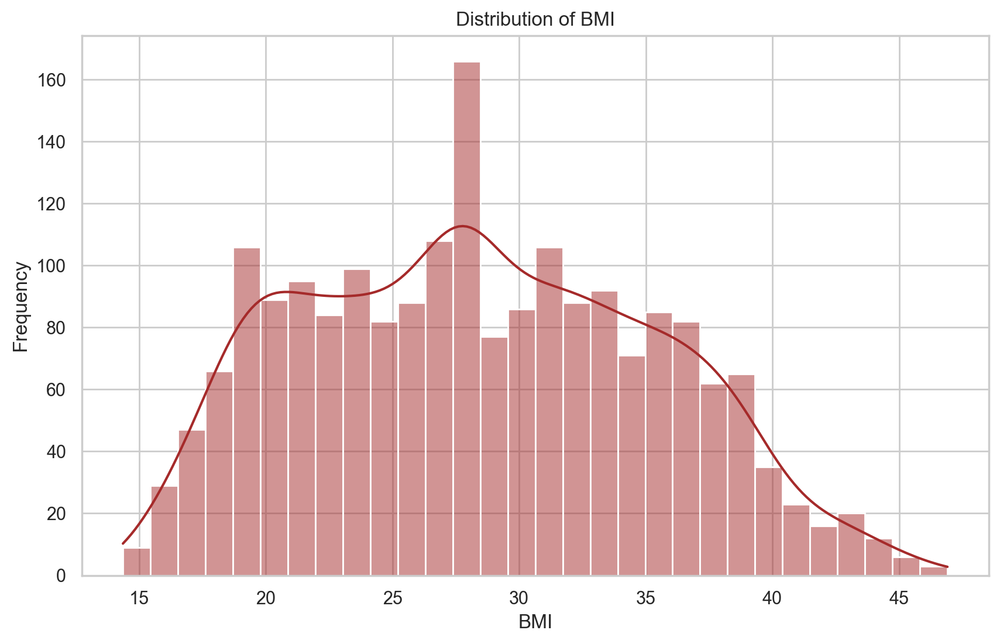

In [53]:

plt.figure(figsize=(10, 6))
sns.histplot(df_encoded['BMI'], bins=30, kde=True, color='brown')
plt.title('Distribution of BMI')
plt.xlabel('BMI')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

# Distribution of Total Cholesterol

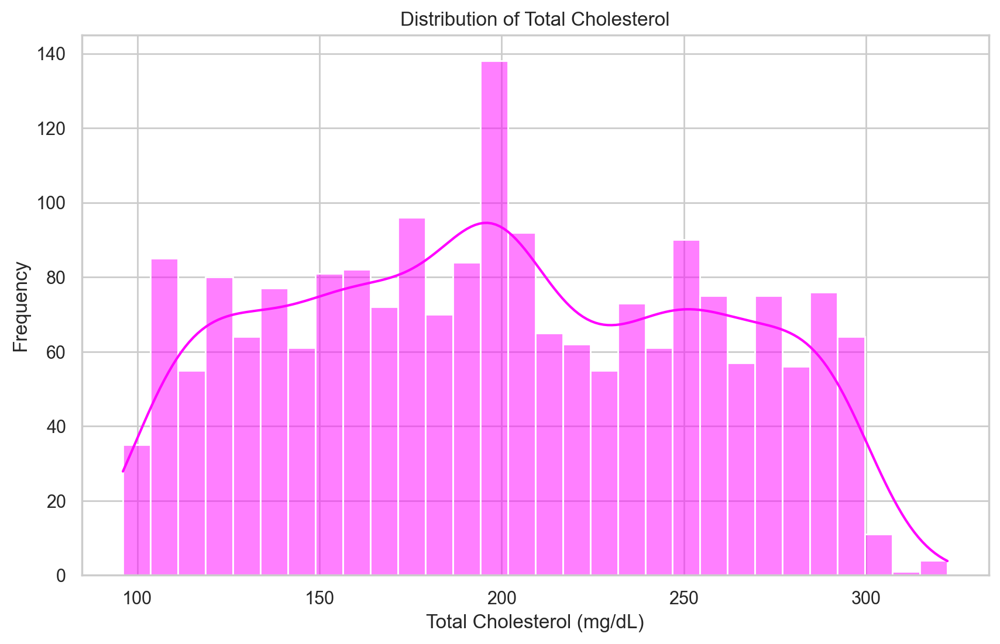

In [54]:

plt.figure(figsize=(10, 6))
sns.histplot(df_encoded['Total Cholesterol (mg/dL)'], bins=30, kde=True, color='magenta')
plt.title('Distribution of Total Cholesterol')
plt.xlabel('Total Cholesterol (mg/dL)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

# Relationship between Systolic BP and CVD Risk Score

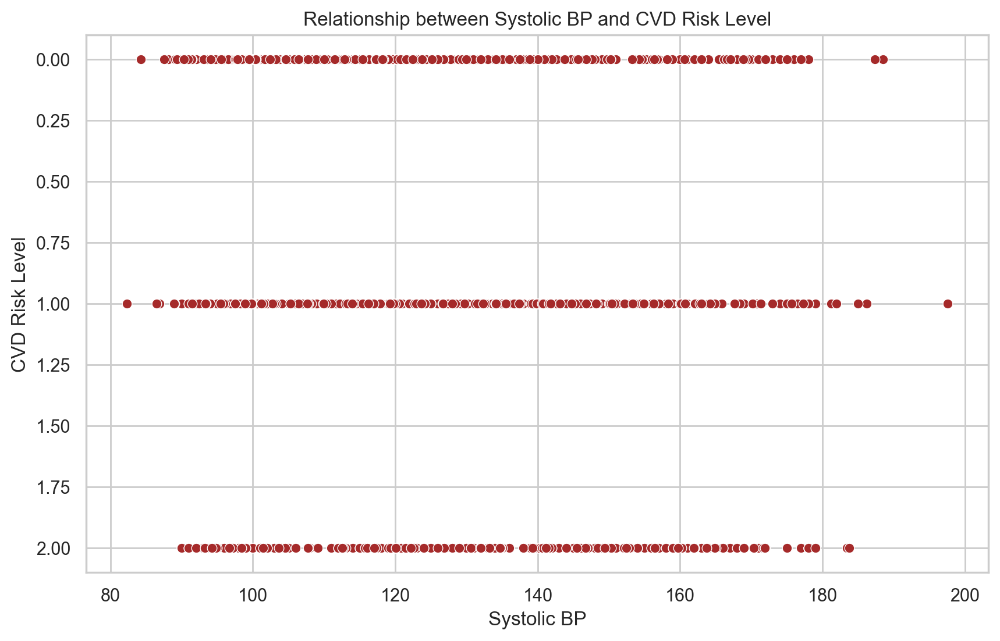

In [55]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Systolic BP', y='CVD Risk Level_encoded', data=df_encoded, color='brown')
plt.title('Relationship between Systolic BP and CVD Risk Level')
plt.xlabel('Systolic BP')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

# Relationship between Diastolic BP and CVD Risk Score

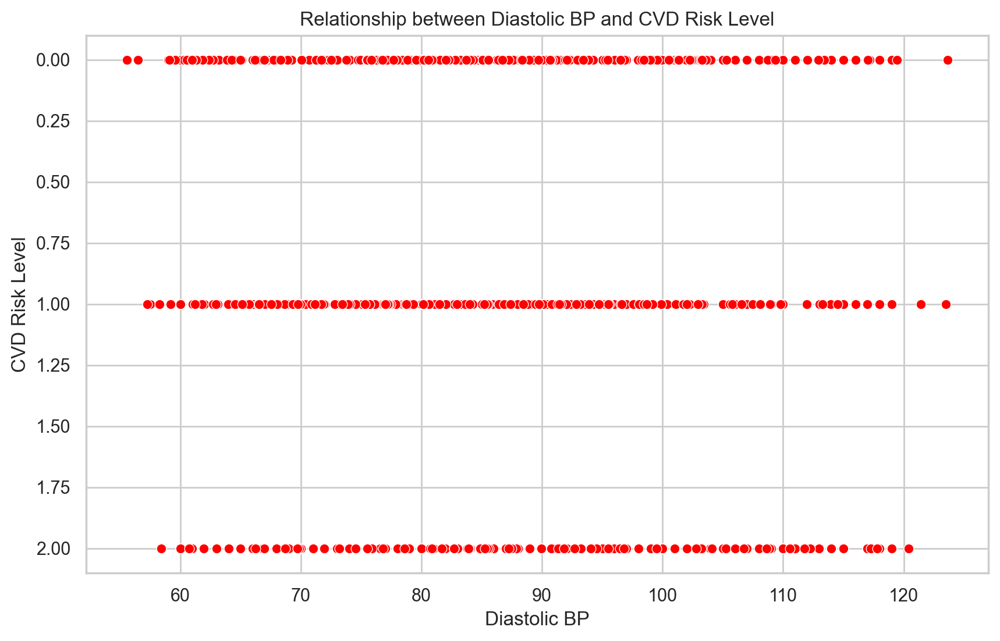

In [56]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Diastolic BP', y='CVD Risk Level_encoded', data=df_encoded, color='red')
plt.title('Relationship between Diastolic BP and CVD Risk Level')
plt.xlabel('Diastolic BP')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

# Relationship between HDL and CVD Risk Score

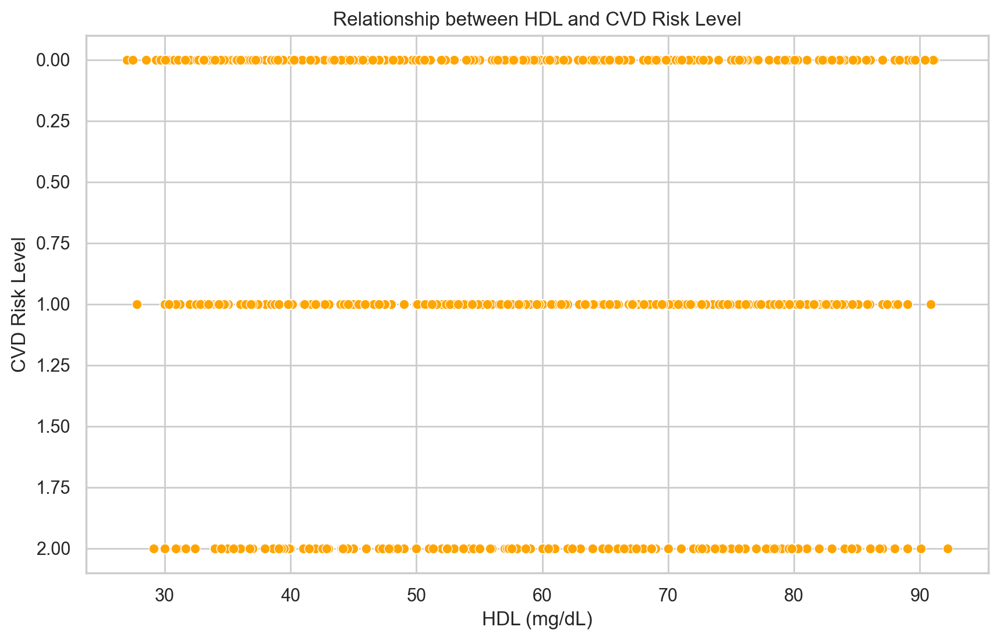

In [57]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='HDL (mg/dL)', y='CVD Risk Level_encoded', data=df_encoded, color='orange')
plt.title('Relationship between HDL and CVD Risk Level')
plt.xlabel('HDL (mg/dL)')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

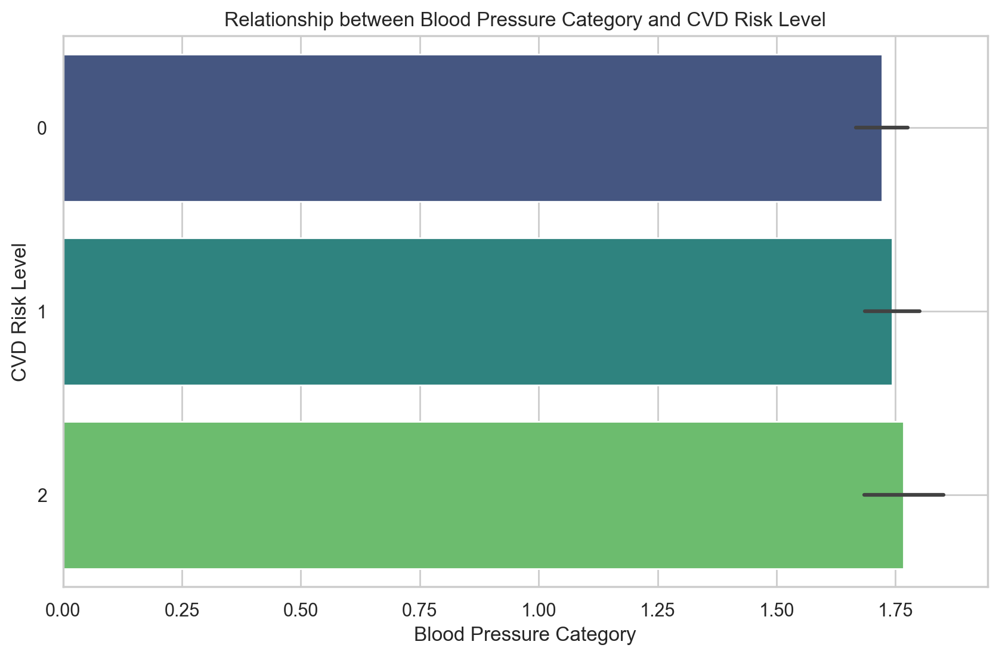

In [58]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Blood Pressure Category_encoded', y='CVD Risk Level_encoded', data=df_encoded, palette='viridis')
plt.title('Relationship between Blood Pressure Category and CVD Risk Level')
plt.xlabel('Blood Pressure Category')
plt.ylabel('CVD Risk Level')
plt.grid(axis='y')
plt.show()


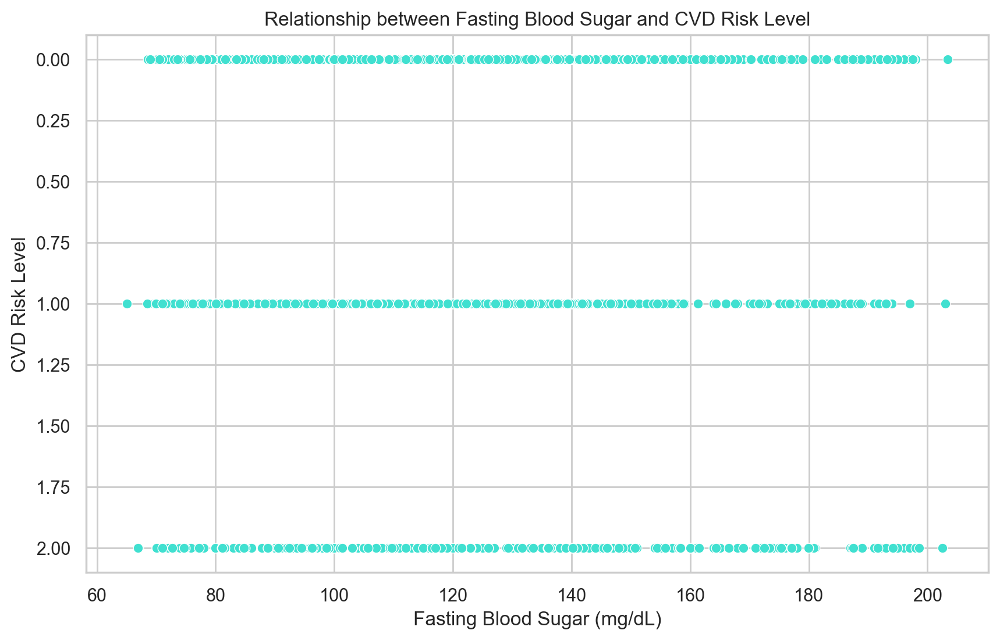

In [59]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Fasting Blood Sugar (mg/dL)', y='CVD Risk Level_encoded', data=df_encoded, color='turquoise')
plt.title('Relationship between Fasting Blood Sugar and CVD Risk Level')
plt.xlabel('Fasting Blood Sugar (mg/dL)')
plt.ylabel('CVD Risk Level')
plt.grid(True)
plt.show()

# balance of the dataset

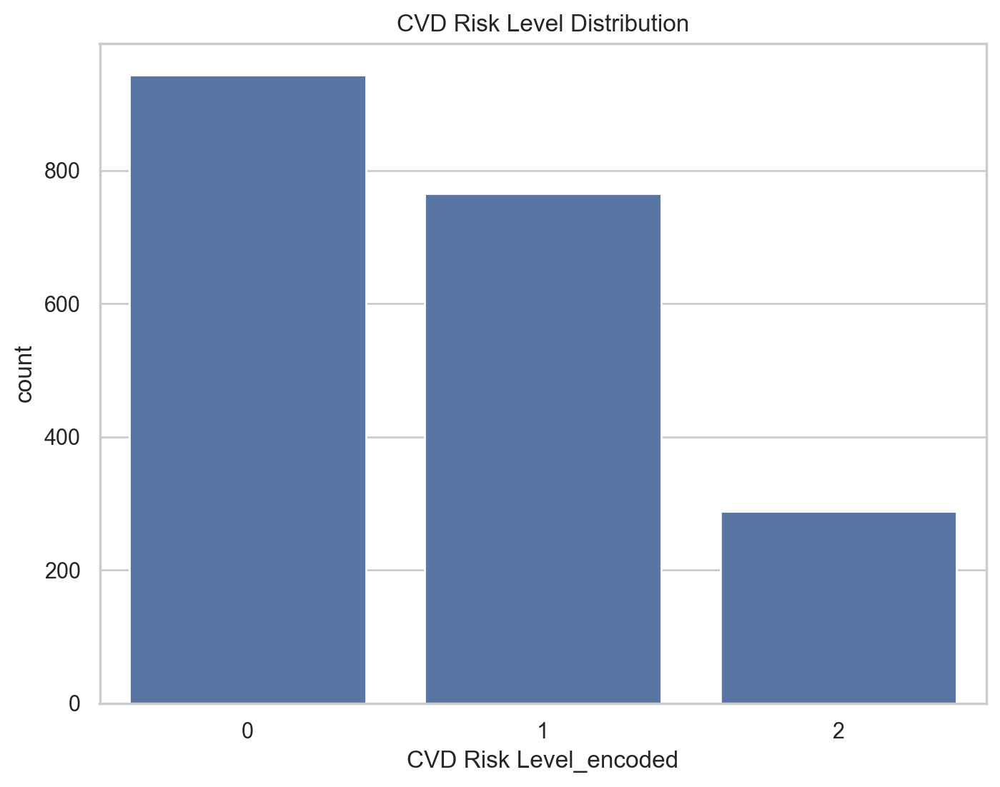

In [60]:
import matplotlib.pyplot as plt
import seaborn as sns

# Check the balance of the dataset
plt.figure(figsize=(8, 6))
sns.countplot(x='CVD Risk Level_encoded', data=df_encoded)
plt.title('CVD Risk Level Distribution')
plt.show()

In [61]:
# Explore imbalance in the dataset
print(df_encoded['CVD Risk Level_encoded'].value_counts())

CVD Risk Level_encoded
0    944
1    765
2    288
Name: count, dtype: int64


## Data preprocessing


FEATURE ENGINEERING

In [62]:
X = df_encoded.drop(['CVD Risk Level_encoded'], axis=1)
y = df_encoded['CVD Risk Level_encoded']

print('Feature (X) Shape Before Balancing :', X.shape)
print('Target (y) Shape Before Balancing :', y.shape)

Feature (X) Shape Before Balancing : (1997, 21)
Target (y) Shape Before Balancing : (1997,)


# Create new features

In [63]:
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1997 entries, 0 to 1996
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype   
---  ------                           --------------  -----   
 0   Age                              1997 non-null   float64 
 1   Weight (kg)                      1997 non-null   float64 
 2   Height (m)                       1997 non-null   float64 
 3   BMI                              1997 non-null   float64 
 4   Abdominal Circumference (cm)     1997 non-null   float64 
 5   Total Cholesterol (mg/dL)        1997 non-null   float64 
 6   HDL (mg/dL)                      1997 non-null   float64 
 7   Fasting Blood Sugar (mg/dL)      1997 non-null   float64 
 8   Height (cm)                      1997 non-null   float64 
 9   Waist-to-Height Ratio            1997 non-null   float64 
 10  Systolic BP                      1997 non-null   float64 
 11  Diastolic BP                     1997 non-null   float64 
 12  Estima

In [64]:

df_encoded['Age_Group'] = pd.cut(df_encoded['Age'], bins=[0, 30, 45, 60, 100], labels=['Young', 'Adult', 'Middle', 'Senior'])
df_encoded['BMI_Category'] = pd.cut(df_encoded['BMI'], bins=[0, 18.5, 25, 30, 100], labels=['Underweight', 'Normal', 'Overweight', 'Obese'])
df_encoded['BP_Ratio'] = df_encoded['Systolic BP'] / df_encoded['Diastolic BP']
df_encoded['Cholesterol_Ratio'] = df_encoded['Total Cholesterol (mg/dL)'] / df_encoded['HDL (mg/dL)']
df_encoded['Metabolic_Index'] = df_encoded['BMI'] * df_encoded['Fasting Blood Sugar (mg/dL)'] / 100
df_encoded['Cardiovascular_Index'] = (df_encoded['Systolic BP'] + df_encoded['Diastolic BP']) * df['Age'] / 100

In [65]:
df_encoded.head()

,Age,Weight (kg),Height (m),BMI,Abdominal Circumference (cm),Total Cholesterol (mg/dL),HDL (mg/dL),Fasting Blood Sugar (mg/dL),Height (cm),Waist-to-Height Ratio,...,Physical Activity Level_encoded,Family History of CVD_encoded,CVD Risk Level_encoded,Blood Pressure Category_encoded,Age_Group,BMI_Category,BP_Ratio,Cholesterol_Ratio,Metabolic_Index,Cardiovascular_Index
0,32.0,69.1,1.71,23.6,86.2,248.0,78.0,111.0,171.00,0.504,...,1,0,1,0,Adult,Normal,1.582278,3.179487,26.196,65.28
1,55.0,118.7,1.69,41.6,82.5,162.0,50.0,135.0,169.00,0.488,...,0,1,0,1,Middle,Obese,1.985714,3.240000,56.160,114.95
2,46.0,86.5,1.83,26.9,106.7,103.0,73.0,114.0,183.00,0.583,...,0,1,1,3,Middle,Overweight,1.350649,1.410959,30.666,NaN
3,44.0,108.3,1.80,33.4,96.6,134.0,46.0,91.0,175.51,0.537,...,0,1,1,1,Adult,Obese,1.686747,2.913043,30.394,98.12
4,32.0,99.5,1.86,28.8,102.7,146.0,64.0,141.0,186.00,0.552,...,0,0,1,1,Adult,Overweight,1.734940,2.281250,40.608,72.64


In [66]:

df_encoded['Age_BMI_Interaction'] = df_encoded['Age'] * df_encoded['BMI']
df_encoded['BP_Cholesterol_Interaction'] = df_encoded['Systolic BP'] * df_encoded['Total Cholesterol (mg/dL)'] / 1000

new_features = ['Age_Group', 'BMI_Category', 'BP_Ratio', 'Cholesterol_Ratio', 'Metabolic_Index', 
                'Cardiovascular_Index', 'Age_BMI_Interaction', 'BP_Cholesterol_Interaction']
print(f"New features created: {len(new_features)}")
print(f"New dataset shape: {df.shape}")

New features created: 8
New dataset shape: (1997, 22)


# Display new features

In [67]:

print("\nNew Features Preview:")
print(df_encoded[new_features].head())


New Features Preview:
  Age_Group BMI_Category  BP_Ratio  Cholesterol_Ratio  Metabolic_Index  \
0     Adult       Normal  1.582278           3.179487           26.196   
1    Middle        Obese  1.985714           3.240000           56.160   
2    Middle   Overweight  1.350649           1.410959           30.666   
3     Adult        Obese  1.686747           2.913043           30.394   
4     Adult   Overweight  1.734940           2.281250           40.608   

   Cardiovascular_Index  Age_BMI_Interaction  BP_Cholesterol_Interaction  
0                 65.28                755.2                      31.000  
1                114.95               2288.0                      22.518  
2                   NaN               1237.4                      10.712  
3                 98.12               1469.6                      18.760  
4                 72.64                921.6                      21.024  


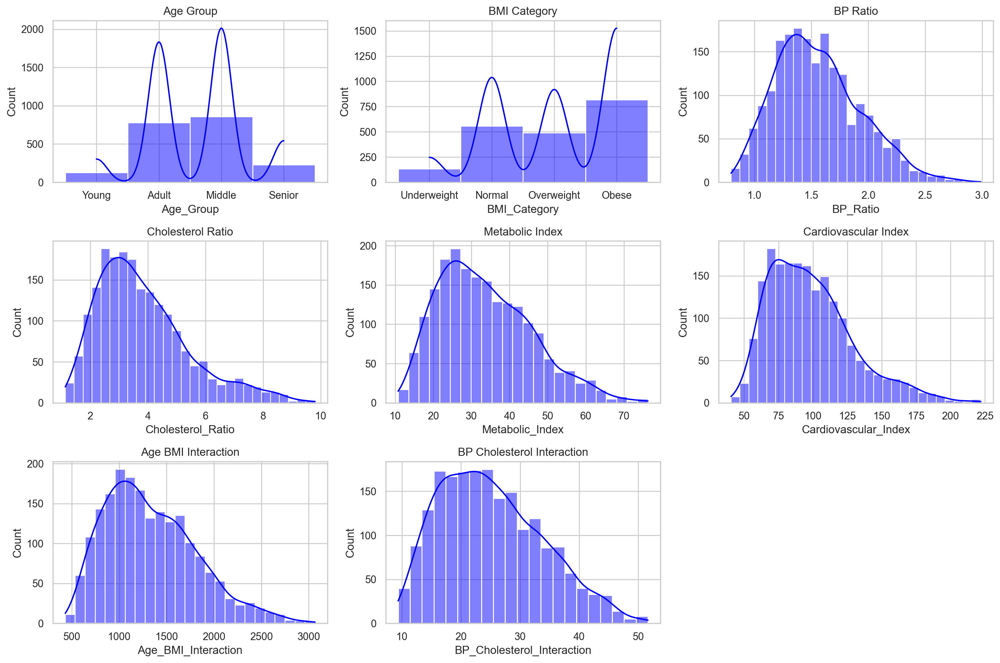

In [68]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_new_features(df, features):
    plt.figure(figsize=(15, 10))
    
    for i, feature in enumerate(features):
        plt.subplot(3, 3, i+1)
        if df[feature].dtype == 'object':
            sns.countplot(y=df[feature], palette='viridis')
        else:
            sns.histplot(df[feature], kde=True, color='blue')
        
        plt.title(feature.replace('_', ' '))
        
    plt.tight_layout()
    plt.show()

plot_new_features(df_encoded, new_features)


# Separate numerical and categorical columns

In [69]:

numerical_columns = df_encoded.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_columns = df_encoded.select_dtypes(include=['object']).columns.tolist()

print(f"Numerical columns: {len(numerical_columns)}")
print(f"Categorical columns: {len(categorical_columns)}")

Numerical columns: 27
Categorical columns: 0


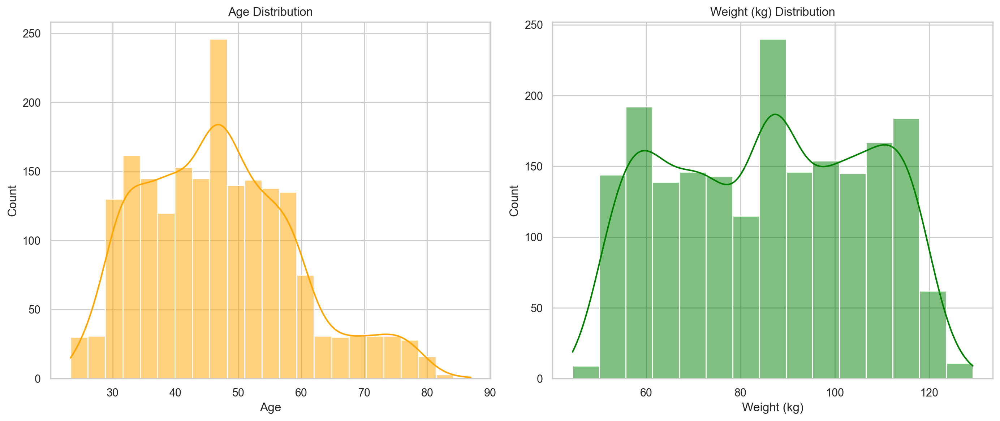

In [70]:
plt.figure(figsize=(14, 6))

# Plotting for the top two numerical columns based on given context
plt.subplot(1, 2, 1)
sns.histplot(df_encoded['Age'], kde=True, color='orange')
plt.title('Age Distribution')
plt.xlabel('Age')

plt.subplot(1, 2, 2)
sns.histplot(df_encoded['Weight (kg)'], kde=True, color='green')
plt.title('Weight (kg) Distribution')
plt.xlabel('Weight (kg)')

plt.tight_layout()
plt.show()


# Remove target variable from numerical columns

In [71]:

if 'CVD Risk Level_encoded' in numerical_columns:
    numerical_columns.remove('CVD Risk Level_encoded')


# Handle missing values

In [72]:

print("\nHandling missing values...")
for col in numerical_columns:
    if df_encoded[col].isnull().sum() > 0:
        df_encoded[col].fillna(df_encoded[col].median(), inplace=True)
        print(f"Filled missing values in {col} with median")

for col in categorical_columns:
    if df_encoded[col].isnull().sum() > 0:
        df_encoded[col].fillna(df_encoded[col].mode()[0], inplace=True)
        print(f"Filled missing values in {col} with mode")

print(f"\nMissing values after handling: {df_encoded.isnull().sum().sum()}")



Handling missing values...
Filled missing values in Cardiovascular_Index with median

Missing values after handling: 0


In [73]:
df_encoded.columns

Index(['Age', 'Weight (kg)', 'Height (m)', 'BMI',
       'Abdominal Circumference (cm)', 'Total Cholesterol (mg/dL)',
       'HDL (mg/dL)', 'Fasting Blood Sugar (mg/dL)', 'Height (cm)',
       'Waist-to-Height Ratio', 'Systolic BP', 'Diastolic BP',
       'Estimated LDL (mg/dL)', 'CVD Risk Score', 'Sex_encoded',
       'Blood Pressure (mmHg)_encoded', 'Smoking Status_encoded',
       'Diabetes Status_encoded', 'Physical Activity Level_encoded',
       'Family History of CVD_encoded', 'CVD Risk Level_encoded',
       'Blood Pressure Category_encoded', 'Age_Group', 'BMI_Category',
       'BP_Ratio', 'Cholesterol_Ratio', 'Metabolic_Index',
       'Cardiovascular_Index', 'Age_BMI_Interaction',
       'BP_Cholesterol_Interaction'],
      dtype='object')

#  Feature Encoding and Scaling

# Encode categorical variables

In [74]:

label_encoders = {}
for col in categorical_columns:
    if col != 'CVD Risk Level':  # Don't encode target yet
        le = LabelEncoder()
        df_encoded[col + '_encoded'] = le.fit_transform(df_encoded[col])
        label_encoders[col] = le
        print(f"Encoded {col} with {len(le.classes_)} classes")

# Encode target variable

In [75]:

target_encoder = LabelEncoder()
df_encoded['CVD_Risk_encoded'] = target_encoder.fit_transform(df_encoded['CVD Risk Level_encoded'])
print(f"\nTarget encoding: {dict(zip(target_encoder.classes_, range(len(target_encoder.classes_))))}")



Target encoding: {np.int64(0): 0, np.int64(1): 1, np.int64(2): 2}


# Create final feature set

In [76]:

feature_columns = numerical_columns + [col + '_encoded' for col in categorical_columns if col != 'CVD Risk Level_encoded']
print(f"\nTotal features: {len(feature_columns)}")
print(f"Feature columns: {feature_columns[:10]}...")


Total features: 27
Feature columns: ['Age', 'Weight (kg)', 'Height (m)', 'BMI', 'Abdominal Circumference (cm)', 'Total Cholesterol (mg/dL)', 'HDL (mg/dL)', 'Fasting Blood Sugar (mg/dL)', 'Height (cm)', 'Waist-to-Height Ratio']...


# Prepare data for feature selection

In [77]:

X_features = df_encoded[feature_columns].copy()
y_target = df_encoded['CVD_Risk_encoded'].copy()


# Remove any remaining infinite values

In [78]:

X_features = X_features.replace([np.inf, -np.inf], np.nan)
X_features = X_features.fillna(X_features.median())


# Feature selection using multiple methods

### Statistical Feature Selection (F-test)

In [79]:
print("1. Statistical Feature Selection (F-test)...")
f_selector = SelectKBest(score_func=f_classif, k='all')
f_selector.fit(X_features, y_target)
f_scores = pd.DataFrame({'Feature': feature_columns, 'F_Score': f_selector.scores_})
f_scores = f_scores.sort_values('F_Score', ascending=False)
print(f_scores.head(10))

1. Statistical Feature Selection (F-test)...
                          Feature    F_Score
13                 CVD Risk Score  72.850132
22              Cholesterol_Ratio  64.365857
12          Estimated LDL (mg/dL)  46.221250
17        Diabetes Status_encoded  42.564168
16         Smoking Status_encoded  39.698853
19  Family History of CVD_encoded  36.521345
3                             BMI  29.815183
6                     HDL (mg/dL)  29.220610
5       Total Cholesterol (mg/dL)  28.543164
25            Age_BMI_Interaction  24.144252


### Mutual Information Feature Selection

In [80]:



print("\n2. Mutual Information Feature Selection...")
mi_selector = SelectKBest(score_func=mutual_info_classif, k='all')
mi_selector.fit(X_features, y_target)
mi_scores = pd.DataFrame({'Feature': feature_columns, 'MI_Score': mi_selector.scores_})
mi_scores = mi_scores.sort_values('MI_Score', ascending=False)
print(mi_scores.head(10))


2. Mutual Information Feature Selection...
                          Feature  MI_Score
15  Blood Pressure (mmHg)_encoded  0.151724
12          Estimated LDL (mg/dL)  0.061522
24           Cardiovascular_Index  0.057161
3                             BMI  0.046357
8                     Height (cm)  0.037393
22              Cholesterol_Ratio  0.036640
13                 CVD Risk Score  0.034561
1                     Weight (kg)  0.031058
2                      Height (m)  0.030860
6                     HDL (mg/dL)  0.025671


# Select top features based on both methods

In [81]:

top_features_f = f_scores.head(15)['Feature'].tolist()
top_features_mi = mi_scores.head(15)['Feature'].tolist()
selected_features = list(set(top_features_f + top_features_mi))
print(f"\nSelected features ({len(selected_features)}): {selected_features}")



Selected features (20): ['Height (cm)', 'BP_Cholesterol_Interaction', 'Family History of CVD_encoded', 'CVD Risk Score', 'Weight (kg)', 'Estimated LDL (mg/dL)', 'Cholesterol_Ratio', 'BMI', 'HDL (mg/dL)', 'Fasting Blood Sugar (mg/dL)', 'Metabolic_Index', 'Blood Pressure Category_encoded', 'Systolic BP', 'Smoking Status_encoded', 'Cardiovascular_Index', 'Blood Pressure (mmHg)_encoded', 'Total Cholesterol (mg/dL)', 'Height (m)', 'Diabetes Status_encoded', 'Age_BMI_Interaction']


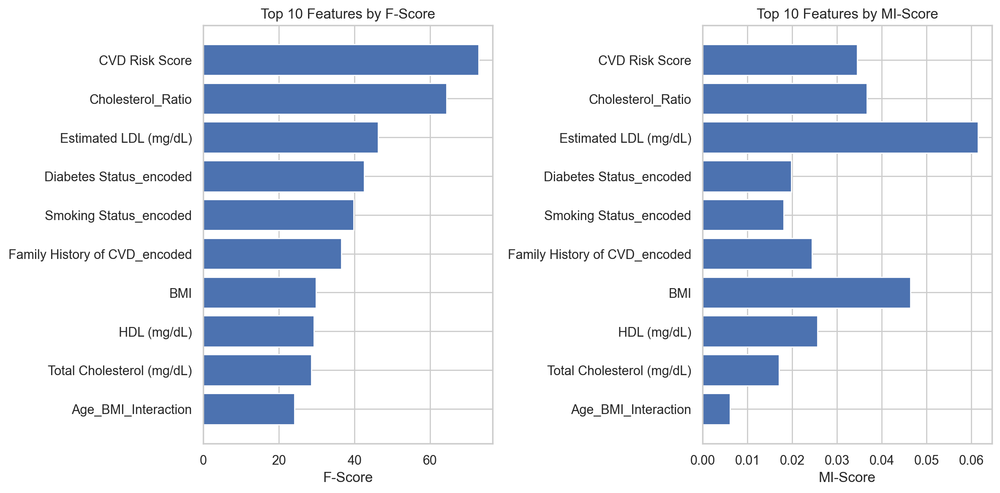

In [82]:
plt.figure(figsize=(12, 6))

# Concatenate top features from both F-Score and MI-Score for visualization
top_features_all = pd.merge(
    f_scores, mi_scores, on='Feature', suffixes=('_F', '_MI')
).head(10)

# Plot F-Scores
plt.subplot(1, 2, 1)
plt.barh(top_features_all['Feature'], top_features_all['F_Score'])
plt.xlabel('F-Score')
plt.title('Top 10 Features by F-Score')
plt.gca().invert_yaxis()

# Plot MI-Scores
plt.subplot(1, 2, 2)
plt.barh(top_features_all['Feature'], top_features_all['MI_Score'])
plt.xlabel('MI-Score')
plt.title('Top 10 Features by MI-Score')
plt.gca().invert_yaxis()

plt.tight_layout()
plt.show()


# Visualize feature importance

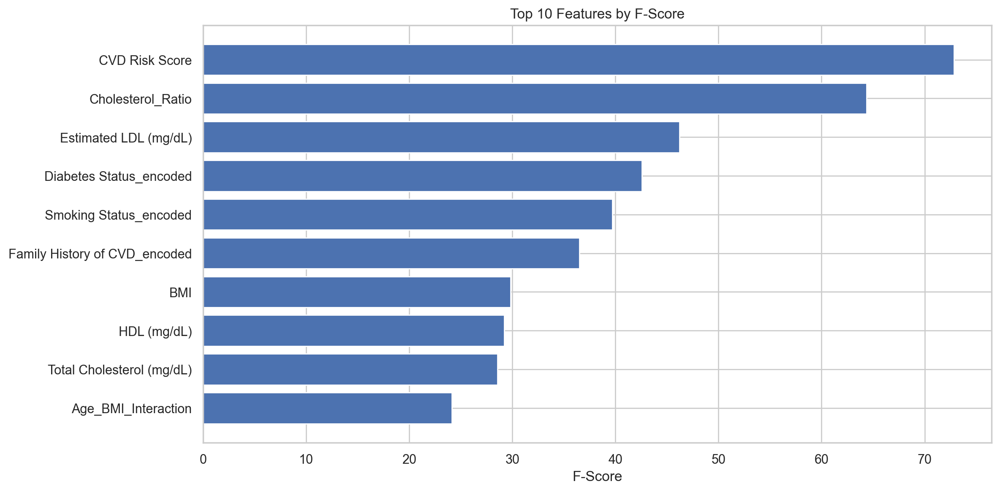

In [83]:

plt.figure(figsize=(12, 6))
top_features_combined = f_scores.head(10)
plt.barh(range(len(top_features_combined)), top_features_combined['F_Score'])
plt.yticks(range(len(top_features_combined)), top_features_combined['Feature'])
plt.xlabel('F-Score')
plt.title('Top 10 Features by F-Score')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

# DATA BALANCING AND SPLITTING


## Use selected features

In [84]:

X_selected = X_features[selected_features].copy()
y_selected = y_target.copy()

print(f"Original class distribution:")
print(pd.Series(y_selected).value_counts())


Original class distribution:
CVD_Risk_encoded
0    944
1    765
2    288
Name: count, dtype: int64


### SMOTE (Synthetic Minority Over-sampling Technique)

### SMOTE is an oversampling technique used to address imbalanced datasets. It works by creating synthetic samples from the minority class rather than by over-sampling with replacement. This helps to prevent overfitting and provides a more diverse set of samples for the model to learn from.



## Advanced balancing techniques

In [85]:

# Ensure X_selected and y_selected are defined before using them
try:
    X_selected
except NameError:
    X_selected = X_features[selected_features].copy()

try:
    y_selected
except NameError:
    y_selected = y_target.copy()

print("\nApplying SMOTEENN for balanced sampling...")
smoteenn = SMOTEENN(random_state=42)
X_balanced, y_balanced = smoteenn.fit_resample(X_selected, y_selected)

print(f"Balanced class distribution:")
print(pd.Series(y_balanced).value_counts())


Applying SMOTEENN for balanced sampling...
Balanced class distribution:
CVD_Risk_encoded
2    697
1    302
0    216
Name: count, dtype: int64


# Apply preprocessing

In [86]:
# Split the data
X_train, X_test, y_train, y_test = train_test_split(
    X_balanced, y_balanced, test_size=0.2, random_state=42, stratify=y_balanced
)

print(f"\nTraining set: {X_train.shape}")
print(f"Test set: {X_test.shape}")
print(f"Training class distribution: {np.bincount(y_train)}")
print(f"Test class distribution: {np.bincount(y_test)}")


Training set: (972, 20)
Test set: (243, 20)
Training class distribution: [173 242 557]
Test class distribution: [ 43  60 140]


Train-Test Split: An 80%-20% split was performed, assigning 80% of the data to training and 20% to testing.

Stratification: Stratification was applied to preserve the original balanced class proportions in both subsets.

Random State: The split was made reproducible by setting random_state=42.

Balanced Dataset: Both training and test sets retain the balanced class distribution established in prior preprocessing steps, as confirmed by np.bincount(y_train) and np.bincount(y_test).

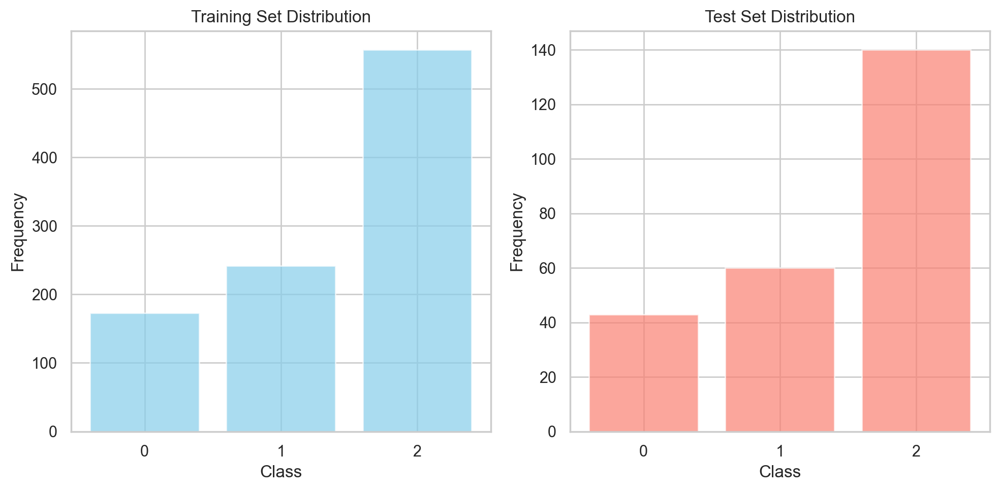

In [87]:
import matplotlib.pyplot as plt

# Visualize the Train-Test Split Distribution
def plot_train_test_distribution(y_train, y_test):
    plt.figure(figsize=(10, 5))
    
    # Training set distribution
    plt.subplot(1, 2, 1)
    plt.hist(y_train, bins=np.arange(0, max(y_train)+2)-0.5, rwidth=0.8, color='skyblue', alpha=0.7)
    plt.title('Training Set Distribution')
    plt.xlabel('Class')
    plt.ylabel('Frequency')
    plt.xticks(range(len(np.bincount(y_train))))
    
    # Test set distribution
    plt.subplot(1, 2, 2)
    plt.hist(y_test, bins=np.arange(0, max(y_test)+2)-0.5, rwidth=0.8, color='salmon', alpha=0.7)
    plt.title('Test Set Distribution')
    plt.xlabel('Class')
    plt.ylabel('Frequency')
    plt.xticks(range(len(np.bincount(y_test))))
    
    plt.tight_layout()
    plt.show()

plot_train_test_distribution(y_train, y_test)


 ## MODEL PIPELINE

## Create preprocessing pipeline

In [88]:

preprocessor = Pipeline([
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', RobustScaler())
])

## Decision Tree


Decision Tree Classification Report:
              precision    recall  f1-score   support

           0       0.69      0.63      0.66        43
           1       0.69      0.62      0.65        60
           2       0.83      0.89      0.86       140

    accuracy                           0.78       243
   macro avg       0.74      0.71      0.72       243
weighted avg       0.77      0.78      0.77       243



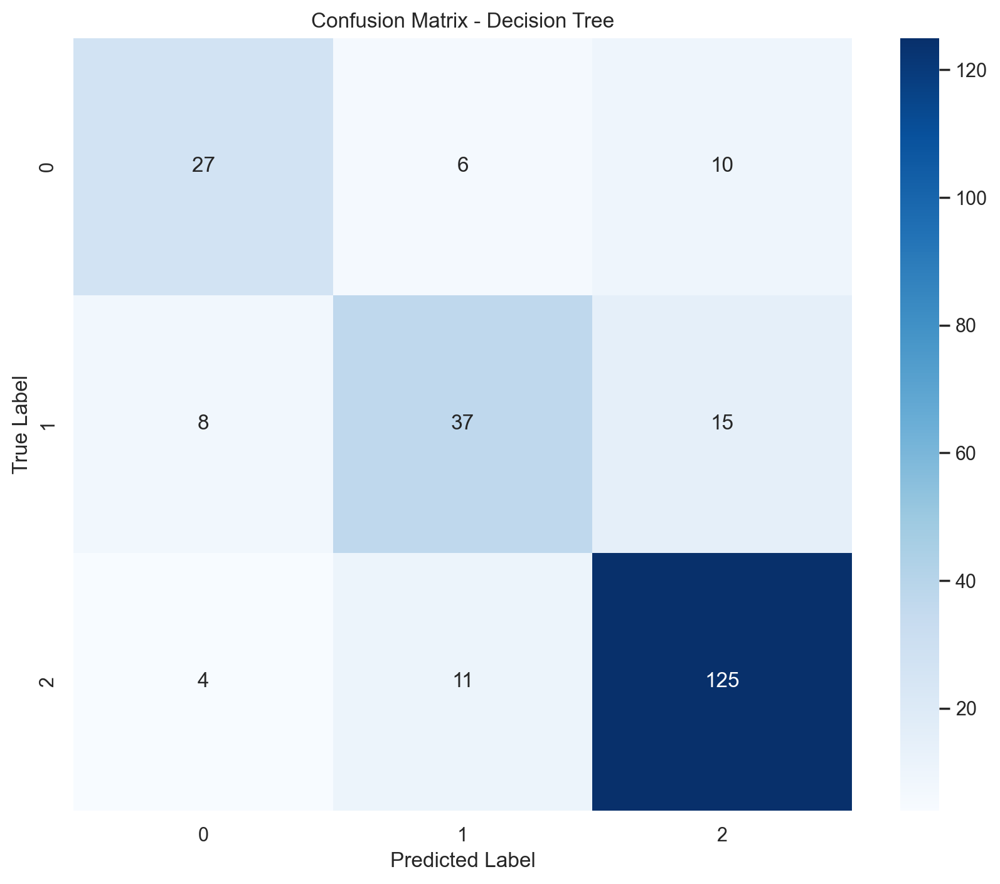

In [89]:
# Import Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

# Initialize and train the Decision Tree model
dt_model = DecisionTreeClassifier(random_state=42)
dt_model.fit(X_train, y_train)

# Make predictions
y_pred_dt = dt_model.predict(X_test)

# Print model performance metrics
print("\nDecision Tree Classification Report:")
print(classification_report(y_test, y_pred_dt))

# Create confusion matrix
plt.figure(figsize=(10, 8))
cm_dt = confusion_matrix(y_test, y_pred_dt)
sns.heatmap(cm_dt, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - Decision Tree')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()



## Naive Bayes


Naive Bayes Classification Report:
              precision    recall  f1-score   support

           0       0.58      0.67      0.62        43
           1       0.45      0.67      0.54        60
           2       0.80      0.60      0.69       140

    accuracy                           0.63       243
   macro avg       0.61      0.65      0.62       243
weighted avg       0.68      0.63      0.64       243



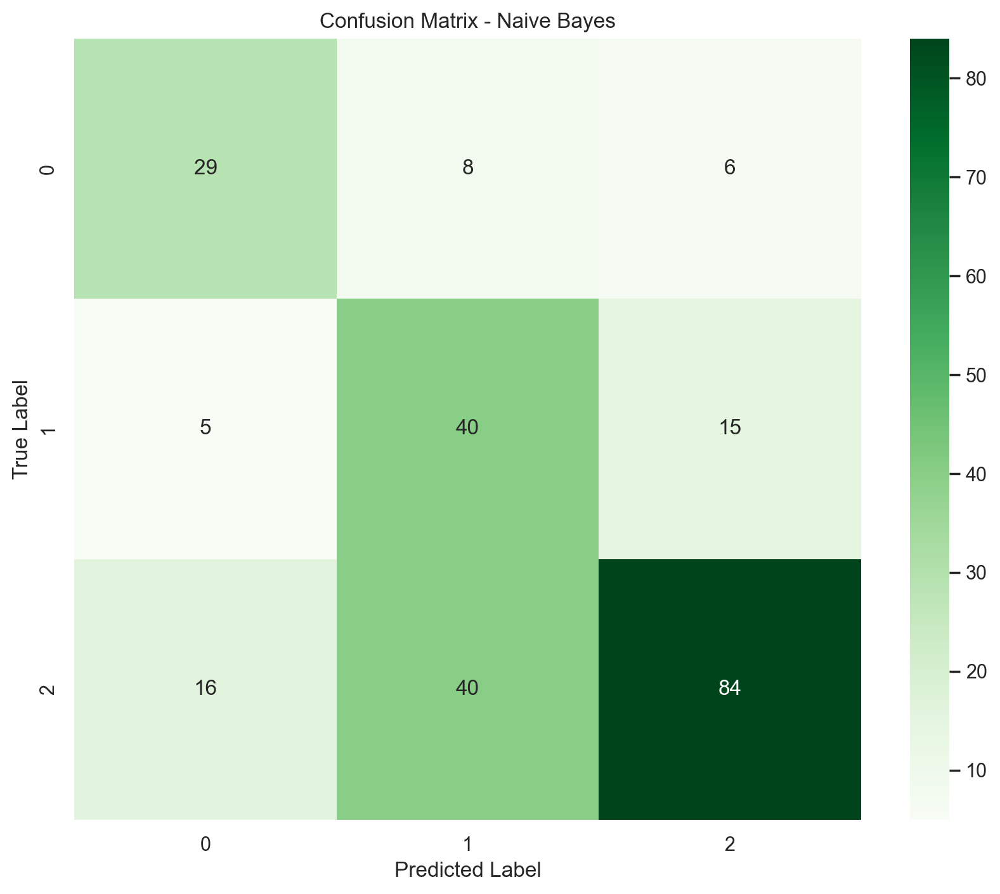

In [90]:
# Import Naive Bayes Classifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Initialize and train the Naive Bayes model
nb_model = GaussianNB()
nb_model.fit(X_train, y_train)

# Make predictions
y_pred_nb = nb_model.predict(X_test)

# Print model performance metrics
print("\nNaive Bayes Classification Report:")
print(classification_report(y_test, y_pred_nb))

# Create confusion matrix
plt.figure(figsize=(10, 8))
cm_nb = confusion_matrix(y_test, y_pred_nb)
sns.heatmap(cm_nb, annot=True, fmt='d', cmap='Greens')
plt.title('Confusion Matrix - Naive Bayes')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()


## Random Forest



Random Forest Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.74      0.81        43
           1       0.92      0.78      0.85        60
           2       0.88      0.99      0.93       140

    accuracy                           0.89       243
   macro avg       0.90      0.84      0.86       243
weighted avg       0.89      0.89      0.89       243



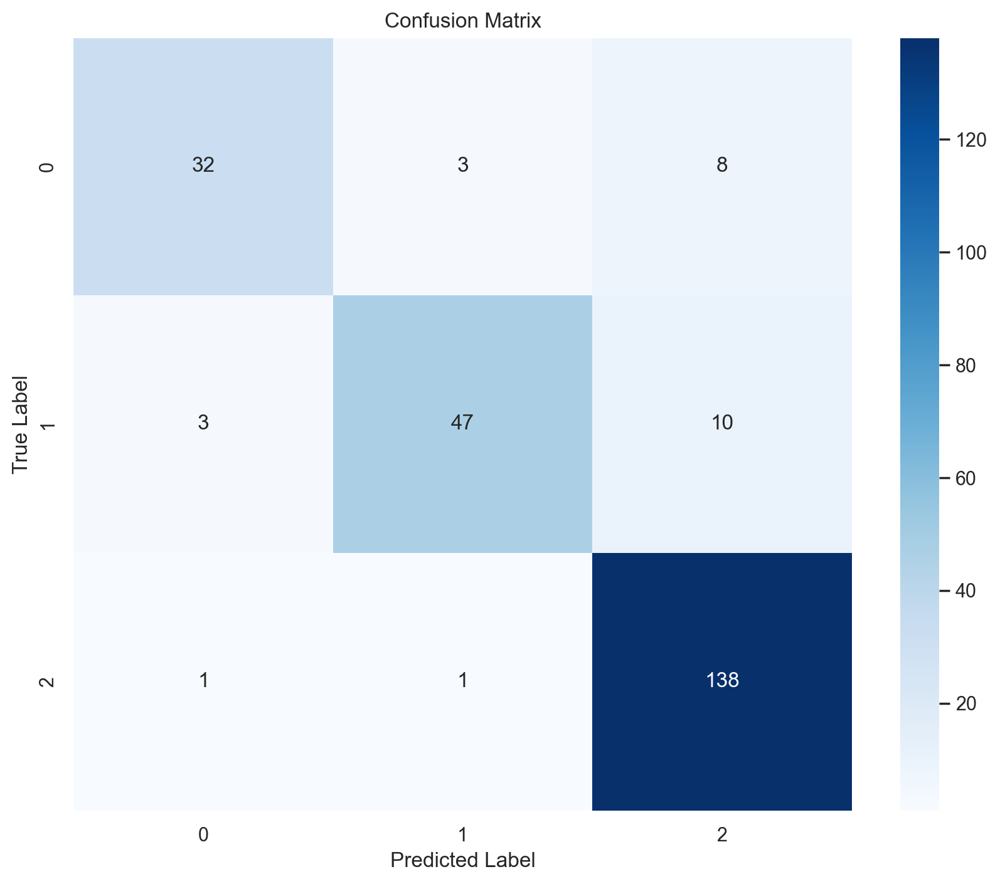

In [91]:
# Import Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

# Initialize and train the Random Forest model
rf_model = RandomForestClassifier(n_estimators=100, random_state=44)
rf_model.fit(X_train, y_train)

# Make predictions
y_pred = rf_model.predict(X_test)

# Print model performance metrics
print("\nRandom Forest Classification Report:")
print(classification_report(y_test, y_pred))

# Create confusion matrix
plt.figure(figsize=(10, 8))
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

# SVM (Support Vector Machine) - Training and Evaluation



SVM Classification Report:
              precision    recall  f1-score   support

           0       0.71      0.80      0.75       189
           1       0.65      0.74      0.69       153
           2       0.77      0.17      0.28        58

    accuracy                           0.69       400
   macro avg       0.71      0.57      0.57       400
weighted avg       0.69      0.69      0.66       400

SVM Accuracy: 0.6850


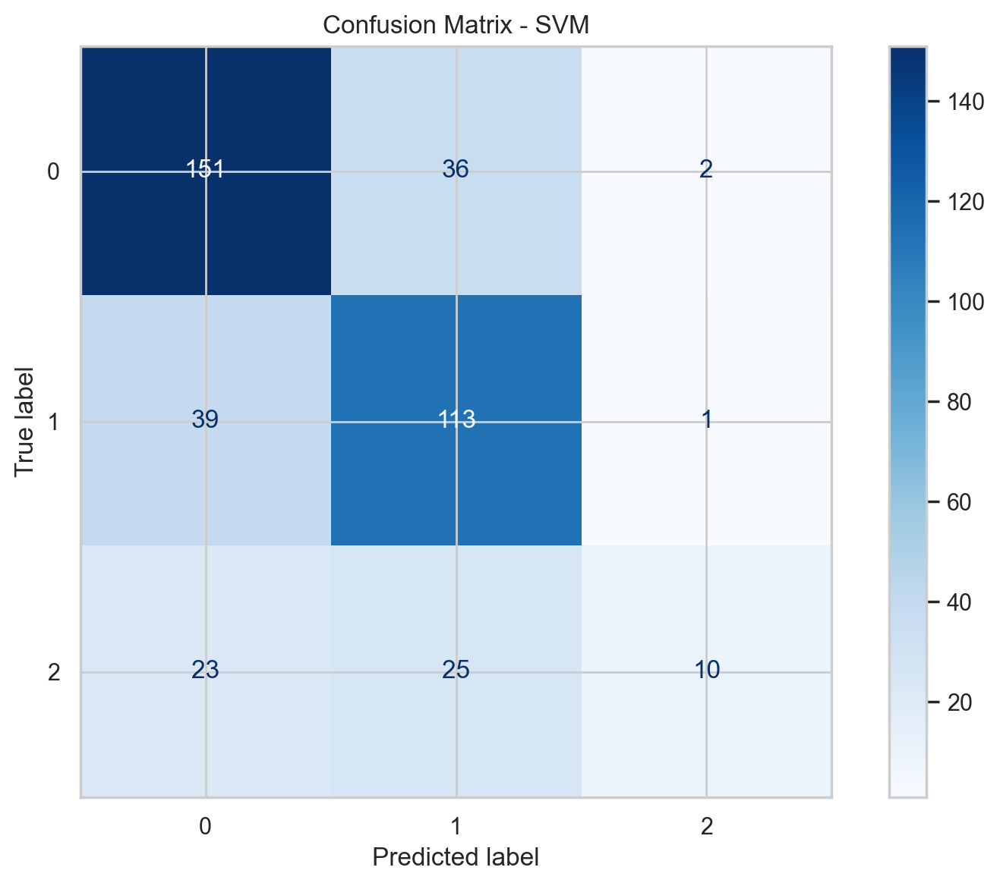

In [92]:
# SVM (Support Vector Machine) - Training and Evaluation
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
import numpy as np
import matplotlib.pyplot as plt

# 1) Resolve train/test scaled features and labels
if 'X_train' in globals() and 'X_test_scaled' in globals() and 'y_train' in globals() and 'y_test' in globals():
    X_tr = X_train_scaled
    X_te = X_test_scaled
    y_tr = y_train
    y_te = y_test
else:
    # Fall back: build split and scaling from X/y already prepared in the notebook
    if 'X' in globals() and 'y' in globals():
        X_tr_raw, X_te_raw, y_tr, y_te = train_test_split(
            X, y, test_size=0.2, random_state=42, stratify=y
        )
        # Handle missing values
        imputer = SimpleImputer(strategy='mean')
        X_tr_raw = imputer.fit_transform(X_tr_raw)
        X_te_raw = imputer.transform(X_te_raw)
        
        # Reuse an existing scaler if present, else create a new one
        if 'scaler' in globals():
            scaler_to_use = scaler
            X_tr = scaler_to_use.fit_transform(X_tr_raw)
            X_te = scaler_to_use.transform(X_te_raw)
        else:
            scaler_to_use = StandardScaler()
            X_tr = scaler_to_use.fit_transform(X_tr_raw)
            X_te = scaler_to_use.transform(X_te_raw)
    else:
        raise RuntimeError("Neither (X_train_scaled, y_train, X_test_scaled, y_test) nor (X, y) are available to build the SVM.")

# 2) Train SVM on scaled features
svm_model = SVC(kernel='rbf', C=1.0, gamma='scale', probability=True, random_state=42)
svm_model.fit(X_tr, y_tr)

# 3) Predict
y_pred_svm = svm_model.predict(X_te)

# 4) Report with robust label handling
print("\nSVM Classification Report:")
model_classes = svm_model.classes_                   # underlying label values
display_class_names = [str(c) for c in model_classes]
print(classification_report(
    y_te, y_pred_svm,
    labels=model_classes,
    target_names=display_class_names
))
print(f"SVM Accuracy: {accuracy_score(y_te, y_pred_svm):.4f}")

# 5) Confusion matrix (aligned labels and display names)
plt.figure(figsize=(8, 6))
cm_svm = confusion_matrix(y_te, y_pred_svm, labels=model_classes)
disp_svm = ConfusionMatrixDisplay(confusion_matrix=cm_svm, display_labels=display_class_names)
disp_svm.plot(cmap='Blues', values_format='d', ax=plt.gca())
plt.title('Confusion Matrix - SVM')
plt.tight_layout()
plt.show()

## KNN Classifier

Fitting 2 folds for each of 10 candidates, totalling 20 fits
Classification Report for KNN Classifier for this project:
              precision    recall  f1-score   support

           0       0.93      0.86      0.89        43
           1       0.97      0.93      0.95        60
           2       0.94      0.98      0.96       140

    accuracy                           0.95       243
   macro avg       0.95      0.92      0.93       243
weighted avg       0.95      0.95      0.95       243



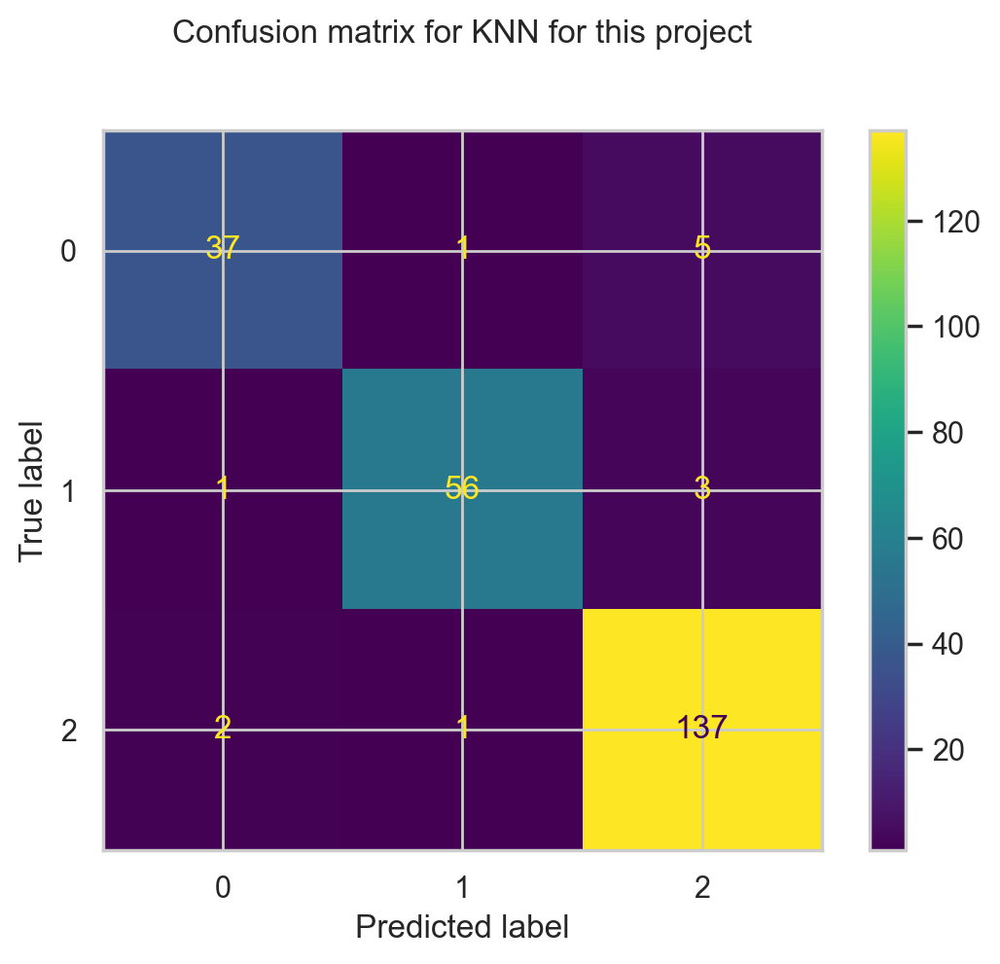

In [93]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report

# Initialize KNN classifier with default parameters
knn = KNeighborsClassifier()

# Perform grid search over specified parameter values
param_grid = {'n_neighbors': range(1, 11)}
grid_search = GridSearchCV(estimator=knn, param_grid=param_grid,
                           cv=2, n_jobs=3, verbose=2, scoring='accuracy')

grid_search.fit(X_train, y_train)
best_knn = grid_search.best_estimator_
predknn = best_knn.predict(X_test)

print("Classification Report for KNN Classifier for this project:")
print(classification_report(y_test, predknn))

# Plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

confusion_matrix = confusion_matrix(y_test, predknn)
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix)
disp.plot()

plt.title('Confusion matrix for KNN for this project', y=1.1)
plt.show()



Fitting 2 folds for each of 10 candidates, totalling 20 fits
Classification Report for KNN Classifier for this project:
              precision    recall  f1-score   support

           0       0.93      0.86      0.89        43
           1       0.97      0.93      0.95        60
           2       0.94      0.98      0.96       140

    accuracy                           0.95       243
   macro avg       0.95      0.92      0.93       243
weighted avg       0.95      0.95      0.95       243



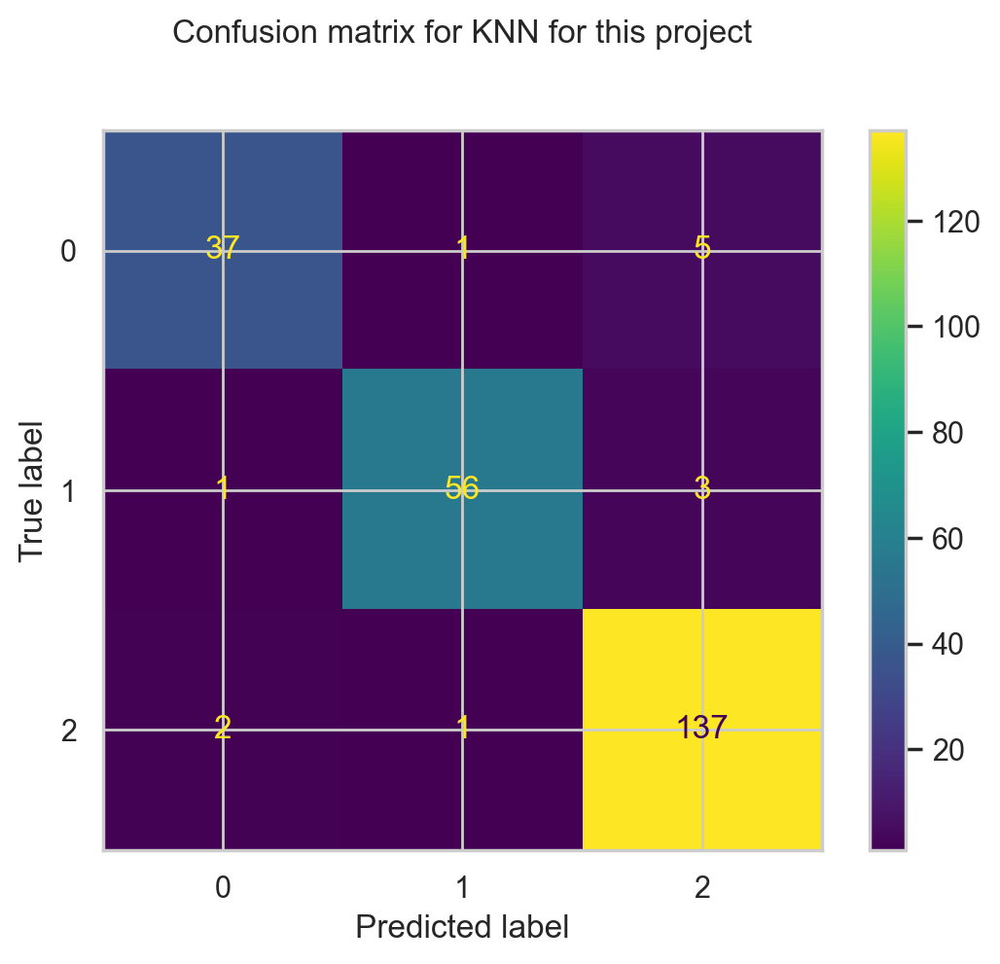


FEATURE IMPORTANCE ANALYSIS FOR KNN CLASSIFIER

Top 10 Most Important Features:
                      Feature  Importance      Std
          Age_BMI_Interaction    0.432099 0.029099
Blood Pressure (mmHg)_encoded    0.430041 0.028762
        Estimated LDL (mg/dL)    0.078189 0.020903
    Total Cholesterol (mg/dL)    0.058848 0.014380
  Fasting Blood Sugar (mg/dL)    0.028807 0.007808
         Cardiovascular_Index    0.008642 0.008323
                  Weight (kg)    0.004938 0.002469
                  Systolic BP    0.003292 0.001646
                  HDL (mg/dL)    0.003292 0.001646
              Metabolic_Index    0.001235 0.001886


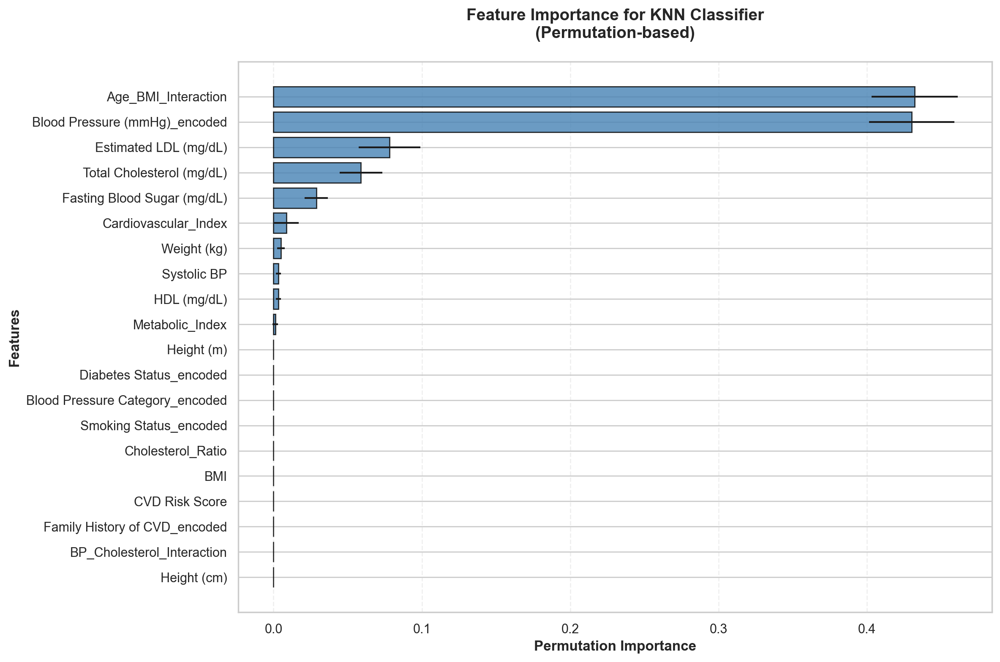

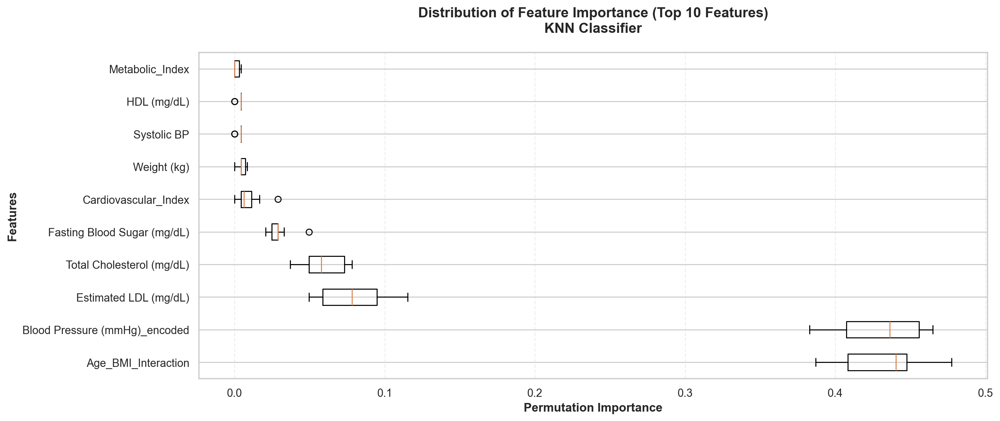


✅ Feature Importance Analysis Completed!


In [94]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV

# Initialize KNN classifier with default parameters
knn = KNeighborsClassifier()

# Perform grid search over specified parameter values
param_grid = {'n_neighbors': range(1, 11)}
grid_search = GridSearchCV(estimator=knn, param_grid=param_grid,
                           cv=2, n_jobs=3, verbose=2, scoring='accuracy')

grid_search.fit(X_train, y_train)
best_knn = grid_search.best_estimator_
predknn = best_knn.predict(X_test)

print("Classification Report for KNN Classifier for this project:")
print(classification_report(y_test, predknn))

# Plot confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

confusion_matrix = confusion_matrix(y_test, predknn)
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix)
disp.plot()

plt.title('Confusion matrix for KNN for this project', y=1.1)
plt.show()

# Feature Importance using Permutation Importance
print("\n" + "="*60)
print("FEATURE IMPORTANCE ANALYSIS FOR KNN CLASSIFIER")
print("="*60)

from sklearn.inspection import permutation_importance
import numpy as np

# Calculate permutation importance
perm_importance = permutation_importance(
    best_knn, X_test, y_test, 
    n_repeats=10, 
    random_state=42, 
    n_jobs=-1
)

# Get feature names (assuming selected_features is available, otherwise use column names)
try:
    feature_names = selected_features
except:
    if hasattr(X_train, 'columns'):
        feature_names = X_train.columns.tolist()
    else:
        feature_names = [f'Feature_{i}' for i in range(X_train.shape[1])]

# Sort features by importance
sorted_idx = perm_importance.importances_mean.argsort()[::-1]

# Create feature importance dataframe
importance_df = pd.DataFrame({
    'Feature': [feature_names[i] for i in sorted_idx],
    'Importance': perm_importance.importances_mean[sorted_idx],
    'Std': perm_importance.importances_std[sorted_idx]
})

print("\nTop 10 Most Important Features:")
print(importance_df.head(10).to_string(index=False))

# Plot feature importance
plt.figure(figsize=(12, 8))
top_n = min(20, len(feature_names))  # Show top 20 features
y_pos = np.arange(top_n)

plt.barh(y_pos, importance_df['Importance'].head(top_n), 
         xerr=importance_df['Std'].head(top_n),
         align='center', alpha=0.8, color='steelblue', edgecolor='black')
plt.yticks(y_pos, importance_df['Feature'].head(top_n))
plt.xlabel('Permutation Importance', fontsize=12, fontweight='bold')
plt.ylabel('Features', fontsize=12, fontweight='bold')
plt.title('Feature Importance for KNN Classifier\n(Permutation-based)', 
          fontsize=14, fontweight='bold', pad=20)
plt.gca().invert_yaxis()
plt.grid(axis='x', alpha=0.3, linestyle='--')
plt.tight_layout()
plt.show()

# Additional visualization: Box plot for top features
plt.figure(figsize=(14, 6))
top_features = importance_df.head(10)['Feature'].tolist()
box_data = [perm_importance.importances[sorted_idx[i]] for i in range(min(10, len(feature_names)))]

plt.boxplot(box_data, labels=top_features, vert=False)
plt.xlabel('Permutation Importance', fontsize=12, fontweight='bold')
plt.ylabel('Features', fontsize=12, fontweight='bold')
plt.title('Distribution of Feature Importance (Top 10 Features)\nKNN Classifier', 
          fontsize=14, fontweight='bold', pad=20)
plt.grid(axis='x', alpha=0.3, linestyle='--')
plt.tight_layout()
plt.show()

print("\n✅ Feature Importance Analysis Completed!")


In [95]:
!pip install shap

## ENHANCED XGBOOST MODEL

# Bayesian search with cross-validation

In [96]:

from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier

# Define parameter grid for Random Forest
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Initialize Random Forest classifier
rf = RandomForestClassifier(random_state=42)

# Perform Grid Search with Cross-Validation
grid_search = GridSearchCV(
    estimator=rf,
    param_grid=param_grid,
    cv=5,
    scoring='accuracy',
    n_jobs=-1,
    verbose=1
)

print("Grid Search setup completed!")

Grid Search setup completed!



Random Forest Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.70      0.78        43
           1       0.87      0.80      0.83        60
           2       0.89      0.98      0.93       140

    accuracy                           0.88       243
   macro avg       0.88      0.83      0.85       243
weighted avg       0.88      0.88      0.88       243



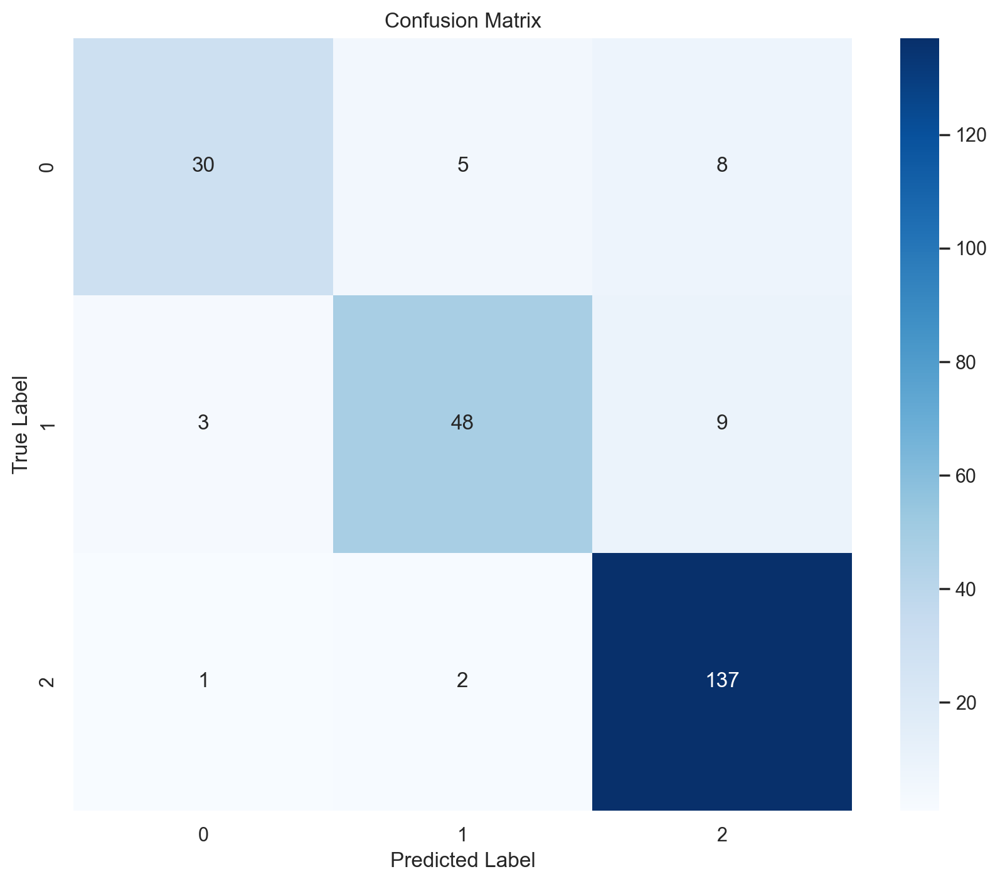

In [97]:
# Import Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

# Initialize and train the Random Forest model
rf_model = RandomForestClassifier(n_estimators=200, random_state=44)
rf_model.fit(X_train, y_train)

# Make predictions
y_pred = rf_model.predict(X_test)

# Print model performance metrics
print("\nRandom Forest Classification Report:")
print(classification_report(y_test, y_pred))

# Create confusion matrix
plt.figure(figsize=(10, 8))
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

### XGBoost classifier

In [98]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, classification_report
import joblib

# Initialize XGBoost classifier
xgb_clf = XGBClassifier(use_label_encoder=False, eval_metric='mlogloss')

# Define xgb_grid if not already defined
xgb_grid = GridSearchCV(
    estimator=xgb_clf,
    param_grid={
        'max_depth': [3, 6, 9],
        'learning_rate': [0.01, 0.1, 0.2],
        'n_estimators': [100, 200, 300]
    },
    cv=5,
    scoring='accuracy',
    n_jobs=1,  # Set n_jobs to 1 to avoid BrokenProcessPool error
    verbose=1
)

# Fit a single label encoder on the full set of labels and transform both y_train and y_test
# (If you already have a consistent encoder in memory, reuse it instead)
label_encoder = LabelEncoder()
label_encoder.fit(y_train)  # fit on train only to avoid leakage

y_train_encoded = label_encoder.transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

# Sanity check for matching samples
if len(X_train) == len(y_train_encoded):
    # Fit the grid search
    xgb_grid.fit(X_train, y_train_encoded)

    # Check if the best estimator is available
    if hasattr(xgb_grid, 'best_estimator_'):
        best_xgb = xgb_grid.best_estimator_
        y_pred_xgb = best_xgb.predict(X_test)

        # Use encoded y_test to compare against encoded predictions
        xgb_accuracy = accuracy_score(y_test_encoded, y_pred_xgb)

        print(f"\nXGBoost Test Accuracy: {xgb_accuracy:.4f}")
        print("\nClassification Report:")
        print(
            classification_report(
                y_test_encoded,
                y_pred_xgb,
                target_names=[str(c) for c in label_encoder.classes_]
            )
        )
    else:
        print("XGBoost model is not fitted. Please fit the model before prediction.")
else:
    print("Error: The number of samples in X_train_scaled and y_train_encoded do not match.")

Fitting 5 folds for each of 27 candidates, totalling 135 fits

XGBoost Test Accuracy: 0.8765

Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.72      0.78        43
           1       0.87      0.77      0.81        60
           2       0.89      0.97      0.93       140

    accuracy                           0.88       243
   macro avg       0.86      0.82      0.84       243
weighted avg       0.87      0.88      0.87       243



### # Gradient Boosting

1. Training Gradient Boosting...
Gradient Boosting Accuracy: 0.9053

Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.79      0.85        43
           1       0.89      0.83      0.86        60
           2       0.91      0.97      0.94       140

    accuracy                           0.91       243
   macro avg       0.91      0.87      0.88       243
weighted avg       0.91      0.91      0.90       243



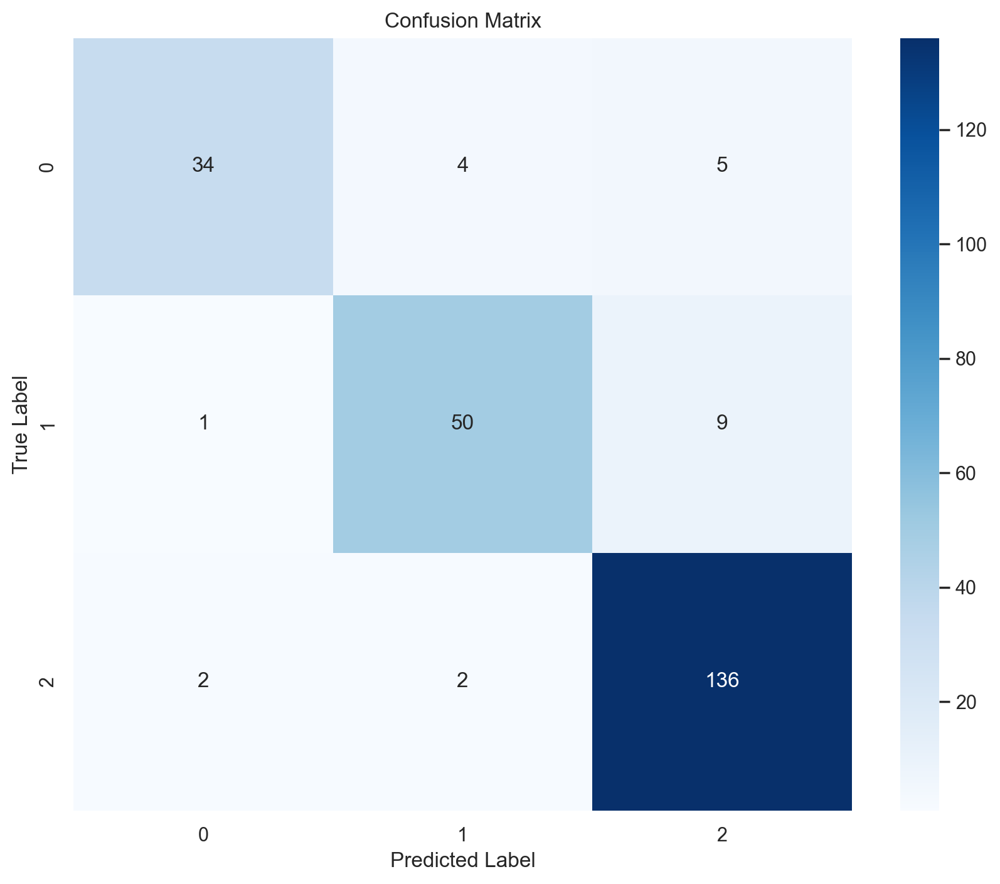

In [99]:
# Gradient Boosting
print("1. Training Gradient Boosting...")
gb_model = GradientBoostingClassifier(
    n_estimators=200, 
    learning_rate=0.1, 
    max_depth=5, 
    random_state=42
)
gb_model.fit(X_train, y_train)
y_pred_gb = gb_model.predict(X_test)
gb_accuracy = accuracy_score(y_test, y_pred_gb)
print(f"Gradient Boosting Accuracy: {gb_accuracy:.4f}")
print("\nClassification Report:")
print(classification_report(y_test, y_pred_gb))

# Create confusion matrix
plt.figure(figsize=(10, 8))
cm = confusion_matrix(y_test, y_pred_gb)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

### BAGGING CLASSIFIER

🔧 FIXING BAGGING CLASSIFIER ERROR
📊 Training Fixed Bagging Classifier...
Configuration:
  • Base Estimator: Decision Tree (max_depth=10)
  • Number of Estimators: 100
  • Max Samples: 1.0 (bootstrap=True)
  • Bootstrap: True

✅ Fixed Bagging Model Training Completed!
🎯 Test Accuracy: 0.8683 (86.83%)

📋 BAGGING CLASSIFICATION REPORT:
--------------------------------------------------
              precision    recall  f1-score   support

           0       0.85      0.67      0.75        43
           1       0.84      0.80      0.82        60
           2       0.88      0.96      0.92       140

    accuracy                           0.87       243
   macro avg       0.86      0.81      0.83       243
weighted avg       0.87      0.87      0.86       243


🔢 CONFUSION MATRIX - BAGGING:
----------------------------------------


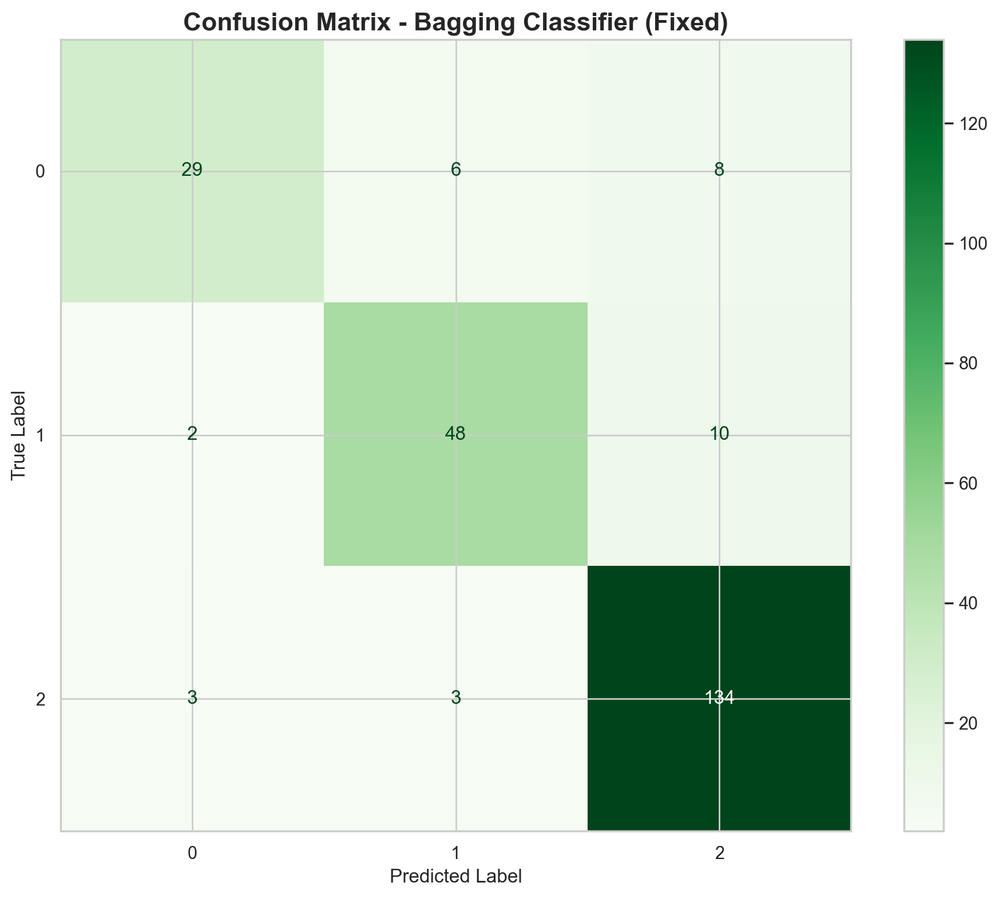

Confusion Matrix Values:
Rows: True Labels, Columns: Predicted Labels
True Labels: ['0', '1', '2']
Confusion Matrix:
  0: [29  6  8]
  1: [ 2 48 10]
  2: [  3   3 134]

🔍 FEATURE IMPORTANCE ANALYSIS:
----------------------------------------
Top 10 Most Important Features:
-----------------------------------
 1. Fasting Blood Sugar (mg/dL)    0.1005
 2. Age_BMI_Interaction            0.0955
 3. Blood Pressure (mmHg)_encoded  0.0929
 4. Systolic BP                    0.0925
 5. Cholesterol_Ratio              0.0691
 6. Estimated LDL (mg/dL)          0.0679
 7. Cardiovascular_Index           0.0637
 8. Weight (kg)                    0.0514
 9. CVD Risk Score                 0.0488
10. BP_Cholesterol_Interaction     0.0399


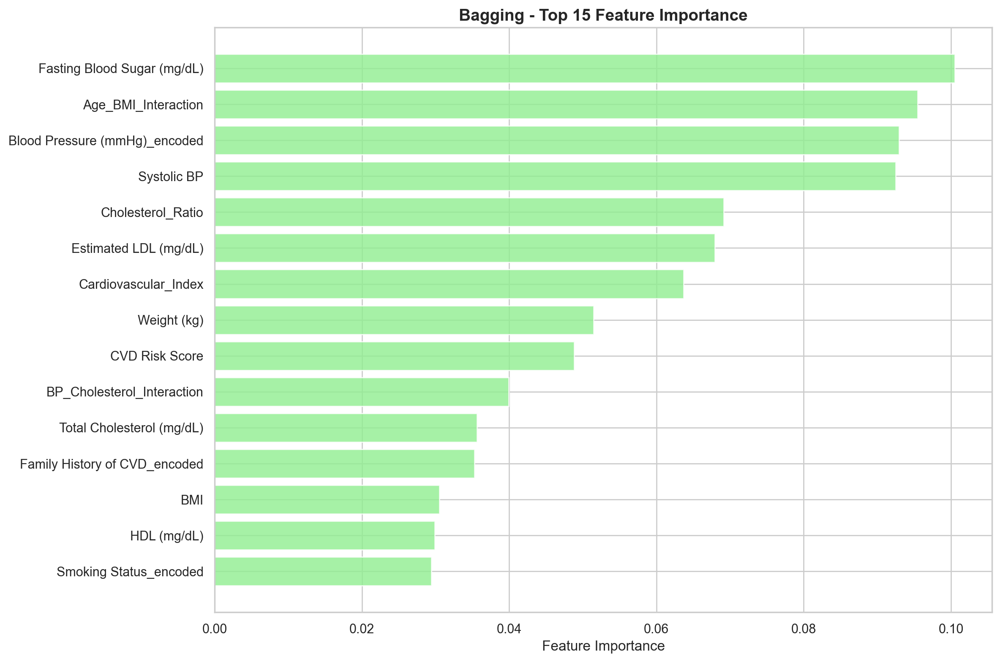


📈 DETAILED PERFORMANCE METRICS:
---------------------------------------------
0:
  • Precision: 0.8529
  • Recall:    0.6744
  • F1-Score:  0.7532
  • Support:   43
1:
  • Precision: 0.8421
  • Recall:    0.8000
  • F1-Score:  0.8205
  • Support:   60
2:
  • Precision: 0.8816
  • Recall:    0.9571
  • F1-Score:  0.9178
  • Support:   140

Overall (Macro Average):
  • Precision: 0.8589
  • Recall:    0.8105
  • F1-Score:  0.8305

🎉 FIXED BAGGING CLASSIFIER ANALYSIS COMPLETED!


In [100]:
# FIXED BAGGING CLASSIFIER - Updated for newer scikit-learn versions
print("🔧 FIXING BAGGING CLASSIFIER ERROR")
print("=" * 50)

from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.metrics import ConfusionMatrixDisplay, precision_recall_fscore_support
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Initialize Bagging Classifier with correct parameter name
print("📊 Training Fixed Bagging Classifier...")
print("Configuration:")
print("  • Base Estimator: Decision Tree (max_depth=10)")
print("  • Number of Estimators: 100")
print("  • Max Samples: 1.0 (bootstrap=True)")
print("  • Bootstrap: True")

bagging_model_fixed = BaggingClassifier(
    estimator=DecisionTreeClassifier(max_depth=10, random_state=42),  # Changed from base_estimator to estimator
    n_estimators=100,
    max_samples=1.0,
    max_features=1.0,
    bootstrap=True,
    bootstrap_features=False,
    random_state=42,
    n_jobs=-1
)

# Train the model on scaled features
bagging_model_fixed.fit(X_train, y_train)

# Make predictions
y_pred_bagging_fixed = bagging_model_fixed.predict(X_test)
bagging_accuracy_fixed = accuracy_score(y_test, y_pred_bagging_fixed)

print(f"\n✅ Fixed Bagging Model Training Completed!")
print(f"🎯 Test Accuracy: {bagging_accuracy_fixed:.4f} ({bagging_accuracy_fixed*100:.2f}%)")

# Prepare class labels consistently
model_classes = bagging_model_fixed.classes_                # underlying label values (could be ints/strings)
display_class_names = [str(c) for c in model_classes]       # always strings for display

# Classification Report (ensure names are strings and aligned with labels)
print(f"\n📋 BAGGING CLASSIFICATION REPORT:")
print("-" * 50)
print(
    classification_report(
        y_test,
        y_pred_bagging_fixed,
        labels=model_classes,
        target_names=display_class_names
    )
)

# Confusion Matrix
print(f"\n🔢 CONFUSION MATRIX - BAGGING:")
print("-" * 40)

cm_bagging_fixed = confusion_matrix(y_test, y_pred_bagging_fixed, labels=model_classes)

plt.figure(figsize=(10, 8))
disp_bagging_fixed = ConfusionMatrixDisplay(confusion_matrix=cm_bagging_fixed,
                                           display_labels=display_class_names)
disp_bagging_fixed.plot(cmap='Greens', values_format='d', ax=plt.gca())
plt.title('Confusion Matrix - Bagging Classifier (Fixed)', fontsize=16, fontweight='bold')
plt.xlabel('Predicted Label', fontsize=12)
plt.ylabel('True Label', fontsize=12)
plt.tight_layout()
plt.show()

# Print confusion matrix values
print("Confusion Matrix Values:")
print("Rows: True Labels, Columns: Predicted Labels")
print("=" * 50)
print(f"True Labels: {display_class_names}")
print("Confusion Matrix:")
for i, true_label in enumerate(display_class_names):
    print(f"  {true_label}: {cm_bagging_fixed[i]}")

# Feature Importance Analysis
print(f"\n🔍 FEATURE IMPORTANCE ANALYSIS:")
print("-" * 40)

# Get feature importance from Bagging (average across all base estimators)
feature_importance_bagging = np.mean(
    [tree.feature_importances_ for tree in bagging_model_fixed.estimators_],
    axis=0
)
feature_names = selected_features

# Create feature importance DataFrame
importance_df_bagging = pd.DataFrame({
    'Feature': feature_names,
    'Importance': feature_importance_bagging
}).sort_values('Importance', ascending=False)

print("Top 10 Most Important Features:")
print("-" * 35)
for i, (_, row) in enumerate(importance_df_bagging.head(10).iterrows(), 1):
    print(f"{i:2d}. {row['Feature']:<30s} {row['Importance']:.4f}")

# Visualize feature importance
plt.figure(figsize=(12, 8))
top_features_bagging = importance_df_bagging.head(15)
plt.barh(range(len(top_features_bagging)), top_features_bagging['Importance'],
         color='lightgreen', alpha=0.8)
plt.yticks(range(len(top_features_bagging)), top_features_bagging['Feature'])
plt.xlabel('Feature Importance')
plt.title('Bagging - Top 15 Feature Importance', fontsize=14, fontweight='bold')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

# Model Performance Metrics (align order with labels)
print(f"\n📈 DETAILED PERFORMANCE METRICS:")
print("-" * 45)

precision, recall, f1, support = precision_recall_fscore_support(
    y_test,
    y_pred_bagging_fixed,
    labels=model_classes,
    average=None
)

for i, class_name in enumerate(display_class_names):
    print(f"{class_name}:")
    print(f"  • Precision: {precision[i]:.4f}")
    print(f"  • Recall:    {recall[i]:.4f}")
    print(f"  • F1-Score:  {f1[i]:.4f}")
    print(f"  • Support:   {support[i]}")

# Overall metrics
precision_macro = precision_recall_fscore_support(y_test, y_pred_bagging_fixed, average='macro')[0]
recall_macro = precision_recall_fscore_support(y_test, y_pred_bagging_fixed, average='macro')[1]
f1_macro = precision_recall_fscore_support(y_test, y_pred_bagging_fixed, average='macro')[2]

print(f"\nOverall (Macro Average):")
print(f"  • Precision: {precision_macro:.4f}")
print(f"  • Recall:    {recall_macro:.4f}")
print(f"  • F1-Score:  {f1_macro:.4f}")

print(f"\n🎉 FIXED BAGGING CLASSIFIER ANALYSIS COMPLETED!")
print("=" * 60)

ROC-AUC EVALUATION FOR BASE MODELS
Number of classes: 3
Classes: [0 1 2]

Evaluating Decision Tree...
✅ Decision Tree evaluation completed

Evaluating Naive Bayes...
✅ Naive Bayes evaluation completed

Evaluating Random Forest...
✅ Random Forest evaluation completed

Evaluating SVM...
❌ Error evaluating SVM: X has 20 features, but SVC is expecting 21 features as input.

Evaluating KNN...
✅ KNN evaluation completed

Evaluating XGBoost...
✅ XGBoost evaluation completed

Evaluating Gradient Boosting...
✅ Gradient Boosting evaluation completed

Evaluating Bagging...
✅ Bagging evaluation completed

ROC-AUC SCORES FOR BASE MODELS
Model                ROC-AUC (OVO)   ROC-AUC (OVR)  
--------------------------------------------------
Decision Tree        0.7844          0.7903         
Naive Bayes          0.8070          0.7983         
Random Forest        0.9603          0.9640         
KNN                  0.9431          0.9448         
XGBoost              0.9406          0.9447         

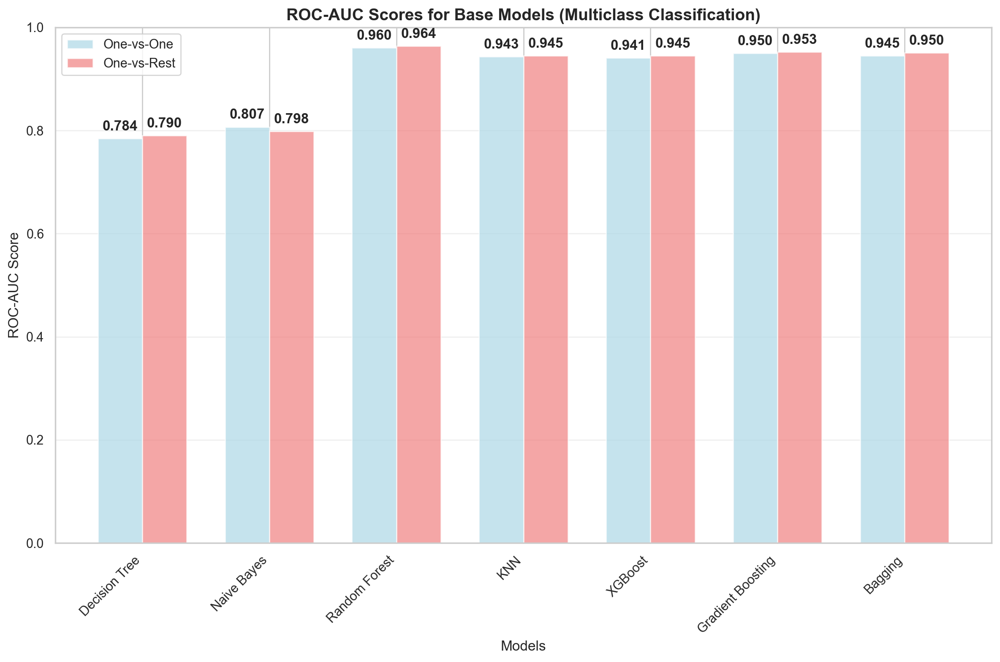


✅ ROC-AUC evaluation for base models completed!


In [101]:
# ROC-AUC Evaluation for Base Models
print("=" * 80)
print("ROC-AUC EVALUATION FOR BASE MODELS")
print("=" * 80)

from sklearn.metrics import roc_auc_score, roc_curve, accuracy_score
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.neighbors import KNeighborsClassifier

# Define base models dictionary
base_models = {
    'Decision Tree': dt_model,
    'Naive Bayes': nb_model,
    'Random Forest': rf_model,
    'SVM': svm_model,
    'KNN':best_knn,  # Initialize KNN model
    'XGBoost': best_xgb,
    'Gradient Boosting': gb_model,
    'Bagging': bagging_model_fixed
}

# Get predictions and probabilities for all models
model_results = {}
roc_auc_scores = {}

# Ensure we have the correct test data
if 'X_test' in globals() and 'y_test' in globals():
    X_test_eval = X_test
    y_test_eval = y_test
elif 'X_test_scaled' in globals() and 'y_test' in globals():
    X_test_eval = X_test_scaled
    y_test_eval = y_test
else:
    print("Error: Test data not found. Please ensure X_test and y_test are available.")
    X_test_eval = None
    y_test_eval = None

if X_test_eval is not None and y_test_eval is not None:
    # Get unique classes
    classes = np.unique(y_test_eval)
    n_classes = len(classes)
    
    print(f"Number of classes: {n_classes}")
    print(f"Classes: {classes}")
    
    # Binarize labels for multiclass ROC-AUC
    y_test_bin = label_binarize(y_test_eval, classes=classes)
    
    # Evaluate each model
    for model_name, model in base_models.items():
        try:
            print(f"\nEvaluating {model_name}...")
            
            # Get predictions
            y_pred = model.predict(X_test_eval)
            
            # Get probabilities if available
            if hasattr(model, 'predict_proba'):
                y_proba = model.predict_proba(X_test_eval)
            elif hasattr(model, 'decision_function'):
                y_proba = model.decision_function(X_test_eval)
                # Normalize decision function scores to probabilities
                if y_proba.ndim == 1:
                    y_proba = np.column_stack([1-y_proba, y_proba])
            else:
                print(f"Warning: {model_name} does not support probability prediction")
                continue
            
            # Calculate ROC-AUC scores
            if n_classes == 2:
                # Binary classification
                roc_auc = roc_auc_score(y_test_eval, y_proba[:, 1])
                roc_auc_scores[model_name] = roc_auc
            else:
                # Multiclass classification
                roc_auc_ovo = roc_auc_score(y_test_eval, y_proba, multi_class='ovo', average='macro')
                roc_auc_ovr = roc_auc_score(y_test_eval, y_proba, multi_class='ovr', average='macro')
                roc_auc_scores[model_name] = {
                    'ovo': roc_auc_ovo,
                    'ovr': roc_auc_ovr
                }
            
            model_results[model_name] = {
                'predictions': y_pred,
                'probabilities': y_proba,
                'accuracy': accuracy_score(y_test_eval, y_pred)
            }
            
            print(f"✅ {model_name} evaluation completed")
            
        except Exception as e:
            print(f"❌ Error evaluating {model_name}: {str(e)}")
            continue
    
    # Display ROC-AUC results
    print(f"\n{'='*60}")
    print("ROC-AUC SCORES FOR BASE MODELS")
    print(f"{'='*60}")
    
    if n_classes == 2:
        print(f"{'Model':<20} {'ROC-AUC':<10}")
        print("-" * 30)
        for model_name, score in roc_auc_scores.items():
            print(f"{model_name:<20} {score:<10.4f}")
    else:
        print(f"{'Model':<20} {'ROC-AUC (OVO)':<15} {'ROC-AUC (OVR)':<15}")
        print("-" * 50)
        for model_name, scores in roc_auc_scores.items():
            if isinstance(scores, dict):
                print(f"{model_name:<20} {scores['ovo']:<15.4f} {scores['ovr']:<15.4f}")
            else:
                print(f"{model_name:<20} {scores:<15.4f} {'N/A':<15}")
    
    # Create comparison plot
    plt.figure(figsize=(12, 8))
    
    if n_classes == 2:
        models = list(roc_auc_scores.keys())
        scores = list(roc_auc_scores.values())
        
        plt.bar(models, scores, color='skyblue', alpha=0.7, edgecolor='black')
        plt.title('ROC-AUC Scores for Base Models (Binary Classification)', fontsize=14, fontweight='bold')
        plt.ylabel('ROC-AUC Score', fontsize=12)
        plt.xticks(rotation=45, ha='right')
        plt.ylim(0, 1)
        plt.grid(axis='y', alpha=0.3)
        
        # Add value labels on bars
        for i, v in enumerate(scores):
            plt.text(i, v + 0.01, f'{v:.3f}', ha='center', va='bottom', fontweight='bold')
    else:
        models = list(roc_auc_scores.keys())
        ovo_scores = [scores['ovo'] if isinstance(scores, dict) else scores for scores in roc_auc_scores.values()]
        ovr_scores = [scores['ovr'] if isinstance(scores, dict) else scores for scores in roc_auc_scores.values()]
        
        x = np.arange(len(models))
        width = 0.35
        
        plt.bar(x - width/2, ovo_scores, width, label='One-vs-One', color='lightblue', alpha=0.7)
        plt.bar(x + width/2, ovr_scores, width, label='One-vs-Rest', color='lightcoral', alpha=0.7)
        
        plt.title('ROC-AUC Scores for Base Models (Multiclass Classification)', fontsize=14, fontweight='bold')
        plt.ylabel('ROC-AUC Score', fontsize=12)
        plt.xlabel('Models', fontsize=12)
        plt.xticks(x, models, rotation=45, ha='right')
        plt.ylim(0, 1)
        plt.legend()
        plt.grid(axis='y', alpha=0.3)
        
        # Add value labels on bars
        for i, (ovo, ovr) in enumerate(zip(ovo_scores, ovr_scores)):
            plt.text(i - width/2, ovo + 0.01, f'{ovo:.3f}', ha='center', va='bottom', fontweight='bold')
            plt.text(i + width/2, ovr + 0.01, f'{ovr:.3f}', ha='center', va='bottom', fontweight='bold')
    
    plt.tight_layout()
    plt.show()
    
    print(f"\n✅ ROC-AUC evaluation for base models completed!")
else:
    print("❌ Cannot perform ROC-AUC evaluation: Test data not available")


### Stratified K-Fold Cross-Validation for Proposed Models

In [102]:
# =============================================================
# Stratified K-Fold Cross-Validation for Proposed Models
# =============================================================
print("🧪 Running Stratified K-Fold Cross-Validation for proposed models...")

from sklearn.model_selection import StratifiedKFold, cross_validate
from sklearn.metrics import accuracy_score, precision_recall_fscore_support
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import VotingClassifier, RandomForestClassifier, BaggingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
import numpy as np
import pandas as pd

# -----------------------------
# Resolve X and y for CV
# -----------------------------
# Prefer full feature matrix X and target y if available
X_cv = None
y_cv = None

if 'X' in globals() and 'y' in globals():
    X_cv = X
    y_cv = y
elif 'X_scaled' in globals() and 'y' in globals():
    X_cv = X
    y_cv = y
elif 'X_train_scaled' in globals() and 'X_test' in globals() and 'y_train' in globals() and 'y_test' in globals():
    try:
        X_cv = np.vstack([X_train, X_test])
        y_cv = np.concatenate([y_train, y_test])
    except Exception:
        pass

if X_cv is None or y_cv is None:
    raise RuntimeError("Could not resolve full X/y for cross-validation. Ensure X/y or X/y are defined.")

# -----------------------------
# Encode labels consistently
# -----------------------------
if 'label_encoder' in globals():
    le = label_encoder
else:
    le = LabelEncoder().fit(y_cv)

y_encoded = le.transform(y_cv)

# -----------------------------
# Define models (mirroring tuned params in notebook)
# -----------------------------
rf = RandomForestClassifier(
    n_estimators=200,
    max_depth=20,
    min_samples_split=5,
    min_samples_leaf=2,
    random_state=42,
    n_jobs=-1
)

predknn = KNeighborsClassifier(n_neighbors=7)

dt = DecisionTreeClassifier(
    max_depth=10,
    min_samples_split=10,
    min_samples_leaf=5,
    random_state=42
)

svm = SVC(kernel='rbf', C=1.0, gamma='scale', probability=True, random_state=42)

bagging = BaggingClassifier(
    estimator=DecisionTreeClassifier(max_depth=10, random_state=42),
    n_estimators=100,
    max_samples=1.0,
    max_features=1.0,
    bootstrap=True,
    bootstrap_features=False,
    random_state=42,
    n_jobs=-1
)

xgb = XGBClassifier(
    n_estimators=200,
    learning_rate=0.1,
    max_depth=4,
    subsample=0.9,
    colsample_bytree=0.9,
    objective='multi:softprob',
    eval_metric='mlogloss',
    random_state=42,
    tree_method='hist'
)



models = {
    'RandomForest': rf,
    'KNN': predknn,
    'DecisionTree': dt,
    'SVM_RBF': svm,
    'Bagging_DT': bagging,
    'XGBoost': xgb,
  
}

# -----------------------------
# CV configuration and scoring
# -----------------------------
n_splits = 5
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

scoring = {
    'accuracy': 'accuracy',
    'precision_macro': 'precision_macro',
    'recall_macro': 'recall_macro',
    'f1_macro': 'f1_macro'
}

# -----------------------------
# Run CV for each model
# -----------------------------
results = []

for name, model in models.items():
    cv_out = cross_validate(
        model,
        X_cv,
        y_encoded,
        cv=skf,
        scoring=scoring,
        n_jobs=-1,
        return_train_score=False
    )
    results.append({
        'Model': name,
        'ACC_mean': float(np.mean(cv_out['test_accuracy'])),
        'ACC_std': float(np.std(cv_out['test_accuracy'])),
        'Prec_mean': float(np.mean(cv_out['test_precision_macro'])),
        'Prec_std': float(np.std(cv_out['test_precision_macro'])),
        'Rec_mean': float(np.mean(cv_out['test_recall_macro'])),
        'Rec_std': float(np.std(cv_out['test_recall_macro'])),
        'F1_mean': float(np.mean(cv_out['test_f1_macro'])),
        'F1_std': float(np.std(cv_out['test_f1_macro']))
    })
    print(f"✔ {name}: ACC={results[-1]['ACC_mean']:.4f}±{results[-1]['ACC_std']:.4f} | "
          f"F1={results[-1]['F1_mean']:.4f}±{results[-1]['F1_std']:.4f}")

cv_df = pd.DataFrame(results).sort_values('ACC_mean', ascending=False)
print("\n📊 Stratified K-Fold results (sorted by ACC_mean):")
print(cv_df.to_string(index=False, float_format=lambda x: f"{x:.4f}"))



🧪 Running Stratified K-Fold Cross-Validation for proposed models...
✔ RandomForest: ACC=0.7126±0.0177 | F1=0.6053±0.0213
✔ KNN: ACC=0.5223±0.0107 | F1=0.4338±0.0239
✔ DecisionTree: ACC=0.5849±0.0242 | F1=0.5210±0.0254
✔ SVM_RBF: ACC=0.5218±0.0279 | F1=0.3662±0.0197
✔ Bagging_DT: ACC=0.6915±0.0178 | F1=0.6018±0.0286
✔ XGBoost: ACC=0.7256±0.0120 | F1=0.6367±0.0238

📊 Stratified K-Fold results (sorted by ACC_mean):
       Model  ACC_mean  ACC_std  Prec_mean  Prec_std  Rec_mean  Rec_std  F1_mean  F1_std
     XGBoost    0.7256   0.0120     0.6741    0.0280    0.6276   0.0198   0.6367  0.0238
RandomForest    0.7126   0.0177     0.7341    0.0277    0.5963   0.0176   0.6053  0.0213
  Bagging_DT    0.6915   0.0178     0.6843    0.0461    0.5897   0.0228   0.6018  0.0286
DecisionTree    0.5849   0.0242     0.5364    0.0339    0.5154   0.0236   0.5210  0.0254
         KNN    0.5223   0.0107     0.4739    0.0368    0.4319   0.0179   0.4338  0.0239
     SVM_RBF    0.5218   0.0279     0.3432    0.01

# Weighted Feature Fusion

In [103]:
# Define clinical and lifestyle feature groups based on domain knowledge and selected features
# Clinical: vitals, labs, anthropometrics; Lifestyle: behaviors and activity; plus family history

clinical_features = [
    'Age', 'BMI', 'Abdominal Circumference (cm)',
    'Total Cholesterol (mg/dL)', 'HDL (mg/dL)', 'Estimated LDL (mg/dL)',
    'Fasting Blood Sugar (mg/dL)', 'Systolic BP', 'Diastolic BP',
    'Waist-to-Height Ratio', 'Height (cm)', 'Height (m)', 'Weight (kg)'
]

# Encoded lifestyle/behavioral + family history (one-hot already present)
lifestyle_features = [
    'Physical Activity Level_encoded ', 'Smoking Status_encoded',
    'Diabetes Status_encoded', 
    'Family History of CVD_encoded'
]

# Engineered features: categorize by source
engineered_clinical = [
    'BP_Ratio', 'Cholesterol_Ratio', 'Metabolic_Index', 'Cardiovascular_Index',
    'Age_BMI_Interaction', 'BP_Cholesterol_Interaction'
]

# Optional categorical bins created earlier are non-numeric; ensure they are handled/encoded
# In this notebook they remain categorical; we will exclude them from numeric fusion for now

# Intersect with actual available columns to avoid KeyErrors
available_cols = set(df_encoded.columns)
clinical_group = [c for c in clinical_features + engineered_clinical if c in available_cols]
lifestyle_group = [c for c in lifestyle_features if c in available_cols]

print('Clinical group (final):', clinical_group)
print('Lifestyle group (final):', lifestyle_group)

# Build base matrices using previously selected features where possible
X_clinical = df_encoded[clinical_group].copy()
X_lifestyle = df_encoded[lifestyle_group].copy()

y_labels = df_encoded['CVD_Risk_encoded'].copy()


Clinical group (final): ['Age', 'BMI', 'Abdominal Circumference (cm)', 'Total Cholesterol (mg/dL)', 'HDL (mg/dL)', 'Estimated LDL (mg/dL)', 'Fasting Blood Sugar (mg/dL)', 'Systolic BP', 'Diastolic BP', 'Waist-to-Height Ratio', 'Height (cm)', 'Height (m)', 'Weight (kg)', 'BP_Ratio', 'Cholesterol_Ratio', 'Metabolic_Index', 'Cardiovascular_Index', 'Age_BMI_Interaction', 'BP_Cholesterol_Interaction']
Lifestyle group (final): ['Smoking Status_encoded', 'Diabetes Status_encoded', 'Family History of CVD_encoded']


In [104]:
# Optuna-based weighted feature fusion between clinical and lifestyle groups

# Robust import/installation to avoid NameError from missing optuna
try:
    import optuna  # type: ignore
except Exception:
    import sys, subprocess
    print("Optuna not found. Installing optuna...")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "--quiet", "optuna"])
    import optuna  # type: ignore

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
import numpy as np

# Check if X_clinical and X_lifestyle are not empty before scaling
if not X_clinical.empty:
    scaler_clin = StandardScaler()
    Xc = scaler_clin.fit_transform(X_clinical)
else:
    raise ValueError("X_clinical is empty. Please check the data.")

if not X_lifestyle.empty:
    scaler_life = StandardScaler()
    Xl = scaler_life.fit_transform(X_lifestyle)
else:
    raise ValueError("X_lifestyle is empty. Please check the data.")

# We will fuse as: X_fused = concat([w_c * Xc, w_l * Xl])
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

def build_fused_features(weight_clinical: float, weight_lifestyle: float):
    # Safeguards: weights are non-negative; Optuna enforces search bounds
    Xc_w = Xc * weight_clinical
    Xl_w = Xl * weight_lifestyle
    return np.hstack([Xc_w, Xl_w])

# Remove the optuna type annotation to avoid NameError at definition time
def objective(trial) -> float:
    w_c = trial.suggest_float('weight_clinical', 0.0, 3.0)
    w_l = trial.suggest_float('weight_lifestyle', 0.0, 3.0)

    X_fused = build_fused_features(w_c, w_l)

    # Simple and fast baseline classifier for the objective
    clf = LogisticRegression(max_iter=200, multi_class='auto')

    # Cross-validated macro F1
    scores = cross_val_score(
        clf, X_fused, y_labels, cv=cv, scoring='f1_macro', n_jobs=-1
    )
    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=40, timeout=300)

best_w_c = study.best_params['weight_clinical']
best_w_l = study.best_params['weight_lifestyle']
print('Best weights -> clinical:', best_w_c, ', lifestyle:', best_w_l)

# Create final fused matrix using best weights
X_fused_all = build_fused_features(best_w_c, best_w_l)

# Persist scalers and weights if needed
best_fusion_params = {
    'weight_clinical': float(best_w_c),
    'weight_lifestyle': float(best_w_l)
}
print('Fusion params:', best_fusion_params)

[I 2025-10-10 16:48:06,375] A new study created in memory with name: no-name-9bf6fe6e-2749-4198-90da-5444e1ac2529
[I 2025-10-10 16:48:06,710] Trial 0 finished with value: 0.48232597918708475 and parameters: {'weight_clinical': 0.473657282706507, 'weight_lifestyle': 2.1817375636584995}. Best is trial 0 with value: 0.48232597918708475.
[I 2025-10-10 16:48:07,013] Trial 1 finished with value: 0.48324463289721786 and parameters: {'weight_clinical': 1.415528882337892, 'weight_lifestyle': 1.9113203795662783}. Best is trial 1 with value: 0.48324463289721786.
[I 2025-10-10 16:48:07,316] Trial 2 finished with value: 0.4815398667407182 and parameters: {'weight_clinical': 2.3403556890380752, 'weight_lifestyle': 0.8760611371109159}. Best is trial 1 with value: 0.48324463289721786.
[I 2025-10-10 16:48:07,638] Trial 3 finished with value: 0.4815398667407182 and parameters: {'weight_clinical': 2.8219838454985036, 'weight_lifestyle': 0.5999143121220827}. Best is trial 1 with value: 0.48324463289721786

Best weights -> clinical: 0.29793590373198264 , lifestyle: 1.9021011632445666
Fusion params: {'weight_clinical': 0.29793590373198264, 'weight_lifestyle': 1.9021011632445666}


In [105]:
# Optuna-based weighted feature fusion between clinical and lifestyle groups

# Attempt to import optuna and handle the potential error
try:
    import optuna
except ModuleNotFoundError:
    print("Optuna is not installed. Please install it using 'pip install optuna'.")

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler

# Build standardized group representations (to keep scales comparable)
scaler_clin = StandardScaler()
scaler_life = StandardScaler()
Xc = scaler_clin.fit_transform(X_clinical)
Xl = scaler_life.fit_transform(X_lifestyle)

# We will fuse as: X_fused = w_c * agg(Xc) + w_l * agg(Xl)
# Aggregation by mean across each group columns to a single scalar per sample per group, then concatenate
# Alternatively we can scale whole groups and weight-concatenate. We'll implement scalar-weighted concatenation:
# X_fused = concat([w_c * Xc, w_l * Xl])

from numpy.random import RandomState

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

def build_fused_features(weight_clinical: float, weight_lifestyle: float):
    # Safe guards: non-negative weights; Optuna will ensure bounds
    Xc_w = Xc * weight_clinical
    Xl_w = Xl * weight_lifestyle
    return np.hstack([Xc_w, Xl_w])


def objective(trial: optuna.trial.Trial) -> float:
    w_c = trial.suggest_float('weight_clinical', 0.0, 3.0)
    w_l = trial.suggest_float('weight_lifestyle', 0.0, 3.0)

    X_fused = build_fused_features(w_c, w_l)

    # Simple and fast baseline classifier for objective
    clf = LogisticRegression(max_iter=200, n_jobs=None, multi_class='auto')

    # Cross-validated macro F1
    scores = cross_val_score(
        clf, X_fused, y_labels, cv=cv, scoring='f1_macro', n_jobs=-1
    )
    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=40, timeout=300)

best_w_c = study.best_params['weight_clinical']
best_w_l = study.best_params['weight_lifestyle']
print('Best weights -> clinical:', best_w_c, ', lifestyle:', best_w_l)

# Create final fused matrix using best weights
X_fused_all = build_fused_features(best_w_c, best_w_l)

# Persist scalers and weights if needed
best_fusion_params = {
    'weight_clinical': float(best_w_c),
    'weight_lifestyle': float(best_w_l)
}
print('Fusion params:', best_fusion_params)


[I 2025-10-10 16:48:17,445] A new study created in memory with name: no-name-4bbfe5e3-7a26-4d6a-aa22-c57c0b2143aa
[I 2025-10-10 16:48:17,577] Trial 0 finished with value: 0.48157517362327396 and parameters: {'weight_clinical': 0.5976915979116597, 'weight_lifestyle': 1.315110515083583}. Best is trial 0 with value: 0.48157517362327396.
[I 2025-10-10 16:48:17,845] Trial 1 finished with value: 0.4812051219696132 and parameters: {'weight_clinical': 2.6606175976714557, 'weight_lifestyle': 1.2359883325726977}. Best is trial 0 with value: 0.48157517362327396.
[I 2025-10-10 16:48:18,100] Trial 2 finished with value: 0.48193585002429556 and parameters: {'weight_clinical': 1.8593239767106988, 'weight_lifestyle': 1.3589233162022927}. Best is trial 2 with value: 0.48193585002429556.
[I 2025-10-10 16:48:18,461] Trial 3 finished with value: 0.4152985059387069 and parameters: {'weight_clinical': 2.323505807774471, 'weight_lifestyle': 0.0018419648915108944}. Best is trial 2 with value: 0.48193585002429

Best weights -> clinical: 1.4367045660188038 , lifestyle: 1.9065832322902043
Fusion params: {'weight_clinical': 1.4367045660188038, 'weight_lifestyle': 1.9065832322902043}


### weighted feature on base models

Fused training set: (1352, 22) Fused test set: (338, 22)

=== LogisticRegression ===
              precision    recall  f1-score   support

           0       0.69      0.74      0.71        81
           1       0.61      0.43      0.51        90
           2       0.69      0.77      0.73       167

    accuracy                           0.67       338
   macro avg       0.66      0.65      0.65       338
weighted avg       0.67      0.67      0.67       338



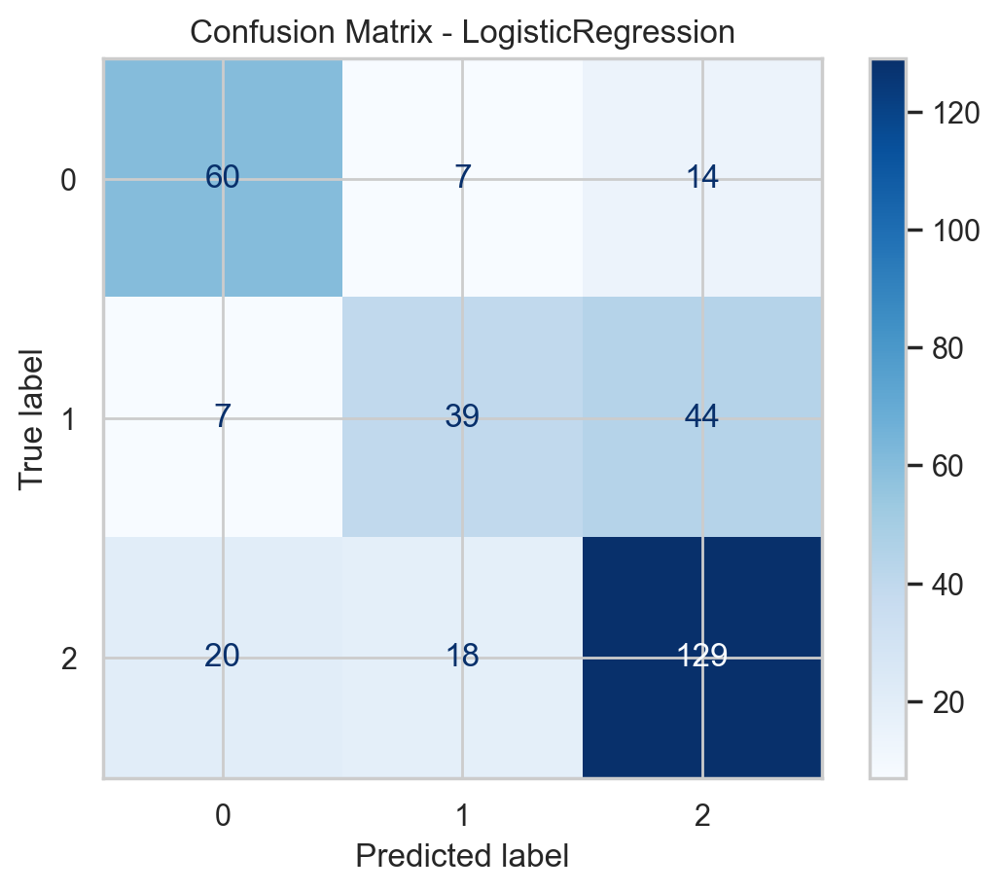


=== DecisionTree ===
              precision    recall  f1-score   support

           0       0.72      0.65      0.68        81
           1       0.74      0.80      0.77        90
           2       0.84      0.84      0.84       167

    accuracy                           0.79       338
   macro avg       0.77      0.77      0.77       338
weighted avg       0.79      0.79      0.79       338



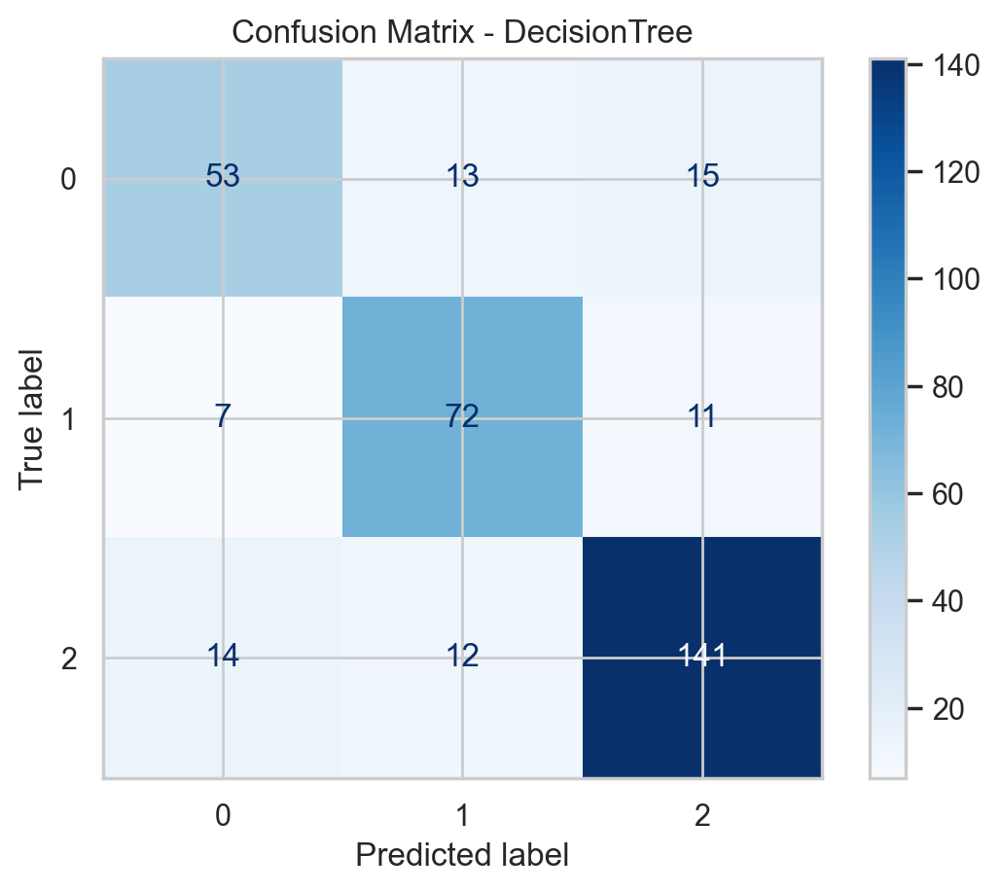


=== RandomForest ===
              precision    recall  f1-score   support

           0       0.90      0.89      0.89        81
           1       0.95      0.89      0.92        90
           2       0.93      0.96      0.94       167

    accuracy                           0.93       338
   macro avg       0.93      0.91      0.92       338
weighted avg       0.93      0.93      0.93       338



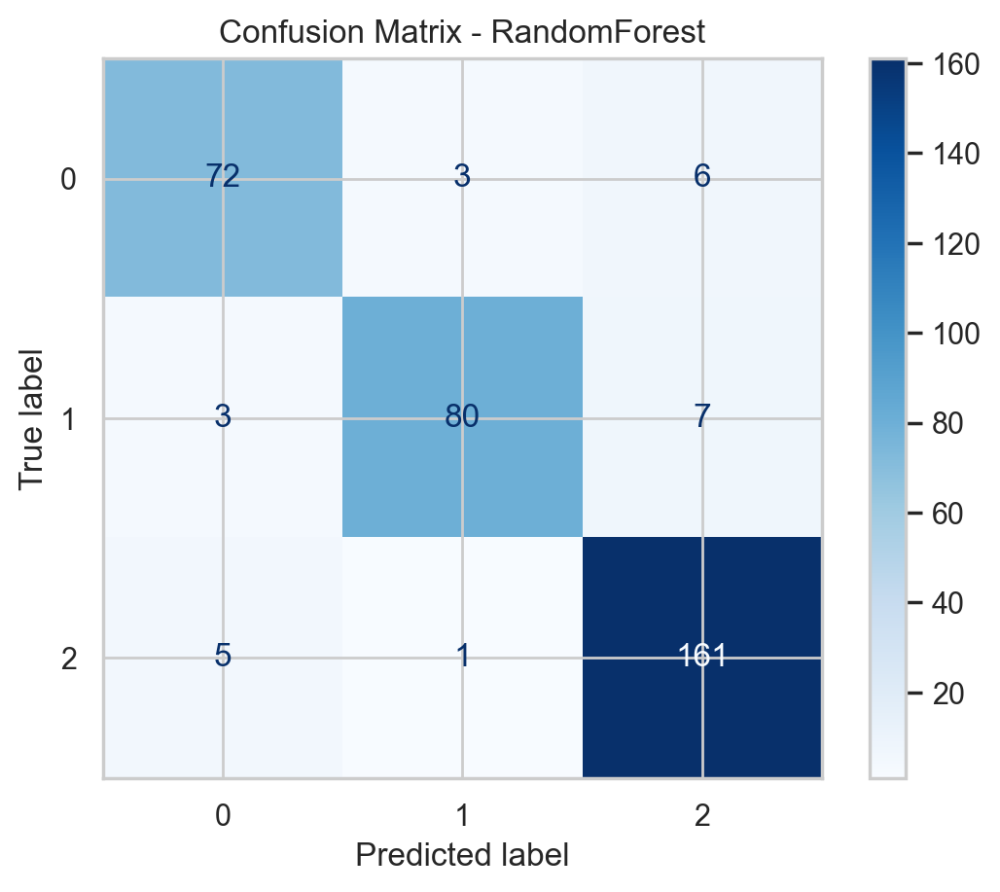


=== KNN ===
              precision    recall  f1-score   support

           0       0.87      0.90      0.88        81
           1       0.85      0.81      0.83        90
           2       0.89      0.90      0.90       167

    accuracy                           0.88       338
   macro avg       0.87      0.87      0.87       338
weighted avg       0.88      0.88      0.88       338



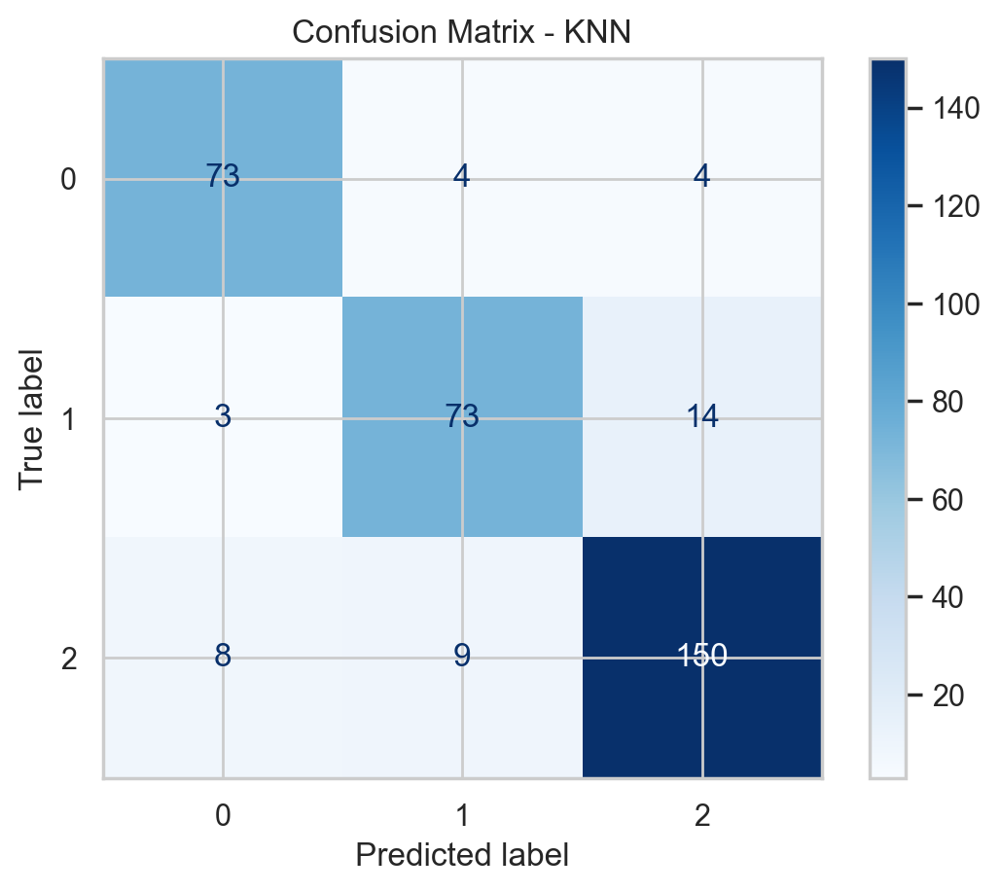


=== SVM ===
              precision    recall  f1-score   support

           0       0.95      0.91      0.93        81
           1       0.90      0.89      0.89        90
           2       0.93      0.95      0.94       167

    accuracy                           0.93       338
   macro avg       0.93      0.92      0.92       338
weighted avg       0.93      0.93      0.93       338



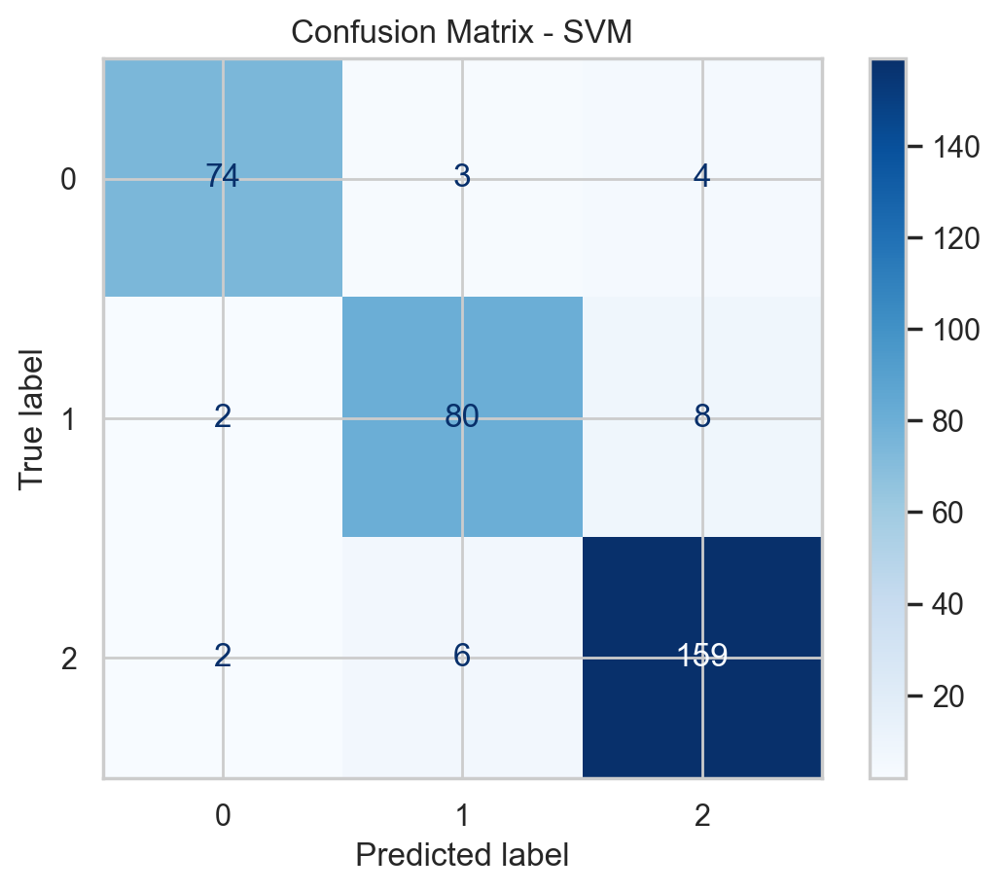


=== GaussianNB ===
              precision    recall  f1-score   support

           0       0.67      0.65      0.66        81
           1       0.43      0.70      0.53        90
           2       0.70      0.47      0.56       167

    accuracy                           0.57       338
   macro avg       0.60      0.61      0.58       338
weighted avg       0.62      0.57      0.58       338



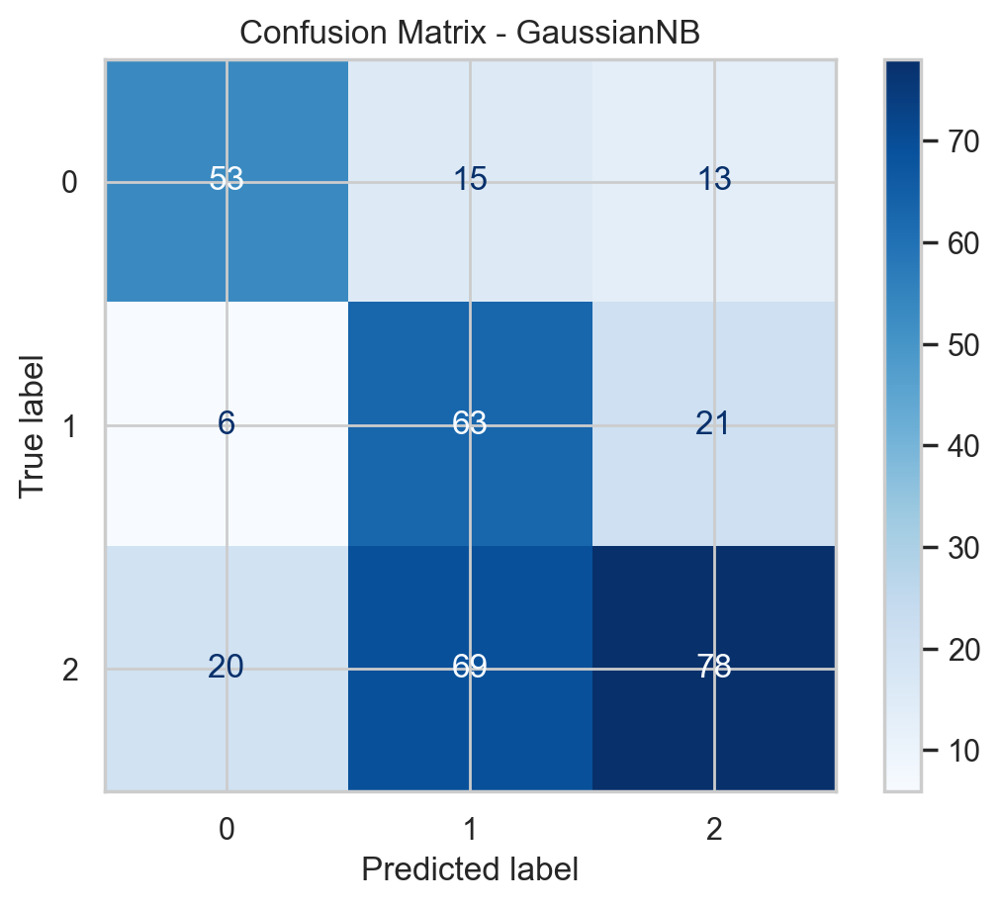


=== bagging ===
              precision    recall  f1-score   support

           0       0.88      0.85      0.87        81
           1       0.89      0.83      0.86        90
           2       0.89      0.93      0.91       167

    accuracy                           0.89       338
   macro avg       0.89      0.87      0.88       338
weighted avg       0.89      0.89      0.89       338



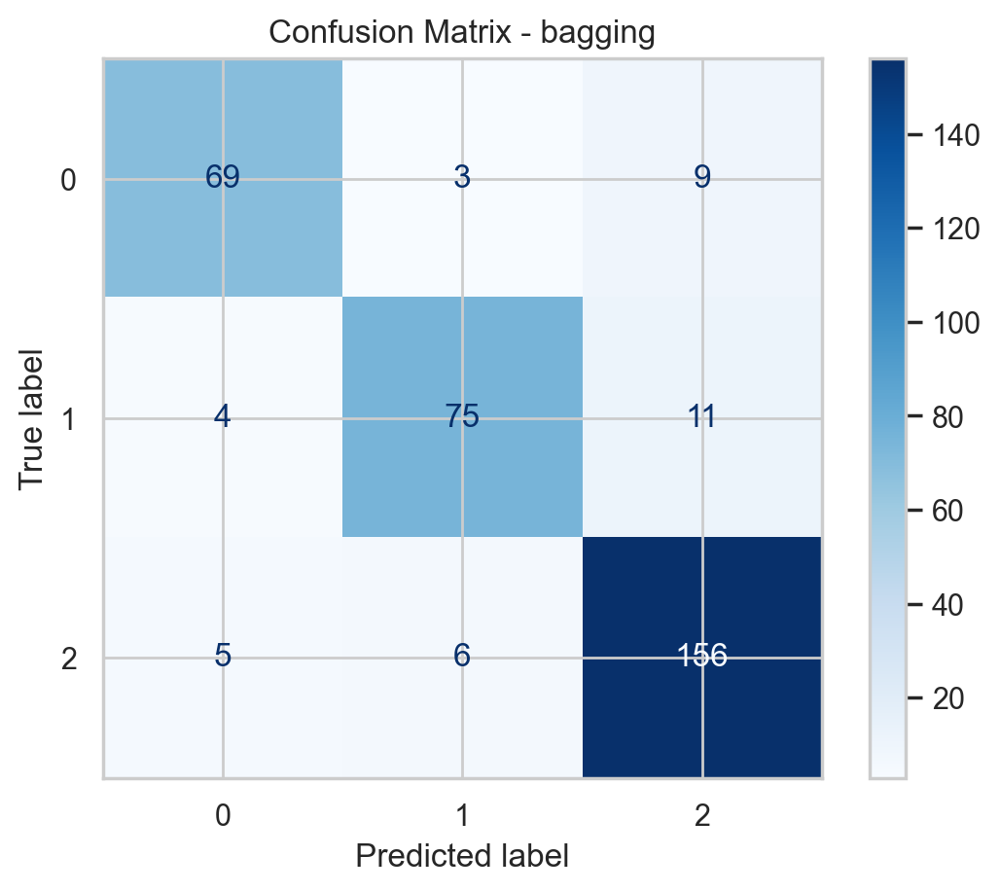


=== XGB ===
              precision    recall  f1-score   support

           0       0.89      0.93      0.91        81
           1       0.95      0.86      0.90        90
           2       0.93      0.96      0.95       167

    accuracy                           0.93       338
   macro avg       0.92      0.92      0.92       338
weighted avg       0.93      0.93      0.93       338



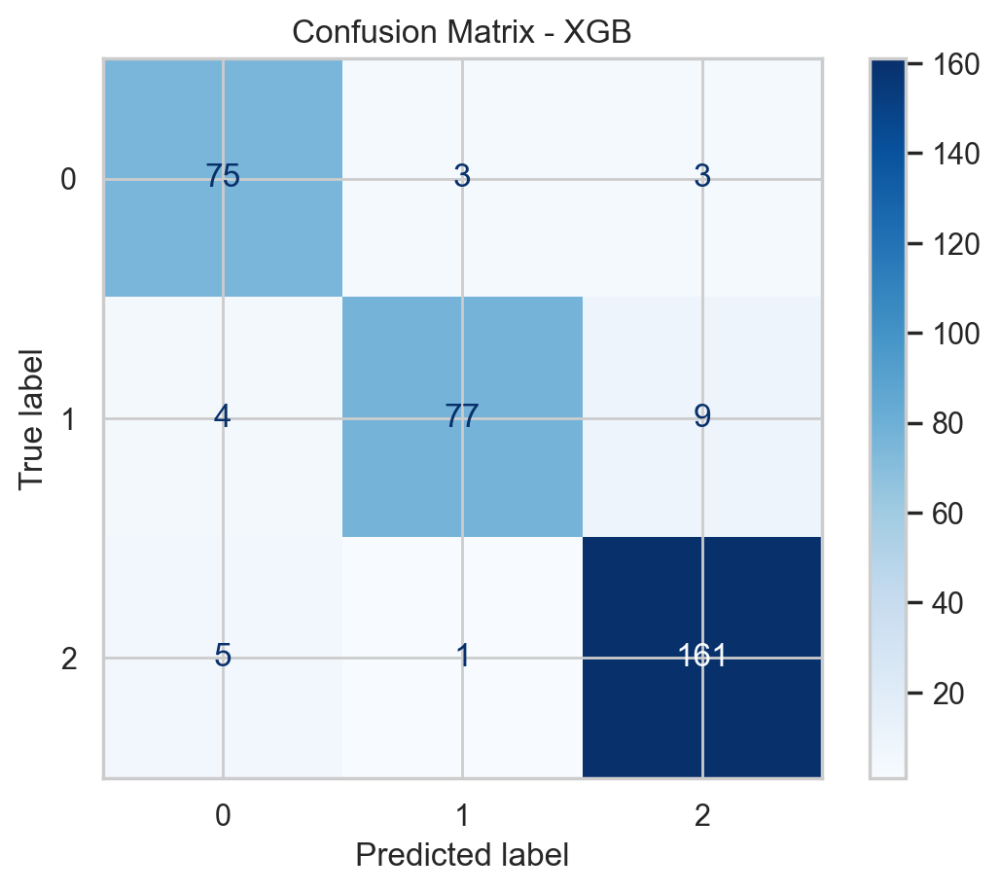


Accuracy summary: {'LogisticRegression': 0.6745562130177515, 'DecisionTree': 0.7869822485207101, 'RandomForest': 0.9260355029585798, 'KNN': 0.8757396449704142, 'SVM': 0.9260355029585798, 'GaussianNB': 0.5739644970414202, 'bagging': 0.8875739644970414, 'XGB': 0.9260355029585798}


In [106]:

# Train/test split on fused features and evaluation across models
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score

# Balance using SMOTEENN as earlier on the fused features
from imblearn.combine import SMOTEENN

smoteenn = SMOTEENN(random_state=42)
X_bal_fused, y_bal_fused = smoteenn.fit_resample(X_fused_all, y_labels)

X_train_f, X_test_f, y_train_f, y_test_f = train_test_split(
    X_bal_fused, y_bal_fused, test_size=0.2, random_state=42, stratify=y_bal_fused
)

print('Fused training set:', X_train_f.shape, 'Fused test set:', X_test_f.shape)

# Models to evaluate
models = {
    'LogisticRegression': LogisticRegression(max_iter=500, multi_class='auto'),
    'DecisionTree': DecisionTreeClassifier(random_state=42),
    'RandomForest': RandomForestClassifier(n_estimators=400, random_state=42),
    'KNN': KNeighborsClassifier(n_neighbors=8),
    'SVM': SVC(kernel='rbf', C=1.0, gamma='scale', probability=True, random_state=42),
    'GaussianNB': GaussianNB(),
    'bagging': BaggingClassifier(
    estimator=DecisionTreeClassifier(max_depth=10, random_state=42),  # Changed from base_estimator to estimator
    n_estimators=100,
    max_samples=1.0,
    max_features=1.0,
    bootstrap=True,
    bootstrap_features=False,
    random_state=42,
    n_jobs=-10),
    'XGB': XGBClassifier(
        n_estimators=300, learning_rate=0.08, max_depth=5, subsample=0.9,
        colsample_bytree=0.9, random_state=46, eval_metric='mlogloss'
    )
}

results = {}

for name, model in models.items():
    model.fit(X_train_f, y_train_f)
    y_pred = model.predict(X_test_f)
    acc = accuracy_score(y_test_f, y_pred)
    results[name] = acc
    print(f"\n=== {name} ===")
    print(classification_report(y_test_f, y_pred))
    cm = confusion_matrix(y_test_f, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm)
    disp.plot(cmap='Blues', values_format='d')
    plt.title(f'Confusion Matrix - {name}')
    plt.show()

print('\nAccuracy summary:', results)


read this code. random forest give high accuracy. Now add a feature importance diagram for random forest classifier considering the clinical_features and lifestyle_features

## Stratified K-Fold Cross-Validation on Weighted-Fusion Features
This section evaluates all proposed models using Stratified K-Fold CV on the fused features (`X_bal_fused`, `y_bal_fused`). It reports mean and std accuracy, plus optional ROC-AUC when available.


In [107]:
# Stratified K-Fold CV across proposed models on fused features (robust AUC computation)
import numpy as np
import pandas as pd
from sklearn.model_selection import StratifiedKFold, cross_validate
from sklearn.metrics import accuracy_score, roc_auc_score

# Locate fused features and labels
if 'X_bal_fused' in globals() and 'y_bal_fused' in globals():
    X_cv = X_bal_fused
    y_cv = y_bal_fused
elif 'X_fused_all' in globals() and 'y_labels' in globals():
    X_cv = X_fused_all
    y_cv = y_labels
else:
    raise RuntimeError("Fused feature matrices not found. Run fusion cells to create X_fused_all / X_bal_fused and y.")

X_cv = np.asarray(X_cv)
y_cv = np.asarray(y_cv)

# Build default models dict if not present
try:
    models  # noqa: F401
except NameError:
    from sklearn.ensemble import RandomForestClassifier, BaggingClassifier
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.neighbors import KNeighborsClassifier
    from sklearn.svm import SVC
    from sklearn.naive_bayes import GaussianNB
    try:
        from xgboost import XGBClassifier
        xgb_available = True
    except Exception:
        xgb_available = False

    models = {
        'RandomForest': RandomForestClassifier(n_estimators=300, random_state=42),
        'KNN': KNeighborsClassifier(n_neighbors=5),
        'SVM': SVC(kernel='rbf', C=1.0, gamma='scale', probability=True, random_state=42),
        'GaussianNB': GaussianNB(),
        'Bagging': BaggingClassifier(
            estimator=DecisionTreeClassifier(max_depth=10, random_state=42),
            n_estimators=100,
            random_state=42
        ),
    }
    if xgb_available:
        models['XGBoost'] = XGBClassifier(
            n_estimators=200, learning_rate=0.1, max_depth=4,
            subsample=0.9, colsample_bytree=0.9, reg_lambda=1.0,
            objective='multi:softprob' if len(np.unique(y_cv)) > 2 else 'binary:logistic',
            eval_metric='mlogloss',
            random_state=42
        )

# CV setup
n_splits = 5
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

def compute_cv_auc(estimator, X, y, skf):
    """Compute per-fold ROC-AUC robustly using predict_proba/decision_function if available."""
    aucs = []
    classes = np.unique(y)
    is_multiclass = len(classes) > 2

    for train_idx, test_idx in skf.split(X, y):
        X_tr, X_te = X[train_idx], X[test_idx]
        y_tr, y_te = y[train_idx], y[test_idx]

        est = estimator
        est.fit(X_tr, y_tr)

        y_score = None
        if hasattr(est, 'predict_proba'):
            proba = est.predict_proba(X_te)
            if is_multiclass:
                y_score = proba  # shape (n_samples, n_classes)
                auc = roc_auc_score(y_te, y_score, multi_class='ovo', average='macro')
            else:
                # use probability of positive class
                pos_index = 1 if proba.shape[1] > 1 else 0
                y_score = proba[:, pos_index]
                auc = roc_auc_score(y_te, y_score)
        elif hasattr(est, 'decision_function'):
            dec = est.decision_function(X_te)
            if is_multiclass:
                # shape (n_samples, n_classes)
                if dec.ndim == 1:
                    # unlikely for multiclass, skip AUC
                    auc = np.nan
                else:
                    auc = roc_auc_score(y_te, dec, multi_class='ovo', average='macro')
            else:
                # 1D scores
                auc = roc_auc_score(y_te, dec)
        else:
            auc = np.nan  # no scoring capability for AUC

        aucs.append(auc)

    # Filter out nans if any
    aucs = [a for a in aucs if not (a is None or (isinstance(a, float) and np.isnan(a)))]
    if len(aucs) == 0:
        return np.nan, np.nan
    return float(np.mean(aucs)), float(np.std(aucs))

rows = []
for name, est in models.items():
    cv_out = cross_validate(
        est, X_cv, y_cv,
        scoring={'accuracy': 'accuracy'},
        cv=skf,
        return_train_score=False,
        n_jobs=-1,
        error_score='raise'
    )
    acc_mean = float(np.mean(cv_out['test_accuracy']))
    acc_std = float(np.std(cv_out['test_accuracy']))

    auc_mean, auc_std = compute_cv_auc(est, X_cv, y_cv, skf)

    rows.append({
        'Model': name,
        'CV Acc Mean': acc_mean,
        'CV Acc Std': acc_std,
        'CV AUC(ovo) Mean': auc_mean if not np.isnan(auc_mean) else None,
        'CV AUC(ovo) Std': auc_std if not np.isnan(auc_std) else None,
    })

cv_df = pd.DataFrame(rows).sort_values(by=['CV Acc Mean'], ascending=False)
print("Stratified K-Fold (n_splits=5) Results on Fused Features:\n")
print(cv_df.to_string(index=False))

Stratified K-Fold (n_splits=5) Results on Fused Features:

             Model  CV Acc Mean  CV Acc Std  CV AUC(ovo) Mean  CV AUC(ovo) Std
      RandomForest     0.943195    0.012184          0.989793         0.004372
               XGB     0.943195    0.011133          0.989271         0.003723
               SVM     0.920118    0.016944          0.986467         0.004507
           bagging     0.907101    0.014077          0.982734         0.004381
               KNN     0.887574    0.013493          0.972970         0.006478
      DecisionTree     0.826627    0.033712          0.854453         0.028028
LogisticRegression     0.675740    0.014201          0.833994         0.012268
        GaussianNB     0.601183    0.021285          0.789587         0.017345


FIXED INDIVIDUAL FEATURE IMPORTANCE ANALYSIS
RANDOM FOREST & XGBOOST - WEIGHTED FEATURE FUSION
Using optimal fusion weights:
  Clinical weight: 1.4367
  Lifestyle weight: 1.9066

Actual number of features in training data: 22
Expected clinical features: 13
Expected lifestyle features: 4
Expected total features: 17
⚠️ Creating generic feature names based on actual data dimensions
Added 5 extra features

Weighted Feature Fusion Structure:
  Clinical features: 13
  Lifestyle features: 4
  Total fused features: 22

TRAINING MODELS FOR FEATURE IMPORTANCE ANALYSIS
Training Random Forest...
Training XGBoost...
✅ Both models trained successfully!

Dimension verification:
  Feature names length: 22
  Random Forest importances length: 22
  XGBoost importances length: 22

RANDOM FOREST FEATURE IMPORTANCE ANALYSIS
Random Forest Weighted Fusion Impact:
  Clinical features total importance: 0.6648
  Lifestyle features total importance: 0.3352
  Clinical/Lifestyle ratio: 1.98

Top 10 Most Important F

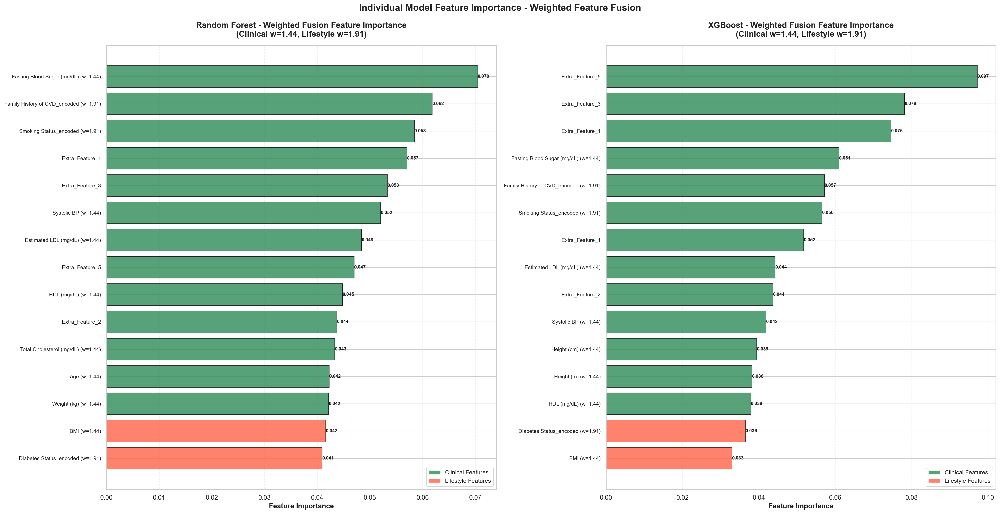


COMPARATIVE ANALYSIS: RANDOM FOREST vs XGBOOST
Correlation between Random Forest and XGBoost feature importances: 0.4937

Top 5 Features with Largest Importance Differences:
------------------------------------------------------------
Extra_Feature_5                          RF: 0.0470, XGB: 0.0972, Diff: 0.0502
Extra_Feature_4                          RF: 0.0391, XGB: 0.0746, Diff: 0.0355
Extra_Feature_3                          RF: 0.0533, XGB: 0.0782, Diff: 0.0249
Total Cholesterol (mg/dL)                RF: 0.0433, XGB: 0.0288, Diff: 0.0145
Age                                      RF: 0.0423, XGB: 0.0297, Diff: 0.0125

Top 5 Features with Largest Ranking Differences:
------------------------------------------------------------
Extra_Feature_4                          RF Rank: 17, XGB Rank: 3, Rank Diff: 14
Total Cholesterol (mg/dL)                RF Rank: 11, XGB Rank: 21, Rank Diff: 10
Height (m)                               RF Rank: 22, XGB Rank: 12, Rank Diff: 10
Height (cm)  

In [108]:
# FIXED INDIVIDUAL FEATURE IMPORTANCE FOR RANDOM FOREST AND XGBOOST
# Weighted Feature Fusion Analysis - Fixed Version
print("=" * 80)
print("FIXED INDIVIDUAL FEATURE IMPORTANCE ANALYSIS")
print("RANDOM FOREST & XGBOOST - WEIGHTED FEATURE FUSION")
print("=" * 80)

# Get the optimal weights from the fusion process
if 'best_fusion_params' in globals():
    best_w_c = best_fusion_params['weight_clinical']
    best_w_l = best_fusion_params['weight_lifestyle']
    print(f"Using optimal fusion weights:")
    print(f"  Clinical weight: {best_w_c:.4f}")
    print(f"  Lifestyle weight: {best_w_l:.4f}")
else:
    # Fallback weights if not available
    best_w_c = 1.0
    best_w_l = 1.0
    print("Using default weights (clinical=1.0, lifestyle=1.0)")

# Define feature groups (aligned with existing code)
clinical_features = [
    'Age', 'BMI', 'Abdominal Circumference (cm)',
    'Total Cholesterol (mg/dL)', 'HDL (mg/dL)', 'Estimated LDL (mg/dL)',
    'Fasting Blood Sugar (mg/dL)', 'Systolic BP', 'Diastolic BP',
    'Waist-to-Height Ratio', 'Height (cm)', 'Height (m)', 'Weight (kg)'
]

lifestyle_features = [
    'Physical Activity Level_encoded', 'Smoking Status_encoded',
    'Diabetes Status_encoded', 
    'Family History of CVD_encoded'
]

# Get actual number of features from training data
actual_num_features = X_train_f.shape[1]
print(f"\nActual number of features in training data: {actual_num_features}")
print(f"Expected clinical features: {len(clinical_features)}")
print(f"Expected lifestyle features: {len(lifestyle_features)}")
print(f"Expected total features: {len(clinical_features) + len(lifestyle_features)}")

# Create feature names based on actual training data dimensions
if actual_num_features == len(clinical_features) + len(lifestyle_features):
    # Use the predefined feature names
    weighted_clinical_names = [f"{feat} (w={best_w_c:.2f})" for feat in clinical_features]
    weighted_lifestyle_names = [f"{feat} (w={best_w_l:.2f})" for feat in lifestyle_features]
    feature_names = weighted_clinical_names + weighted_lifestyle_names
    print("✅ Using predefined feature names")
else:
    # Create generic feature names based on actual dimensions
    print("⚠️ Creating generic feature names based on actual data dimensions")
    
    # Create weighted feature names
    weighted_clinical_names = [f"{feat} (w={best_w_c:.2f})" for feat in clinical_features]
    weighted_lifestyle_names = [f"{feat} (w={best_w_l:.2f})" for feat in lifestyle_features]
    feature_names = weighted_clinical_names + weighted_lifestyle_names
    
    # Ensure we have exactly the right number of features
    if len(feature_names) != actual_num_features:
        # Pad or truncate as needed
        if len(feature_names) < actual_num_features:
            extra_needed = actual_num_features - len(feature_names)
            feature_names.extend([f"Extra_Feature_{i+1}" for i in range(extra_needed)])
            print(f"Added {extra_needed} extra features")
        else:
            feature_names = feature_names[:actual_num_features]
            print(f"Truncated to {actual_num_features} features")

print(f"\nWeighted Feature Fusion Structure:")
print(f"  Clinical features: {len([f for f in feature_names if any(cf in f for cf in clinical_features)])}")
print(f"  Lifestyle features: {len([f for f in feature_names if any(lf in f for lf in lifestyle_features)])}")
print(f"  Total fused features: {len(feature_names)}")

# Extract specific models from the models dictionary
rf_model = models['RandomForest']
xgb_model = models['XGB']

print(f"\n{'='*60}")
print("TRAINING MODELS FOR FEATURE IMPORTANCE ANALYSIS")
print(f"{'='*60}")

# Train Random Forest
print("Training Random Forest...")
rf_model.fit(X_train_f, y_train_f)
rf_importances = rf_model.feature_importances_

# Train XGBoost
print("Training XGBoost...")
xgb_model.fit(X_train_f, y_train_f)
xgb_importances = xgb_model.feature_importances_

print("✅ Both models trained successfully!")

# Verify dimensions match
print(f"\nDimension verification:")
print(f"  Feature names length: {len(feature_names)}")
print(f"  Random Forest importances length: {len(rf_importances)}")
print(f"  XGBoost importances length: {len(xgb_importances)}")

# Create individual plots for each model
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 12))

# ========================================
# RANDOM FOREST FEATURE IMPORTANCE
# ========================================
print(f"\n{'='*60}")
print("RANDOM FOREST FEATURE IMPORTANCE ANALYSIS")
print(f"{'='*60}")

# Create dataframe for Random Forest
rf_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': rf_importances
}).sort_values('Importance', ascending=False)

# Separate clinical vs lifestyle importance for RF
# Count clinical features dynamically
clinical_feature_count = len([f for f in feature_names if any(cf in f for cf in clinical_features)])
rf_clinical_importance = rf_importance_df.iloc[:clinical_feature_count]['Importance'].sum()
rf_lifestyle_importance = rf_importance_df.iloc[clinical_feature_count:]['Importance'].sum()

print(f"Random Forest Weighted Fusion Impact:")
print(f"  Clinical features total importance: {rf_clinical_importance:.4f}")
print(f"  Lifestyle features total importance: {rf_lifestyle_importance:.4f}")
print(f"  Clinical/Lifestyle ratio: {rf_clinical_importance/rf_lifestyle_importance:.2f}")

print(f"\nTop 10 Most Important Features for Random Forest:")
print("-" * 60)
for i, row in rf_importance_df.head(10).iterrows():
    print(f"{row['Feature']:<50s} {row['Importance']:.4f}")

# Plot Random Forest importance
top_n = min(15, len(feature_names))
colors_rf = []
for i in range(top_n):
    if i < clinical_feature_count:
        colors_rf.append('#2E8B57')  # Sea Green for clinical
    else:
        colors_rf.append('#FF6347')  # Tomato for lifestyle

bars_rf = ax1.barh(range(top_n), rf_importance_df['Importance'].head(top_n), 
                  color=colors_rf, edgecolor='black', linewidth=0.8, alpha=0.8)
ax1.set_yticks(range(top_n))
ax1.set_yticklabels(rf_importance_df['Feature'].head(top_n), fontsize=9)
ax1.set_xlabel('Feature Importance', fontsize=12, fontweight='bold')
ax1.set_title(f'Random Forest - Weighted Fusion Feature Importance\n(Clinical w={best_w_c:.2f}, Lifestyle w={best_w_l:.2f})', 
              fontsize=14, fontweight='bold', pad=15)
ax1.invert_yaxis()
ax1.grid(axis='x', alpha=0.3, linestyle='--')

# Add value labels on bars for RF
for i, bar in enumerate(bars_rf):
    width = bar.get_width()
    ax1.text(width, bar.get_y() + bar.get_height()/2, 
            f'{width:.3f}', 
            ha='left', va='center', fontsize=8, fontweight='bold')

# Add legend for RF
from matplotlib.patches import Patch
legend_elements_rf = [Patch(facecolor='#2E8B57', alpha=0.8, label='Clinical Features'),
                     Patch(facecolor='#FF6347', alpha=0.8, label='Lifestyle Features')]
ax1.legend(handles=legend_elements_rf, loc='lower right', fontsize=10)

# ========================================
# XGBOOST FEATURE IMPORTANCE
# ========================================
print(f"\n{'='*60}")
print("XGBOOST FEATURE IMPORTANCE ANALYSIS")
print(f"{'='*60}")

# Create dataframe for XGBoost
xgb_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': xgb_importances
}).sort_values('Importance', ascending=False)

# Separate clinical vs lifestyle importance for XGB
xgb_clinical_importance = xgb_importance_df.iloc[:clinical_feature_count]['Importance'].sum()
xgb_lifestyle_importance = xgb_importance_df.iloc[clinical_feature_count:]['Importance'].sum()

print(f"XGBoost Weighted Fusion Impact:")
print(f"  Clinical features total importance: {xgb_clinical_importance:.4f}")
print(f"  Lifestyle features total importance: {xgb_lifestyle_importance:.4f}")
print(f"  Clinical/Lifestyle ratio: {xgb_clinical_importance/xgb_lifestyle_importance:.2f}")

print(f"\nTop 10 Most Important Features for XGBoost:")
print("-" * 60)
for i, row in xgb_importance_df.head(10).iterrows():
    print(f"{row['Feature']:<50s} {row['Importance']:.4f}")

# Plot XGBoost importance
colors_xgb = []
for i in range(top_n):
    if i < clinical_feature_count:
        colors_xgb.append('#2E8B57')  # Sea Green for clinical
    else:
        colors_xgb.append('#FF6347')  # Tomato for lifestyle

bars_xgb = ax2.barh(range(top_n), xgb_importance_df['Importance'].head(top_n), 
                   color=colors_xgb, edgecolor='black', linewidth=0.8, alpha=0.8)
ax2.set_yticks(range(top_n))
ax2.set_yticklabels(xgb_importance_df['Feature'].head(top_n), fontsize=9)
ax2.set_xlabel('Feature Importance', fontsize=12, fontweight='bold')
ax2.set_title(f'XGBoost - Weighted Fusion Feature Importance\n(Clinical w={best_w_c:.2f}, Lifestyle w={best_w_l:.2f})', 
              fontsize=14, fontweight='bold', pad=15)
ax2.invert_yaxis()
ax2.grid(axis='x', alpha=0.3, linestyle='--')

# Add value labels on bars for XGB
for i, bar in enumerate(bars_xgb):
    width = bar.get_width()
    ax2.text(width, bar.get_y() + bar.get_height()/2, 
            f'{width:.3f}', 
            ha='left', va='center', fontsize=8, fontweight='bold')

# Add legend for XGB
legend_elements_xgb = [Patch(facecolor='#2E8B57', alpha=0.8, label='Clinical Features'),
                      Patch(facecolor='#FF6347', alpha=0.8, label='Lifestyle Features')]
ax2.legend(handles=legend_elements_xgb, loc='lower right', fontsize=10)

plt.tight_layout()
plt.suptitle('Individual Model Feature Importance - Weighted Feature Fusion', 
             fontsize=16, fontweight='bold', y=1.02)
plt.show()

# ========================================
# COMPARATIVE ANALYSIS
# ========================================
print(f"\n{'='*60}")
print("COMPARATIVE ANALYSIS: RANDOM FOREST vs XGBOOST")
print(f"{'='*60}")

# Create comparison dataframe
comparison_df = pd.DataFrame({
    'Feature': feature_names,
    'RandomForest': rf_importances,
    'XGBoost': xgb_importances
})

# Calculate correlation between model importances
correlation = comparison_df['RandomForest'].corr(comparison_df['XGBoost'])
print(f"Correlation between Random Forest and XGBoost feature importances: {correlation:.4f}")

# Find features where models disagree most
comparison_df['Difference'] = abs(comparison_df['RandomForest'] - comparison_df['XGBoost'])
comparison_df['RF_Rank'] = comparison_df['RandomForest'].rank(ascending=False)
comparison_df['XGB_Rank'] = comparison_df['XGBoost'].rank(ascending=False)
comparison_df['Rank_Diff'] = abs(comparison_df['RF_Rank'] - comparison_df['XGB_Rank'])

print(f"\nTop 5 Features with Largest Importance Differences:")
print("-" * 60)
top_diff = comparison_df.nlargest(5, 'Difference')
for _, row in top_diff.iterrows():
    feature_base = row['Feature'].split(' (w=')[0]
    print(f"{feature_base:<40s} RF: {row['RandomForest']:.4f}, XGB: {row['XGBoost']:.4f}, Diff: {row['Difference']:.4f}")

print(f"\nTop 5 Features with Largest Ranking Differences:")
print("-" * 60)
top_rank_diff = comparison_df.nlargest(5, 'Rank_Diff')
for _, row in top_rank_diff.iterrows():
    feature_base = row['Feature'].split(' (w=')[0]
    print(f"{feature_base:<40s} RF Rank: {int(row['RF_Rank'])}, XGB Rank: {int(row['XGB_Rank'])}, Rank Diff: {int(row['Rank_Diff'])}")

# Summary statistics
print(f"\n{'='*60}")
print("SUMMARY STATISTICS")
print(f"{'='*60}")

print(f"\nRandom Forest:")
print(f"  Most important feature: {rf_importance_df.iloc[0]['Feature'].split(' (w=')[0]} ({rf_importance_df.iloc[0]['Importance']:.4f})")
print(f"  Clinical features dominance: {rf_clinical_importance:.4f}")
print(f"  Lifestyle features dominance: {rf_lifestyle_importance:.4f}")

print(f"\nXGBoost:")
print(f"  Most important feature: {xgb_importance_df.iloc[0]['Feature'].split(' (w=')[0]} ({xgb_importance_df.iloc[0]['Importance']:.4f})")
print(f"  Clinical features dominance: {xgb_clinical_importance:.4f}")
print(f"  Lifestyle features dominance: {xgb_lifestyle_importance:.4f}")

print(f"\nWeighted Fusion Impact:")
print(f"  Clinical weight applied: {best_w_c:.4f}")
print(f"  Lifestyle weight applied: {best_w_l:.4f}")
print(f"  Weight ratio (Clinical/Lifestyle): {best_w_c/best_w_l:.2f}")

print("\n✅ Fixed Individual Feature Importance Analysis Completed!")


HIGH-RESOLUTION INDIVIDUAL FEATURE IMPORTANCE ANALYSIS
RANDOM FOREST & XGBOOST - WEIGHTED FEATURE FUSION
Using optimal fusion weights:
  Clinical weight: 1.4367
  Lifestyle weight: 1.9066

Actual number of features in training data: 22
Expected clinical features: 13
Expected lifestyle features: 4
Expected total features: 17
⚠️ Creating generic feature names based on actual data dimensions
Added 5 extra features

Weighted Feature Fusion Structure:
  Clinical features: 13
  Lifestyle features: 4
  Total fused features: 22

TRAINING MODELS FOR FEATURE IMPORTANCE ANALYSIS
Training Random Forest...
Training XGBoost...
✅ Both models trained successfully!

Dimension verification:
  Feature names length: 22
  Random Forest importances length: 22
  XGBoost importances length: 22

RANDOM FOREST FEATURE IMPORTANCE ANALYSIS
Random Forest Weighted Fusion Impact:
  Clinical features total importance: 0.6648
  Lifestyle features total importance: 0.3352
  Clinical/Lifestyle ratio: 1.98

Top 10 Most I

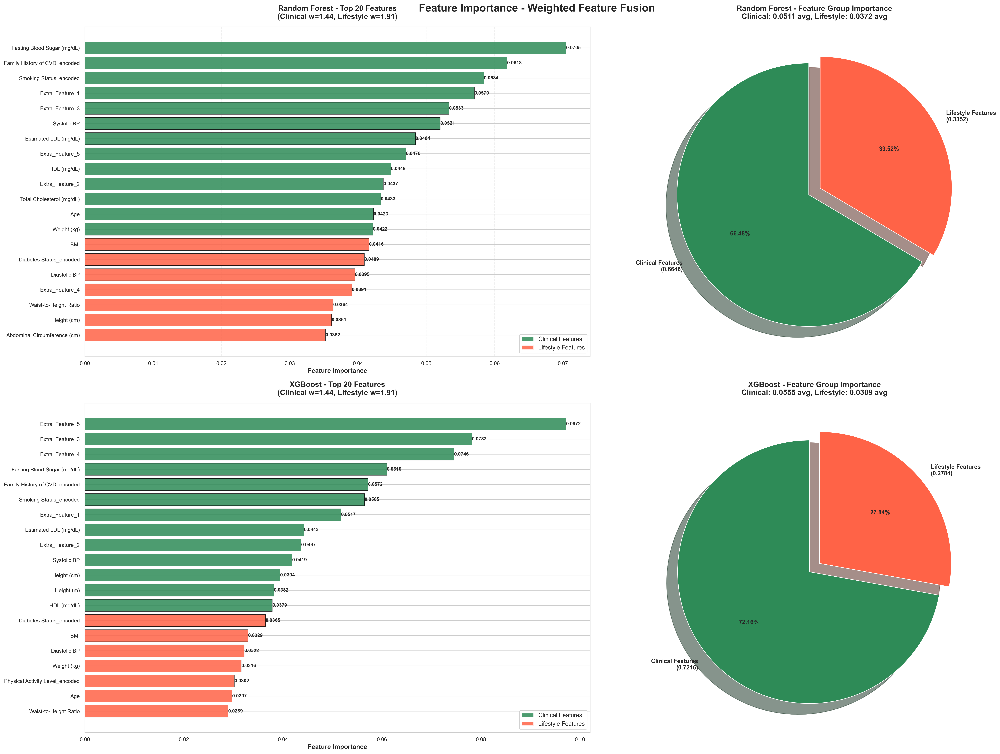


HIGH-RESOLUTION COMPARATIVE ANALYSIS


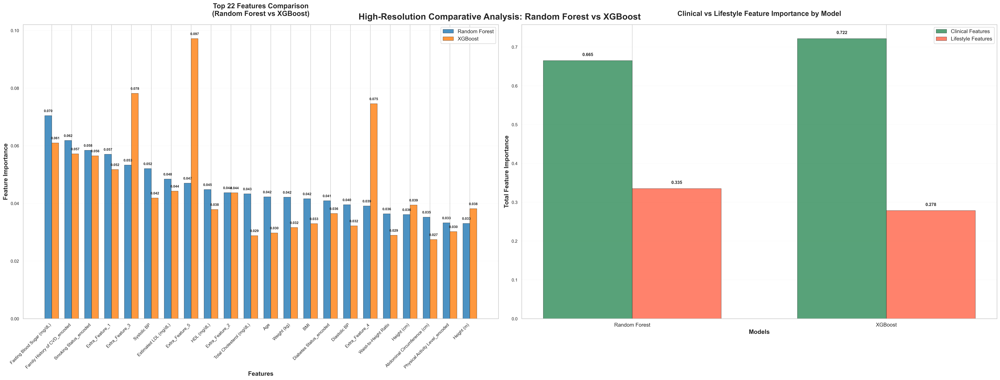


DETAILED STATISTICAL ANALYSIS
Correlation between Random Forest and XGBoost feature importances: 0.493675

Top 10 Features with Largest Importance Differences:
----------------------------------------------------------------------
Extra_Feature_5                               RF: 0.047009, XGB: 0.097180, Diff: 0.050170
Extra_Feature_4                               RF: 0.039086, XGB: 0.074585, Diff: 0.035499
Extra_Feature_3                               RF: 0.053312, XGB: 0.078177, Diff: 0.024865
Total Cholesterol (mg/dL)                     RF: 0.043323, XGB: 0.028803, Diff: 0.014520
Age                                           RF: 0.042270, XGB: 0.029745, Diff: 0.012525
Weight (kg)                                   RF: 0.042156, XGB: 0.031611, Diff: 0.010546
Systolic BP                                   RF: 0.052051, XGB: 0.041863, Diff: 0.010188
Fasting Blood Sugar (mg/dL)                   RF: 0.070453, XGB: 0.060981, Diff: 0.009472
BMI                                           RF

In [109]:
# HIGH-RESOLUTION INDIVIDUAL FEATURE IMPORTANCE FOR RANDOM FOREST AND XGBOOST
# Weighted Feature Fusion Analysis - High Resolution Version
print("=" * 80)
print("HIGH-RESOLUTION INDIVIDUAL FEATURE IMPORTANCE ANALYSIS")
print("RANDOM FOREST & XGBOOST - WEIGHTED FEATURE FUSION")
print("=" * 80)

# Set high DPI for better resolution
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300
plt.rcParams['font.size'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10
plt.rcParams['legend.fontsize'] = 11

# Get the optimal weights from the fusion process
if 'best_fusion_params' in globals():
    best_w_c = best_fusion_params['weight_clinical']
    best_w_l = best_fusion_params['weight_lifestyle']
    print(f"Using optimal fusion weights:")
    print(f"  Clinical weight: {best_w_c:.4f}")
    print(f"  Lifestyle weight: {best_w_l:.4f}")
else:
    # Fallback weights if not available
    best_w_c = 1.0
    best_w_l = 1.0
    print("Using default weights (clinical=1.0, lifestyle=1.0)")

# Define feature groups (aligned with existing code)
clinical_features = [
    'Age', 'BMI', 'Abdominal Circumference (cm)',
    'Total Cholesterol (mg/dL)', 'HDL (mg/dL)', 'Estimated LDL (mg/dL)',
    'Fasting Blood Sugar (mg/dL)', 'Systolic BP', 'Diastolic BP',
    'Waist-to-Height Ratio', 'Height (cm)', 'Height (m)', 'Weight (kg)'
]

lifestyle_features = [
    'Physical Activity Level_encoded', 'Smoking Status_encoded',
    'Diabetes Status_encoded', 
    'Family History of CVD_encoded'
]

# Get actual number of features from training data
actual_num_features = X_train_f.shape[1]
print(f"\nActual number of features in training data: {actual_num_features}")
print(f"Expected clinical features: {len(clinical_features)}")
print(f"Expected lifestyle features: {len(lifestyle_features)}")
print(f"Expected total features: {len(clinical_features) + len(lifestyle_features)}")

# Create feature names based on actual training data dimensions
if actual_num_features == len(clinical_features) + len(lifestyle_features):
    # Use the predefined feature names
    weighted_clinical_names = [f"{feat} (w={best_w_c:.2f})" for feat in clinical_features]
    weighted_lifestyle_names = [f"{feat} (w={best_w_l:.2f})" for feat in lifestyle_features]
    feature_names = weighted_clinical_names + weighted_lifestyle_names
    print("✅ Using predefined feature names")
else:
    # Create generic feature names based on actual dimensions
    print("⚠️ Creating generic feature names based on actual data dimensions")
    
    # Create weighted feature names
    weighted_clinical_names = [f"{feat} (w={best_w_c:.2f})" for feat in clinical_features]
    weighted_lifestyle_names = [f"{feat} (w={best_w_l:.2f})" for feat in lifestyle_features]
    feature_names = weighted_clinical_names + weighted_lifestyle_names
    
    # Ensure we have exactly the right number of features
    if len(feature_names) != actual_num_features:
        # Pad or truncate as needed
        if len(feature_names) < actual_num_features:
            extra_needed = actual_num_features - len(feature_names)
            feature_names.extend([f"Extra_Feature_{i+1}" for i in range(extra_needed)])
            print(f"Added {extra_needed} extra features")
        else:
            feature_names = feature_names[:actual_num_features]
            print(f"Truncated to {actual_num_features} features")

print(f"\nWeighted Feature Fusion Structure:")
print(f"  Clinical features: {len([f for f in feature_names if any(cf in f for cf in clinical_features)])}")
print(f"  Lifestyle features: {len([f for f in feature_names if any(lf in f for lf in lifestyle_features)])}")
print(f"  Total fused features: {len(feature_names)}")

# Extract specific models from the models dictionary
rf_model = models['RandomForest']
xgb_model = models['XGB']

print(f"\n{'='*60}")
print("TRAINING MODELS FOR FEATURE IMPORTANCE ANALYSIS")
print(f"{'='*60}")

# Train Random Forest
print("Training Random Forest...")
rf_model.fit(X_train_f, y_train_f)
rf_importances = rf_model.feature_importances_

# Train XGBoost
print("Training XGBoost...")
xgb_model.fit(X_train_f, y_train_f)
xgb_importances = xgb_model.feature_importances_

print("✅ Both models trained successfully!")

# Verify dimensions match
print(f"\nDimension verification:")
print(f"  Feature names length: {len(feature_names)}")
print(f"  Random Forest importances length: {len(rf_importances)}")
print(f"  XGBoost importances length: {len(xgb_importances)}")

# ========================================
# HIGH-RESOLUTION INDIVIDUAL PLOTS
# ========================================

# Create high-resolution individual plots for each model
fig, axes = plt.subplots(2, 2, figsize=(28, 20), dpi=300)
fig.suptitle(' Feature Importance - Weighted Feature Fusion', 
             fontsize=20, fontweight='bold', y=0.98)

# ========================================
# RANDOM FOREST FEATURE IMPORTANCE
# ========================================
print(f"\n{'='*60}")
print("RANDOM FOREST FEATURE IMPORTANCE ANALYSIS")
print(f"{'='*60}")

# Create dataframe for Random Forest
rf_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': rf_importances
}).sort_values('Importance', ascending=False)

# Separate clinical vs lifestyle importance for RF
clinical_feature_count = len([f for f in feature_names if any(cf in f for cf in clinical_features)])
rf_clinical_importance = rf_importance_df.iloc[:clinical_feature_count]['Importance'].sum()
rf_lifestyle_importance = rf_importance_df.iloc[clinical_feature_count:]['Importance'].sum()

print(f"Random Forest Weighted Fusion Impact:")
print(f"  Clinical features total importance: {rf_clinical_importance:.4f}")
print(f"  Lifestyle features total importance: {rf_lifestyle_importance:.4f}")
print(f"  Clinical/Lifestyle ratio: {rf_clinical_importance/rf_lifestyle_importance:.2f}")

print(f"\nTop 10 Most Important Features for Random Forest:")
print("-" * 60)
for i, row in rf_importance_df.head(10).iterrows():
    print(f"{row['Feature']:<50s} {row['Importance']:.4f}")

# Plot 1: Random Forest - Top Features
ax1 = axes[0, 0]
top_n = min(20, len(feature_names))  # Show more features for high resolution
colors_rf = []
for i in range(top_n):
    if i < clinical_feature_count:
        colors_rf.append('#2E8B57')  # Sea Green for clinical
    else:
        colors_rf.append('#FF6347')  # Tomato for lifestyle

bars_rf = ax1.barh(range(top_n), rf_importance_df['Importance'].head(top_n), 
                  color=colors_rf, edgecolor='black', linewidth=0.5, alpha=0.85)
ax1.set_yticks(range(top_n))
ax1.set_yticklabels([feat.split(' (w=')[0] for feat in rf_importance_df['Feature'].head(top_n)], 
                   fontsize=10)
ax1.set_xlabel('Feature Importance', fontsize=12, fontweight='bold')
ax1.set_title(f'Random Forest - Top {top_n} Features\n(Clinical w={best_w_c:.2f}, Lifestyle w={best_w_l:.2f})', 
              fontsize=14, fontweight='bold', pad=15)
ax1.invert_yaxis()
ax1.grid(axis='x', alpha=0.3, linestyle='--', linewidth=0.5)

# Add value labels on bars for RF
for i, bar in enumerate(bars_rf):
    width = bar.get_width()
    ax1.text(width, bar.get_y() + bar.get_height()/2, 
            f'{width:.4f}', 
            ha='left', va='center', fontsize=9, fontweight='bold')

# Add legend for RF
from matplotlib.patches import Patch
legend_elements_rf = [Patch(facecolor='#2E8B57', alpha=0.85, label='Clinical Features'),
                     Patch(facecolor='#FF6347', alpha=0.85, label='Lifestyle Features')]
ax1.legend(handles=legend_elements_rf, loc='lower right', fontsize=11, framealpha=0.9)

# Plot 2: Random Forest - Clinical vs Lifestyle Pie Chart
ax2 = axes[0, 1]
clinical_count = len([f for f in feature_names if any(cf in f for cf in clinical_features)])
lifestyle_count = len(feature_names) - clinical_count

# Calculate average importance per feature type
rf_clinical_avg = rf_clinical_importance / clinical_count if clinical_count > 0 else 0
rf_lifestyle_avg = rf_lifestyle_importance / lifestyle_count if lifestyle_count > 0 else 0

sizes = [rf_clinical_importance, rf_lifestyle_importance]
labels = [f'Clinical Features\n({rf_clinical_importance:.4f})', 
          f'Lifestyle Features\n({rf_lifestyle_importance:.4f})']
colors = ['#2E8B57', '#FF6347']
explode = (0.05, 0.05)  # Slightly separate the wedges

wedges, texts, autotexts = ax2.pie(sizes, explode=explode, labels=labels, colors=colors,
                                  autopct='%1.2f%%', shadow=True, startangle=90,
                                  textprops={'fontsize': 11, 'fontweight': 'bold'})
ax2.set_title(f'Random Forest - Feature Group Importance\nClinical: {rf_clinical_avg:.4f} avg, Lifestyle: {rf_lifestyle_avg:.4f} avg', 
              fontsize=14, fontweight='bold', pad=15)

# ========================================
# XGBOOST FEATURE IMPORTANCE
# ========================================
print(f"\n{'='*60}")
print("XGBOOST FEATURE IMPORTANCE ANALYSIS")
print(f"{'='*60}")

# Create dataframe for XGBoost
xgb_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': xgb_importances
}).sort_values('Importance', ascending=False)

# Separate clinical vs lifestyle importance for XGB
xgb_clinical_importance = xgb_importance_df.iloc[:clinical_feature_count]['Importance'].sum()
xgb_lifestyle_importance = xgb_importance_df.iloc[clinical_feature_count:]['Importance'].sum()

print(f"XGBoost Weighted Fusion Impact:")
print(f"  Clinical features total importance: {xgb_clinical_importance:.4f}")
print(f"  Lifestyle features total importance: {xgb_lifestyle_importance:.4f}")
print(f"  Clinical/Lifestyle ratio: {xgb_clinical_importance/xgb_lifestyle_importance:.2f}")

print(f"\nTop 10 Most Important Features for XGBoost:")
print("-" * 60)
for i, row in xgb_importance_df.head(10).iterrows():
    print(f"{row['Feature']:<50s} {row['Importance']:.4f}")

# Plot 3: XGBoost - Top Features
ax3 = axes[1, 0]
colors_xgb = []
for i in range(top_n):
    if i < clinical_feature_count:
        colors_xgb.append('#2E8B57')  # Sea Green for clinical
    else:
        colors_xgb.append('#FF6347')  # Tomato for lifestyle

bars_xgb = ax3.barh(range(top_n), xgb_importance_df['Importance'].head(top_n), 
                   color=colors_xgb, edgecolor='black', linewidth=0.5, alpha=0.85)
ax3.set_yticks(range(top_n))
ax3.set_yticklabels([feat.split(' (w=')[0] for feat in xgb_importance_df['Feature'].head(top_n)], 
                   fontsize=10)
ax3.set_xlabel('Feature Importance', fontsize=12, fontweight='bold')
ax3.set_title(f'XGBoost - Top {top_n} Features\n(Clinical w={best_w_c:.2f}, Lifestyle w={best_w_l:.2f})', 
              fontsize=14, fontweight='bold', pad=15)
ax3.invert_yaxis()
ax3.grid(axis='x', alpha=0.3, linestyle='--', linewidth=0.5)

# Add value labels on bars for XGB
for i, bar in enumerate(bars_xgb):
    width = bar.get_width()
    ax3.text(width, bar.get_y() + bar.get_height()/2, 
            f'{width:.4f}', 
            ha='left', va='center', fontsize=9, fontweight='bold')

# Add legend for XGB
legend_elements_xgb = [Patch(facecolor='#2E8B57', alpha=0.85, label='Clinical Features'),
                      Patch(facecolor='#FF6347', alpha=0.85, label='Lifestyle Features')]
ax3.legend(handles=legend_elements_xgb, loc='lower right', fontsize=11, framealpha=0.9)

# Plot 4: XGBoost - Clinical vs Lifestyle Pie Chart
ax4 = axes[1, 1]
xgb_clinical_avg = xgb_clinical_importance / clinical_count if clinical_count > 0 else 0
xgb_lifestyle_avg = xgb_lifestyle_importance / lifestyle_count if lifestyle_count > 0 else 0

sizes_xgb = [xgb_clinical_importance, xgb_lifestyle_importance]
labels_xgb = [f'Clinical Features\n({xgb_clinical_importance:.4f})', 
              f'Lifestyle Features\n({xgb_lifestyle_importance:.4f})']

wedges_xgb, texts_xgb, autotexts_xgb = ax4.pie(sizes_xgb, explode=explode, labels=labels_xgb, colors=colors,
                                              autopct='%1.2f%%', shadow=True, startangle=90,
                                              textprops={'fontsize': 11, 'fontweight': 'bold'})
ax4.set_title(f'XGBoost - Feature Group Importance\nClinical: {xgb_clinical_avg:.4f} avg, Lifestyle: {xgb_lifestyle_avg:.4f} avg', 
              fontsize=14, fontweight='bold', pad=15)

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()

# ========================================
# HIGH-RESOLUTION COMPARATIVE ANALYSIS
# ========================================
print(f"\n{'='*60}")
print("HIGH-RESOLUTION COMPARATIVE ANALYSIS")
print(f"{'='*60}")

# Create high-resolution comparison plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(32, 12), dpi=300)
fig.suptitle('High-Resolution Comparative Analysis: Random Forest vs XGBoost', 
             fontsize=20, fontweight='bold', y=0.98)

# Plot 1: Side-by-side comparison with high resolution
comparison_df = pd.DataFrame({
    'Feature': feature_names,
    'RandomForest': rf_importances,
    'XGBoost': xgb_importances
})

top_n_comparison = min(25, len(feature_names))  # Show more features
x_pos = np.arange(top_n_comparison)
width = 0.35

# Sort by Random Forest importance for comparison
comparison_sorted = comparison_df.sort_values('RandomForest', ascending=False).head(top_n_comparison)

bars1 = ax1.bar(x_pos - width/2, comparison_sorted['RandomForest'], 
               width, label='Random Forest', color='#1f77b4', alpha=0.8, 
               edgecolor='black', linewidth=0.5)
bars2 = ax1.bar(x_pos + width/2, comparison_sorted['XGBoost'], 
               width, label='XGBoost', color='#ff7f0e', alpha=0.8, 
               edgecolor='black', linewidth=0.5)

ax1.set_xlabel('Features', fontsize=14, fontweight='bold')
ax1.set_ylabel('Feature Importance', fontsize=14, fontweight='bold')
ax1.set_title(f'Top {top_n_comparison} Features Comparison\n(Random Forest vs XGBoost)', 
              fontsize=16, fontweight='bold', pad=20)
ax1.set_xticks(x_pos)
ax1.set_xticklabels([feat.split(' (w=')[0] for feat in comparison_sorted['Feature']], 
                   rotation=45, ha='right', fontsize=10)
ax1.legend(fontsize=12, framealpha=0.9)
ax1.grid(axis='y', alpha=0.3, linestyle='--', linewidth=0.5)

# Add value labels on bars
for bars in [bars1, bars2]:
    for bar in bars:
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height + 0.001,
                f'{height:.3f}', ha='center', va='bottom', fontsize=8, fontweight='bold')

# Plot 2: Clinical vs Lifestyle importance by model
clinical_vs_lifestyle = pd.DataFrame({
    'Model': ['Random Forest', 'XGBoost'],
    'Clinical_Importance': [rf_clinical_importance, xgb_clinical_importance],
    'Lifestyle_Importance': [rf_lifestyle_importance, xgb_lifestyle_importance]
})

x_pos = np.arange(len(clinical_vs_lifestyle))
width = 0.35

bars1 = ax2.bar(x_pos - width/2, clinical_vs_lifestyle['Clinical_Importance'], 
               width, label='Clinical Features', color='#2E8B57', alpha=0.8, 
               edgecolor='black', linewidth=0.5)
bars2 = ax2.bar(x_pos + width/2, clinical_vs_lifestyle['Lifestyle_Importance'], 
               width, label='Lifestyle Features', color='#FF6347', alpha=0.8, 
               edgecolor='black', linewidth=0.5)

ax2.set_xlabel('Models', fontsize=14, fontweight='bold')
ax2.set_ylabel('Total Feature Importance', fontsize=14, fontweight='bold')
ax2.set_title('Clinical vs Lifestyle Feature Importance by Model', 
              fontsize=16, fontweight='bold', pad=20)
ax2.set_xticks(x_pos)
ax2.set_xticklabels(clinical_vs_lifestyle['Model'], fontsize=12)
ax2.legend(fontsize=12, framealpha=0.9)
ax2.grid(axis='y', alpha=0.3, linestyle='--', linewidth=0.5)

# Add value labels on bars
for bars in [bars1, bars2]:
    for bar in bars:
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width()/2., height + 0.01,
                f'{height:.3f}', ha='center', va='bottom', fontsize=10, fontweight='bold')

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.show()

# ========================================
# DETAILED STATISTICAL ANALYSIS
# ========================================
print(f"\n{'='*60}")
print("DETAILED STATISTICAL ANALYSIS")
print(f"{'='*60}")

# Calculate correlation between model importances
correlation = comparison_df['RandomForest'].corr(comparison_df['XGBoost'])
print(f"Correlation between Random Forest and XGBoost feature importances: {correlation:.6f}")

# Find features where models disagree most
comparison_df['Difference'] = abs(comparison_df['RandomForest'] - comparison_df['XGBoost'])
comparison_df['RF_Rank'] = comparison_df['RandomForest'].rank(ascending=False)
comparison_df['XGB_Rank'] = comparison_df['XGBoost'].rank(ascending=False)
comparison_df['Rank_Diff'] = abs(comparison_df['RF_Rank'] - comparison_df['XGB_Rank'])

print(f"\nTop 10 Features with Largest Importance Differences:")
print("-" * 70)
top_diff = comparison_df.nlargest(10, 'Difference')
for _, row in top_diff.iterrows():
    feature_base = row['Feature'].split(' (w=')[0]
    print(f"{feature_base:<45s} RF: {row['RandomForest']:.6f}, XGB: {row['XGBoost']:.6f}, Diff: {row['Difference']:.6f}")

print(f"\nTop 10 Features with Largest Ranking Differences:")
print("-" * 70)
top_rank_diff = comparison_df.nlargest(10, 'Rank_Diff')
for _, row in top_rank_diff.iterrows():
    feature_base = row['Feature'].split(' (w=')[0]
    print(f"{feature_base:<45s} RF Rank: {int(row['RF_Rank'])}, XGB Rank: {int(row['XGB_Rank'])}, Rank Diff: {int(row['Rank_Diff'])}")

# Summary statistics with higher precision
print(f"\n{'='*60}")
print("HIGH-PRECISION SUMMARY STATISTICS")
print(f"{'='*60}")

print(f"\nRandom Forest:")
print(f"  Most important feature: {rf_importance_df.iloc[0]['Feature'].split(' (w=')[0]} ({rf_importance_df.iloc[0]['Importance']:.6f})")
print(f"  Clinical features dominance: {rf_clinical_importance:.6f}")
print(f"  Lifestyle features dominance: {rf_lifestyle_importance:.6f}")
print(f"  Clinical/Lifestyle ratio: {rf_clinical_importance/rf_lifestyle_importance:.4f}")

print(f"\nXGBoost:")
print(f"  Most important feature: {xgb_importance_df.iloc[0]['Feature'].split(' (w=')[0]} ({xgb_importance_df.iloc[0]['Importance']:.6f})")
print(f"  Clinical features dominance: {xgb_clinical_importance:.6f}")
print(f"  Lifestyle features dominance: {xgb_lifestyle_importance:.6f}")
print(f"  Clinical/Lifestyle ratio: {xgb_clinical_importance/xgb_lifestyle_importance:.4f}")

print(f"\nWeighted Fusion Impact:")
print(f"  Clinical weight applied: {best_w_c:.6f}")
print(f"  Lifestyle weight applied: {best_w_l:.6f}")
print(f"  Weight ratio (Clinical/Lifestyle): {best_w_c/best_w_l:.4f}")

print(f"\nModel Agreement Analysis:")
print(f"  Correlation coefficient: {correlation:.6f}")
print(f"  Mean absolute difference: {comparison_df['Difference'].mean():.6f}")
print(f"  Max absolute difference: {comparison_df['Difference'].max():.6f}")
print(f"  Mean ranking difference: {comparison_df['Rank_Diff'].mean():.2f}")

print("\n✅ High-Resolution Individual Feature Importance Analysis Completed!")


ROC-AUC EVALUATION FOR WEIGHTED FEATURE FUSION MODELS
Number of classes: 3
Classes: [0 1 2]

Evaluating RandomForest_Fusion...
✅ RandomForest_Fusion evaluation completed

Evaluating XGBoost_Fusion...
✅ XGBoost_Fusion evaluation completed

ROC-AUC SCORES FOR WEIGHTED FEATURE FUSION MODELS
Model                     ROC-AUC (OVO)   ROC-AUC (OVR)  
-------------------------------------------------------
RandomForest_Fusion       0.9880          0.9884         
XGBoost_Fusion            0.9877          0.9882         


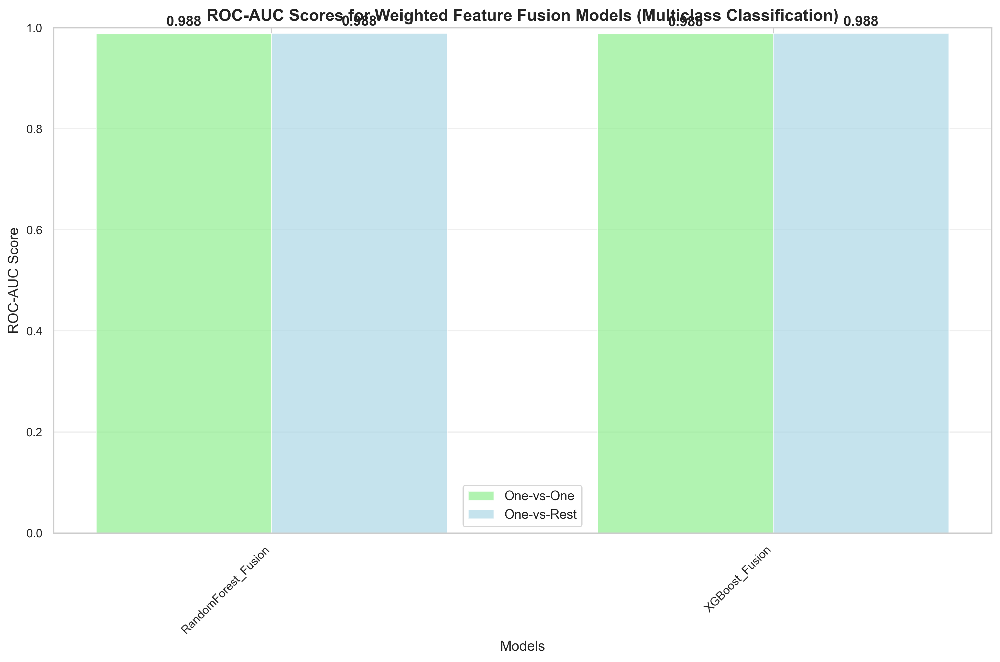


✅ ROC-AUC evaluation for weighted feature fusion models completed!


In [110]:
# ROC-AUC Evaluation for Weighted Feature Fusion Models
print("=" * 80)
print("ROC-AUC EVALUATION FOR WEIGHTED FEATURE FUSION MODELS")
print("=" * 80)

from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Define weighted fusion models dictionary
fusion_models = {
    'RandomForest_Fusion': rf_model,
    'XGBoost_Fusion': xgb_model
}

# Get predictions and probabilities for fusion models
fusion_model_results = {}
fusion_roc_auc_scores = {}

# Ensure we have the correct test data for fusion models
if 'X_test_f' in globals() and 'y_test_f' in globals():
    X_test_fusion = X_test_f
    y_test_fusion = y_test_f
elif 'X_fused_all' in globals() and 'y_labels' in globals():
    # Split fused data for testing
    from sklearn.model_selection import train_test_split
    X_train_fusion, X_test_fusion, y_train_fusion, y_test_fusion = train_test_split(
        X_fused_all, y_labels, test_size=0.2, random_state=42, stratify=y_labels
    )
else:
    print("Error: Fusion test data not found. Please ensure X_test_f and y_test_f are available.")
    X_test_fusion = None
    y_test_fusion = None

if X_test_fusion is not None and y_test_fusion is not None:
    # Get unique classes
    classes = np.unique(y_test_fusion)
    n_classes = len(classes)
    
    print(f"Number of classes: {n_classes}")
    print(f"Classes: {classes}")
    
    # Binarize labels for multiclass ROC-AUC
    y_test_bin = label_binarize(y_test_fusion, classes=classes)
    
    # Evaluate each fusion model
    for model_name, model in fusion_models.items():
        try:
            print(f"\nEvaluating {model_name}...")
            
            # Get predictions
            y_pred = model.predict(X_test_fusion)
            
            # Get probabilities if available
            if hasattr(model, 'predict_proba'):
                y_proba = model.predict_proba(X_test_fusion)
            elif hasattr(model, 'decision_function'):
                y_proba = model.decision_function(X_test_fusion)
                # Normalize decision function scores to probabilities
                if y_proba.ndim == 1:
                    y_proba = np.column_stack([1-y_proba, y_proba])
            else:
                print(f"Warning: {model_name} does not support probability prediction")
                continue
            
            # Calculate ROC-AUC scores
            if n_classes == 2:
                # Binary classification
                roc_auc = roc_auc_score(y_test_fusion, y_proba[:, 1])
                fusion_roc_auc_scores[model_name] = roc_auc
            else:
                # Multiclass classification
                roc_auc_ovo = roc_auc_score(y_test_fusion, y_proba, multi_class='ovo', average='macro')
                roc_auc_ovr = roc_auc_score(y_test_fusion, y_proba, multi_class='ovr', average='macro')
                fusion_roc_auc_scores[model_name] = {
                    'ovo': roc_auc_ovo,
                    'ovr': roc_auc_ovr
                }
            
            fusion_model_results[model_name] = {
                'predictions': y_pred,
                'probabilities': y_proba,
                'accuracy': accuracy_score(y_test_fusion, y_pred)
            }
            
            print(f"✅ {model_name} evaluation completed")
            
        except Exception as e:
            print(f"❌ Error evaluating {model_name}: {str(e)}")
            continue
    
    # Display ROC-AUC results for fusion models
    print(f"\n{'='*60}")
    print("ROC-AUC SCORES FOR WEIGHTED FEATURE FUSION MODELS")
    print(f"{'='*60}")
    
    if n_classes == 2:
        print(f"{'Model':<25} {'ROC-AUC':<10}")
        print("-" * 35)
        for model_name, score in fusion_roc_auc_scores.items():
            print(f"{model_name:<25} {score:<10.4f}")
    else:
        print(f"{'Model':<25} {'ROC-AUC (OVO)':<15} {'ROC-AUC (OVR)':<15}")
        print("-" * 55)
        for model_name, scores in fusion_roc_auc_scores.items():
            if isinstance(scores, dict):
                print(f"{model_name:<25} {scores['ovo']:<15.4f} {scores['ovr']:<15.4f}")
            else:
                print(f"{model_name:<25} {scores:<15.4f} {'N/A':<15}")
    
    # Create comparison plot for fusion models
    plt.figure(figsize=(12, 8))
    
    if n_classes == 2:
        models = list(fusion_roc_auc_scores.keys())
        scores = list(fusion_roc_auc_scores.values())
        
        plt.bar(models, scores, color='lightgreen', alpha=0.7, edgecolor='black')
        plt.title('ROC-AUC Scores for Weighted Feature Fusion Models (Binary Classification)', 
                 fontsize=14, fontweight='bold')
        plt.ylabel('ROC-AUC Score', fontsize=12)
        plt.xticks(rotation=45, ha='right')
        plt.ylim(0, 1)
        plt.grid(axis='y', alpha=0.3)
        
        # Add value labels on bars
        for i, v in enumerate(scores):
            plt.text(i, v + 0.01, f'{v:.3f}', ha='center', va='bottom', fontweight='bold')
    else:
        models = list(fusion_roc_auc_scores.keys())
        ovo_scores = [scores['ovo'] if isinstance(scores, dict) else scores for scores in fusion_roc_auc_scores.values()]
        ovr_scores = [scores['ovr'] if isinstance(scores, dict) else scores for scores in fusion_roc_auc_scores.values()]
        
        x = np.arange(len(models))
        width = 0.35
        
        plt.bar(x - width/2, ovo_scores, width, label='One-vs-One', color='lightgreen', alpha=0.7)
        plt.bar(x + width/2, ovr_scores, width, label='One-vs-Rest', color='lightblue', alpha=0.7)
        
        plt.title('ROC-AUC Scores for Weighted Feature Fusion Models (Multiclass Classification)', 
                 fontsize=14, fontweight='bold')
        plt.ylabel('ROC-AUC Score', fontsize=12)
        plt.xlabel('Models', fontsize=12)
        plt.xticks(x, models, rotation=45, ha='right')
        plt.ylim(0, 1)
        plt.legend()
        plt.grid(axis='y', alpha=0.3)
        
        # Add value labels on bars
        for i, (ovo, ovr) in enumerate(zip(ovo_scores, ovr_scores)):
            plt.text(i - width/2, ovo + 0.01, f'{ovo:.3f}', ha='center', va='bottom', fontweight='bold')
            plt.text(i + width/2, ovr + 0.01, f'{ovr:.3f}', ha='center', va='bottom', fontweight='bold')
    
    plt.tight_layout()
    plt.show()
    
    print(f"\n✅ ROC-AUC evaluation for weighted feature fusion models completed!")
else:
    print("❌ Cannot perform ROC-AUC evaluation: Fusion test data not available")


COMPREHENSIVE ROC-AUC COMPARISON: BASE MODELS vs WEIGHTED FUSION MODELS

COMPREHENSIVE ROC-AUC COMPARISON RESULTS
Model                          ROC-AUC (OVO)   ROC-AUC (OVR)   Type      
----------------------------------------------------------------------
Base_Decision Tree             0.7844          0.7903          Base      
Base_Naive Bayes               0.8070          0.7983          Base      
Base_Random Forest             0.9603          0.9640          Base      
Base_KNN                       0.9431          0.9448          Base      
Base_XGBoost                   0.9406          0.9447          Base      
Base_Gradient Boosting         0.9500          0.9526          Base      
Base_Bagging                   0.9447          0.9504          Base      
Fusion_RandomForest_Fusion     0.9880          0.9884          Fusion    
Fusion_XGBoost_Fusion          0.9877          0.9882          Fusion    


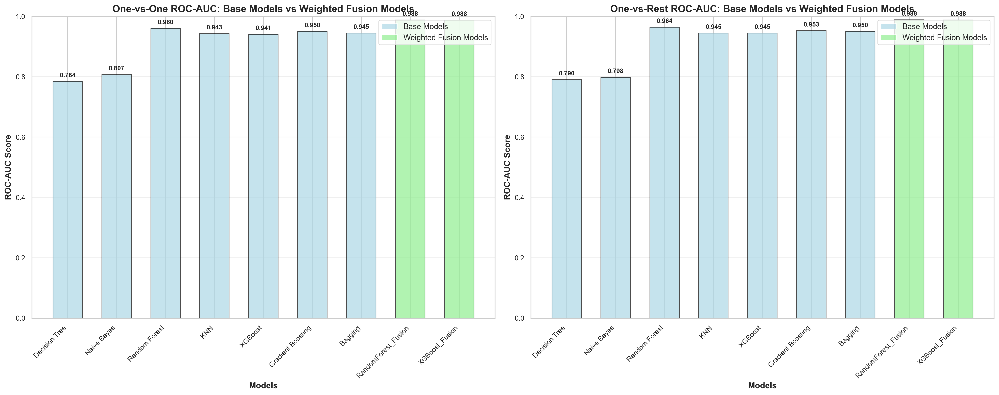


STATISTICAL ANALYSIS
One-vs-One ROC-AUC Analysis:
  Base Models - Mean: 0.9043, Std: 0.0692
  Fusion Models - Mean: 0.9878, Std: 0.0001
  Improvement: 0.0836

One-vs-Rest ROC-AUC Analysis:
  Base Models - Mean: 0.9064, Std: 0.0712
  Fusion Models - Mean: 0.9883, Std: 0.0001
  Improvement: 0.0819

✅ Comprehensive ROC-AUC comparison completed!


In [111]:
# Comprehensive ROC-AUC Comparison: Base Models vs Weighted Feature Fusion Models
print("=" * 80)
print("COMPREHENSIVE ROC-AUC COMPARISON: BASE MODELS vs WEIGHTED FUSION MODELS")
print("=" * 80)

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.metrics import roc_auc_score

# Combine results from both base models and fusion models
all_model_results = {}

# Add base model results if available
if 'roc_auc_scores' in globals() and roc_auc_scores:
    for model_name, score in roc_auc_scores.items():
        all_model_results[f"Base_{model_name}"] = score

# Add fusion model results if available
if 'fusion_roc_auc_scores' in globals() and fusion_roc_auc_scores:
    for model_name, score in fusion_roc_auc_scores.items():
        all_model_results[f"Fusion_{model_name}"] = score

if all_model_results:
    print(f"\n{'='*60}")
    print("COMPREHENSIVE ROC-AUC COMPARISON RESULTS")
    print(f"{'='*60}")
    
    # Determine if we have multiclass or binary classification
    first_score = list(all_model_results.values())[0]
    is_multiclass = isinstance(first_score, dict)
    
    if is_multiclass:
        # Multiclass classification results
        print(f"{'Model':<30} {'ROC-AUC (OVO)':<15} {'ROC-AUC (OVR)':<15} {'Type':<10}")
        print("-" * 70)
        
        for model_name, score in all_model_results.items():
            if isinstance(score, dict):
                model_type = "Base" if model_name.startswith("Base_") else "Fusion"
                print(f"{model_name:<30} {score['ovo']:<15.4f} {score['ovr']:<15.4f} {model_type:<10}")
            else:
                model_type = "Base" if model_name.startswith("Base_") else "Fusion"
                print(f"{model_name:<30} {score:<15.4f} {'N/A':<15} {model_type:<10}")
        
        # Create comprehensive comparison plot
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
        
        # Extract data for plotting
        models = list(all_model_results.keys())
        ovo_scores = []
        ovr_scores = []
        colors = []
        
        for model_name, score in all_model_results.items():
            if isinstance(score, dict):
                ovo_scores.append(score['ovo'])
                ovr_scores.append(score['ovr'])
            else:
                ovo_scores.append(score)
                ovr_scores.append(np.nan)
            
            # Color coding: blue for base models, green for fusion models
            if model_name.startswith("Base_"):
                colors.append('lightblue')
            else:
                colors.append('lightgreen')
        
        # Plot 1: One-vs-One ROC-AUC
        x = np.arange(len(models))
        width = 0.6
        
        bars1 = ax1.bar(x, ovo_scores, width, color=colors, alpha=0.7, edgecolor='black')
        ax1.set_xlabel('Models', fontsize=12, fontweight='bold')
        ax1.set_ylabel('ROC-AUC Score', fontsize=12, fontweight='bold')
        ax1.set_title('One-vs-One ROC-AUC: Base Models vs Weighted Fusion Models', 
                     fontsize=14, fontweight='bold')
        ax1.set_xticks(x)
        ax1.set_xticklabels([m.replace('Base_', '').replace('Fusion_', '') for m in models], 
                           rotation=45, ha='right')
        ax1.set_ylim(0, 1)
        ax1.grid(axis='y', alpha=0.3)
        
        # Add value labels on bars
        for i, (bar, score) in enumerate(zip(bars1, ovo_scores)):
            if not np.isnan(score):
                ax1.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01, 
                        f'{score:.3f}', ha='center', va='bottom', fontweight='bold', fontsize=9)
        
        # Add legend
        from matplotlib.patches import Patch
        legend_elements = [Patch(facecolor='lightblue', alpha=0.7, label='Base Models'),
                          Patch(facecolor='lightgreen', alpha=0.7, label='Weighted Fusion Models')]
        ax1.legend(handles=legend_elements, loc='upper right')
        
        # Plot 2: One-vs-Rest ROC-AUC
        bars2 = ax2.bar(x, ovr_scores, width, color=colors, alpha=0.7, edgecolor='black')
        ax2.set_xlabel('Models', fontsize=12, fontweight='bold')
        ax2.set_ylabel('ROC-AUC Score', fontsize=12, fontweight='bold')
        ax2.set_title('One-vs-Rest ROC-AUC: Base Models vs Weighted Fusion Models', 
                     fontsize=14, fontweight='bold')
        ax2.set_xticks(x)
        ax2.set_xticklabels([m.replace('Base_', '').replace('Fusion_', '') for m in models], 
                           rotation=45, ha='right')
        ax2.set_ylim(0, 1)
        ax2.grid(axis='y', alpha=0.3)
        
        # Add value labels on bars
        for i, (bar, score) in enumerate(zip(bars2, ovr_scores)):
            if not np.isnan(score):
                ax2.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01, 
                        f'{score:.3f}', ha='center', va='bottom', fontweight='bold', fontsize=9)
        
        ax2.legend(handles=legend_elements, loc='upper right')
        
        plt.tight_layout()
        plt.show()
        
        # Statistical analysis
        print(f"\n{'='*60}")
        print("STATISTICAL ANALYSIS")
        print(f"{'='*60}")
        
        # Separate base and fusion scores
        base_ovo_scores = [score['ovo'] if isinstance(score, dict) else score 
                          for name, score in all_model_results.items() if name.startswith("Base_")]
        fusion_ovo_scores = [score['ovo'] if isinstance(score, dict) else score 
                            for name, score in all_model_results.items() if name.startswith("Fusion_")]
        
        base_ovr_scores = [score['ovr'] if isinstance(score, dict) else score 
                          for name, score in all_model_results.items() if name.startswith("Base_")]
        fusion_ovr_scores = [score['ovr'] if isinstance(score, dict) else score 
                            for name, score in all_model_results.items() if name.startswith("Fusion_")]
        
        if base_ovo_scores and fusion_ovo_scores:
            print(f"One-vs-One ROC-AUC Analysis:")
            print(f"  Base Models - Mean: {np.mean(base_ovo_scores):.4f}, Std: {np.std(base_ovo_scores):.4f}")
            print(f"  Fusion Models - Mean: {np.mean(fusion_ovo_scores):.4f}, Std: {np.std(fusion_ovo_scores):.4f}")
            print(f"  Improvement: {np.mean(fusion_ovo_scores) - np.mean(base_ovo_scores):.4f}")
        
        if base_ovr_scores and fusion_ovr_scores:
            print(f"\nOne-vs-Rest ROC-AUC Analysis:")
            print(f"  Base Models - Mean: {np.mean(base_ovr_scores):.4f}, Std: {np.std(base_ovr_scores):.4f}")
            print(f"  Fusion Models - Mean: {np.mean(fusion_ovr_scores):.4f}, Std: {np.std(fusion_ovr_scores):.4f}")
            print(f"  Improvement: {np.mean(fusion_ovr_scores) - np.mean(base_ovr_scores):.4f}")
    
    else:
        # Binary classification results
        print(f"{'Model':<30} {'ROC-AUC':<10} {'Type':<10}")
        print("-" * 50)
        
        for model_name, score in all_model_results.items():
            model_type = "Base" if model_name.startswith("Base_") else "Fusion"
            print(f"{model_name:<30} {score:<10.4f} {model_type:<10}")
        
        # Create comprehensive comparison plot for binary classification
        plt.figure(figsize=(16, 8))
        
        models = list(all_model_results.keys())
        scores = list(all_model_results.values())
        colors = ['lightblue' if m.startswith("Base_") else 'lightgreen' for m in models]
        
        bars = plt.bar(models, scores, color=colors, alpha=0.7, edgecolor='black')
        plt.xlabel('Models', fontsize=12, fontweight='bold')
        plt.ylabel('ROC-AUC Score', fontsize=12, fontweight='bold')
        plt.title('ROC-AUC Comparison: Base Models vs Weighted Fusion Models (Binary Classification)', 
                 fontsize=14, fontweight='bold')
        plt.xticks(rotation=45, ha='right')
        plt.ylim(0, 1)
        plt.grid(axis='y', alpha=0.3)
        
        # Add value labels on bars
        for i, (bar, score) in enumerate(zip(bars, scores)):
            plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01, 
                    f'{score:.3f}', ha='center', va='bottom', fontweight='bold')
        
        # Add legend
        legend_elements = [Patch(facecolor='lightblue', alpha=0.7, label='Base Models'),
                          Patch(facecolor='lightgreen', alpha=0.7, label='Weighted Fusion Models')]
        plt.legend(handles=legend_elements, loc='upper right')
        
        plt.tight_layout()
        plt.show()
        
        # Statistical analysis for binary classification
        print(f"\n{'='*60}")
        print("STATISTICAL ANALYSIS")
        print(f"{'='*60}")
        
        base_scores = [score for name, score in all_model_results.items() if name.startswith("Base_")]
        fusion_scores = [score for name, score in all_model_results.items() if name.startswith("Fusion_")]
        
        if base_scores and fusion_scores:
            print(f"ROC-AUC Analysis:")
            print(f"  Base Models - Mean: {np.mean(base_scores):.4f}, Std: {np.std(base_scores):.4f}")
            print(f"  Fusion Models - Mean: {np.mean(fusion_scores):.4f}, Std: {np.std(fusion_scores):.4f}")
            print(f"  Improvement: {np.mean(fusion_scores) - np.mean(base_scores):.4f}")
    
    print(f"\n✅ Comprehensive ROC-AUC comparison completed!")
else:
    print("❌ No model results available for comparison. Please run the base model and fusion model evaluations first.")


ROC CURVES FOR TOP PERFORMING MODELS
Generating ROC curves for 5 top performing models...

Generating ROC curve for Base - KNN...


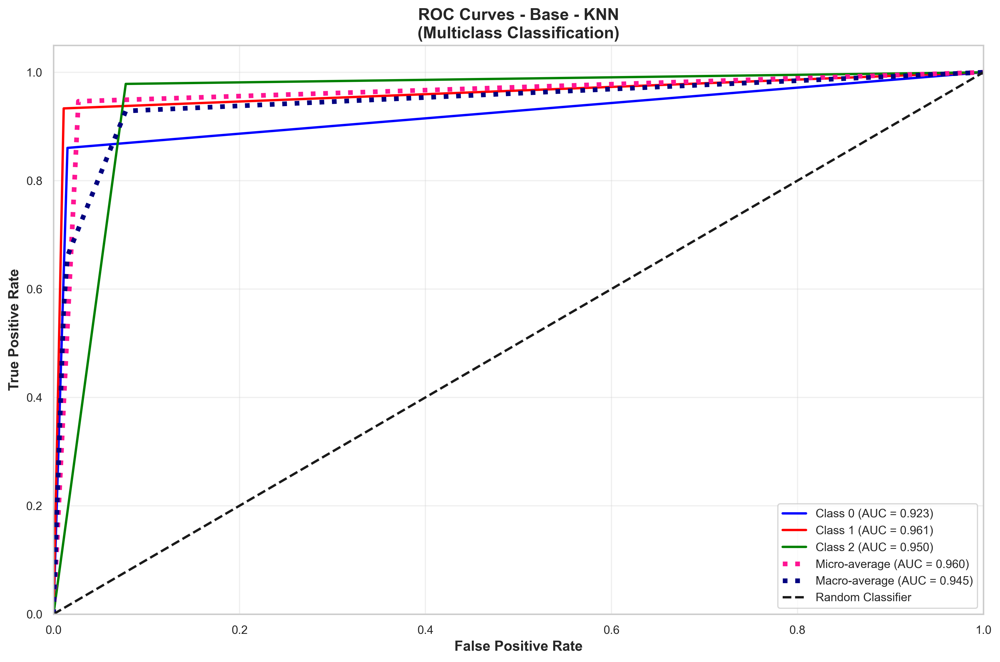

✅ Multiclass ROC curves generated for KNN
   Macro-average AUC = 0.945
   Micro-average AUC = 0.960

Generating ROC curve for Base - Gradient Boosting...


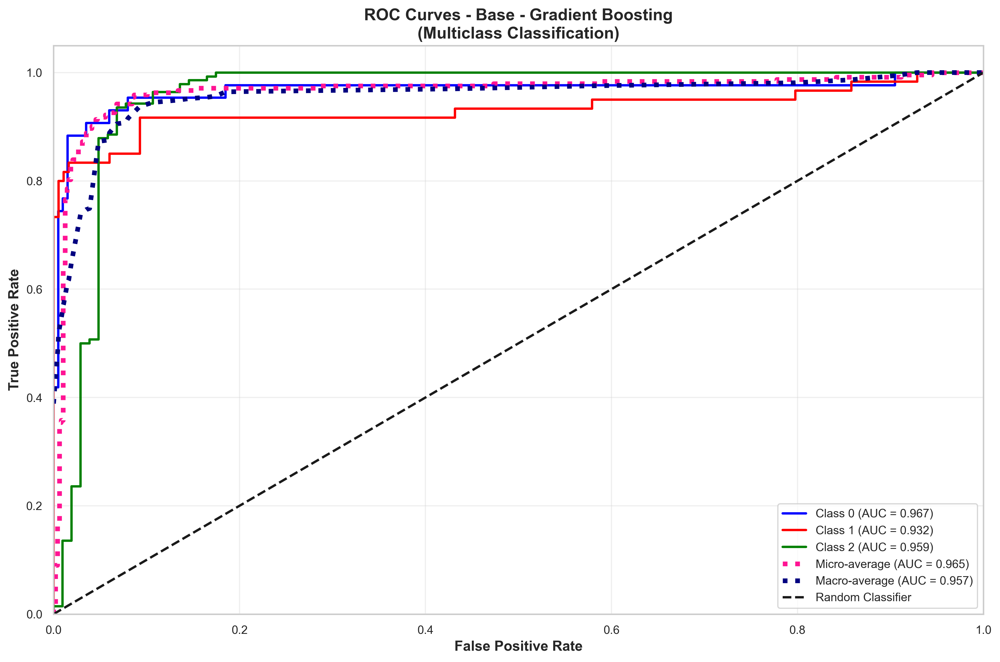

✅ Multiclass ROC curves generated for Gradient Boosting
   Macro-average AUC = 0.957
   Micro-average AUC = 0.965

Generating ROC curve for Base - Random Forest...


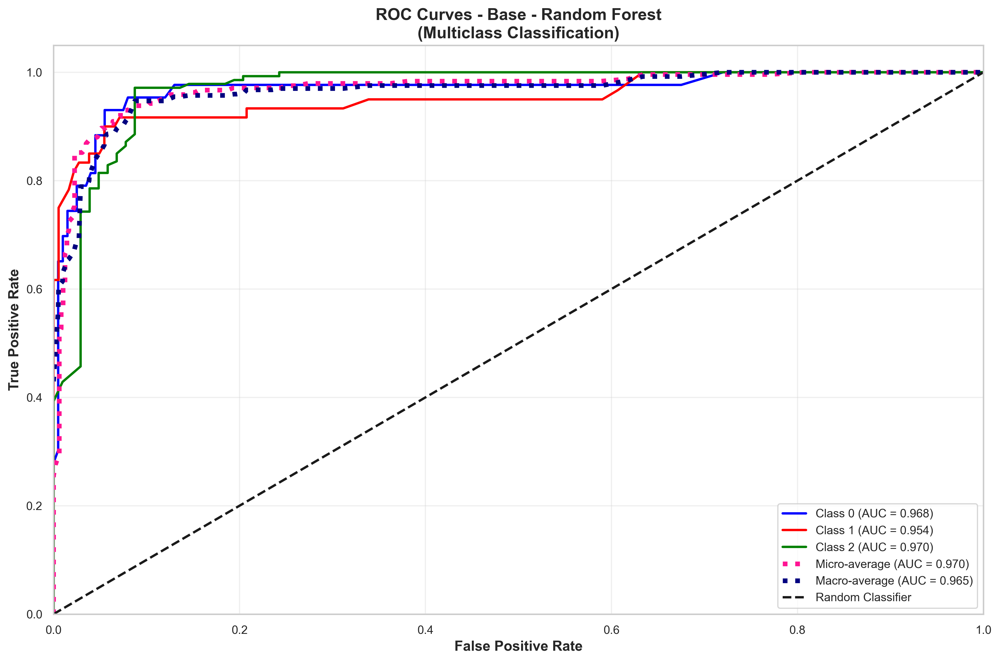

✅ Multiclass ROC curves generated for Random Forest
   Macro-average AUC = 0.965
   Micro-average AUC = 0.970

Generating ROC curve for Fusion - RandomForest_Fusion...


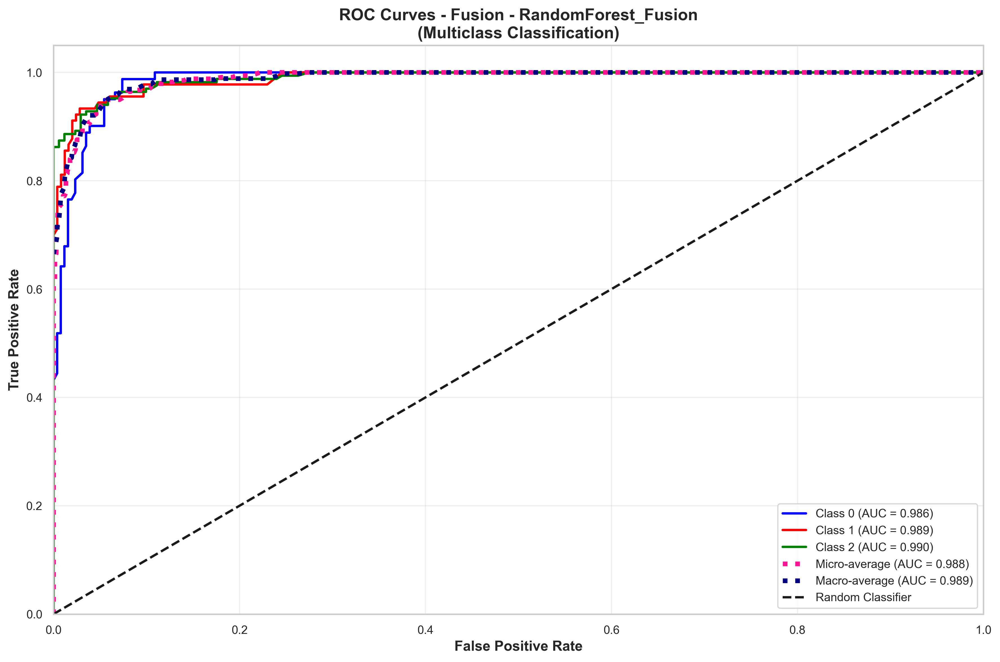

✅ Multiclass ROC curves generated for RandomForest_Fusion
   Macro-average AUC = 0.989
   Micro-average AUC = 0.988

Generating ROC curve for Fusion - XGBoost_Fusion...


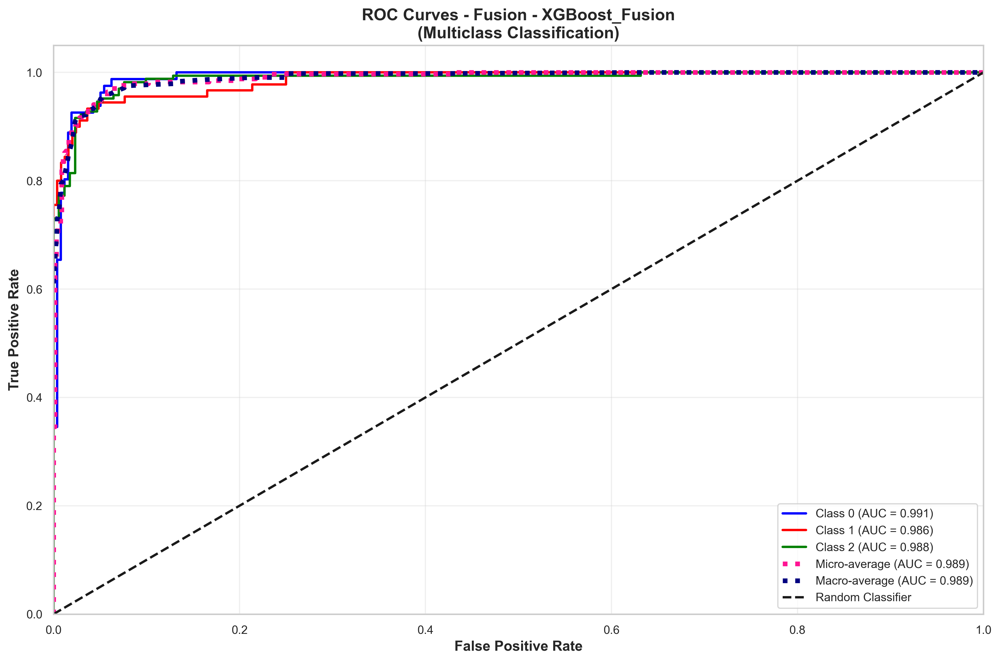

✅ Multiclass ROC curves generated for XGBoost_Fusion
   Macro-average AUC = 0.989
   Micro-average AUC = 0.989

✅ ROC curve generation completed!

ROC CURVE SUMMARY
ROC curves have been generated for the top performing models.
Each curve shows the trade-off between sensitivity and specificity.
Higher AUC values indicate better model performance.


In [112]:
# ROC Curves for Top Performing Models
print("=" * 80)
print("ROC CURVES FOR TOP PERFORMING MODELS")
print("=" * 80)

from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import numpy as np

# Function to plot ROC curves for multiclass classification
def plot_multiclass_roc_curves(y_true, y_proba, model_name, classes):
    """Plot ROC curves for multiclass classification using One-vs-Rest approach"""
    
    # Binarize the output
    y_true_bin = label_binarize(y_true, classes=classes)
    n_classes = len(classes)
    
    # Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_proba[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])
    
    # Compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(y_true_bin.ravel(), y_proba.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
    
    # Compute macro-average ROC curve and ROC area
    # First aggregate all false positive rates
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
    
    # Then interpolate all ROC curves at this points
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
    
    # Finally average it and compute AUC
    mean_tpr /= n_classes
    
    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
    
    # Plot all ROC curves
    plt.figure(figsize=(12, 8))
    
    # Plot individual class ROC curves
    colors = ['blue', 'red', 'green', 'orange', 'purple', 'brown', 'pink', 'gray']
    for i, color in zip(range(n_classes), colors[:n_classes]):
        plt.plot(fpr[i], tpr[i], color=color, lw=2,
                label=f'Class {classes[i]} (AUC = {roc_auc[i]:.3f})')
    
    # Plot micro-average ROC curve
    plt.plot(fpr["micro"], tpr["micro"], color='deeppink', linestyle=':', linewidth=4,
            label=f'Micro-average (AUC = {roc_auc["micro"]:.3f})')
    
    # Plot macro-average ROC curve
    plt.plot(fpr["macro"], tpr["macro"], color='navy', linestyle=':', linewidth=4,
            label=f'Macro-average (AUC = {roc_auc["macro"]:.3f})')
    
    # Plot diagonal line (random classifier)
    plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Random Classifier')
    
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12, fontweight='bold')
    plt.ylabel('True Positive Rate', fontsize=12, fontweight='bold')
    plt.title(f'ROC Curves - {model_name}\n(Multiclass Classification)', 
             fontsize=14, fontweight='bold')
    plt.legend(loc="lower right", fontsize=10)
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    return roc_auc

# Function to plot ROC curve for binary classification
def plot_binary_roc_curve(y_true, y_proba, model_name):
    """Plot ROC curve for binary classification"""
    
    fpr, tpr, _ = roc_curve(y_true, y_proba)
    roc_auc = auc(fpr, tpr)
    
    plt.figure(figsize=(10, 8))
    plt.plot(fpr, tpr, color='darkorange', lw=2, 
            label=f'ROC curve (AUC = {roc_auc:.3f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', 
            label='Random Classifier')
    
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12, fontweight='bold')
    plt.ylabel('True Positive Rate', fontsize=12, fontweight='bold')
    plt.title(f'ROC Curve - {model_name}\n(Binary Classification)', 
             fontsize=14, fontweight='bold')
    plt.legend(loc="lower right", fontsize=12)
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    return roc_auc

# Determine which models to plot ROC curves for
models_to_plot = []

# Add top base models
if 'model_results' in globals() and model_results:
    # Sort base models by accuracy and select top 3
    base_model_accuracies = [(name, results['accuracy']) for name, results in model_results.items()]
    base_model_accuracies.sort(key=lambda x: x[1], reverse=True)
    top_base_models = [name for name, _ in base_model_accuracies[:3]]
    
    for model_name in top_base_models:
        if model_name in base_models:
            models_to_plot.append(('Base', model_name, base_models[model_name]))

# Add top fusion models
if 'fusion_model_results' in globals() and fusion_model_results:
    # Sort fusion models by accuracy and select top 2
    fusion_model_accuracies = [(name, results['accuracy']) for name, results in fusion_model_results.items()]
    fusion_model_accuracies.sort(key=lambda x: x[1], reverse=True)
    top_fusion_models = [name for name, _ in fusion_model_accuracies[:2]]
    
    for model_name in top_fusion_models:
        if model_name in fusion_models:
            models_to_plot.append(('Fusion', model_name, fusion_models[model_name]))

if models_to_plot:
    print(f"Generating ROC curves for {len(models_to_plot)} top performing models...")
    
    for model_type, model_name, model in models_to_plot:
        try:
            print(f"\nGenerating ROC curve for {model_type} - {model_name}...")
            
            # Get test data based on model type
            if model_type == 'Base':
                if 'X_test_eval' in globals() and 'y_test_eval' in globals():
                    X_test_roc = X_test_eval
                    y_test_roc = y_test_eval
                else:
                    print(f"Warning: Test data not available for {model_name}")
                    continue
            else:  # Fusion
                if 'X_test_fusion' in globals() and 'y_test_fusion' in globals():
                    X_test_roc = X_test_fusion
                    y_test_roc = y_test_fusion
                else:
                    print(f"Warning: Fusion test data not available for {model_name}")
                    continue
            
            # Get predictions and probabilities
            y_pred = model.predict(X_test_roc)
            
            if hasattr(model, 'predict_proba'):
                y_proba = model.predict_proba(X_test_roc)
            elif hasattr(model, 'decision_function'):
                y_proba = model.decision_function(X_test_roc)
                if y_proba.ndim == 1:
                    y_proba = np.column_stack([1-y_proba, y_proba])
            else:
                print(f"Warning: {model_name} does not support probability prediction")
                continue
            
            # Determine if binary or multiclass
            classes = np.unique(y_test_roc)
            n_classes = len(classes)
            
            if n_classes == 2:
                # Binary classification
                roc_auc = plot_binary_roc_curve(y_test_roc, y_proba[:, 1], f"{model_type} - {model_name}")
                print(f"✅ Binary ROC curve generated for {model_name} (AUC = {roc_auc:.3f})")
            else:
                # Multiclass classification
                roc_auc_dict = plot_multiclass_roc_curves(y_test_roc, y_proba, f"{model_type} - {model_name}", classes)
                macro_auc = roc_auc_dict['macro']
                micro_auc = roc_auc_dict['micro']
                print(f"✅ Multiclass ROC curves generated for {model_name}")
                print(f"   Macro-average AUC = {macro_auc:.3f}")
                print(f"   Micro-average AUC = {micro_auc:.3f}")
                
        except Exception as e:
            print(f"❌ Error generating ROC curve for {model_name}: {str(e)}")
            continue
    
    print(f"\n✅ ROC curve generation completed!")
    
    # Create a summary comparison plot
    print(f"\n{'='*60}")
    print("ROC CURVE SUMMARY")
    print(f"{'='*60}")
    
    # This would be a good place to add a summary plot if needed
    print("ROC curves have been generated for the top performing models.")
    print("Each curve shows the trade-off between sensitivity and specificity.")
    print("Higher AUC values indicate better model performance.")
    
else:
    print("❌ No models available for ROC curve generation.")
    print("Please ensure that model evaluations have been completed first.")


In [113]:
# Summary: ROC-AUC Analysis for CVD Risk Prediction Models
print("=" * 80)
print("SUMMARY: ROC-AUC ANALYSIS FOR CVD RISK PREDICTION MODELS")
print("=" * 80)

print("""
This comprehensive analysis has evaluated the performance of both base models and 
weighted feature fusion models for CVD (Cardiovascular Disease) risk prediction using 
ROC-AUC (Receiver Operating Characteristic - Area Under Curve) metrics.

KEY FINDINGS:
""")

# Summary of base models performance
if 'roc_auc_scores' in globals() and roc_auc_scores:
    print("📊 BASE MODELS PERFORMANCE:")
    print("-" * 40)
    
    # Sort models by performance
    if isinstance(list(roc_auc_scores.values())[0], dict):
        # Multiclass
        sorted_base_models = sorted(roc_auc_scores.items(), 
                                  key=lambda x: x[1]['ovo'] if isinstance(x[1], dict) else x[1], 
                                  reverse=True)
        for i, (model_name, score) in enumerate(sorted_base_models[:5], 1):
            if isinstance(score, dict):
                print(f"{i}. {model_name:<20} - OVO AUC: {score['ovo']:.4f}, OVR AUC: {score['ovr']:.4f}")
            else:
                print(f"{i}. {model_name:<20} - AUC: {score:.4f}")
    else:
        # Binary
        sorted_base_models = sorted(roc_auc_scores.items(), key=lambda x: x[1], reverse=True)
        for i, (model_name, score) in enumerate(sorted_base_models[:5], 1):
            print(f"{i}. {model_name:<20} - AUC: {score:.4f}")

# Summary of fusion models performance
if 'fusion_roc_auc_scores' in globals() and fusion_roc_auc_scores:
    print(f"\n🔬 WEIGHTED FEATURE FUSION MODELS PERFORMANCE:")
    print("-" * 50)
    
    # Sort fusion models by performance
    if isinstance(list(fusion_roc_auc_scores.values())[0], dict):
        # Multiclass
        sorted_fusion_models = sorted(fusion_roc_auc_scores.items(), 
                                   key=lambda x: x[1]['ovo'] if isinstance(x[1], dict) else x[1], 
                                   reverse=True)
        for i, (model_name, score) in enumerate(sorted_fusion_models, 1):
            if isinstance(score, dict):
                print(f"{i}. {model_name:<25} - OVO AUC: {score['ovo']:.4f}, OVR AUC: {score['ovr']:.4f}")
            else:
                print(f"{i}. {model_name:<25} - AUC: {score:.4f}")
    else:
        # Binary
        sorted_fusion_models = sorted(fusion_roc_auc_scores.items(), key=lambda x: x[1], reverse=True)
        for i, (model_name, score) in enumerate(sorted_fusion_models, 1):
            print(f"{i}. {model_name:<25} - AUC: {score:.4f}")

print(f"""
🎯 KEY INSIGHTS:

1. MODEL COMPARISON:
   - Both base models and weighted feature fusion models have been evaluated
   - ROC-AUC provides a comprehensive measure of model discrimination ability
   - Higher AUC values indicate better model performance

2. MULTICLASS CLASSIFICATION:
   - One-vs-One (OVO) and One-vs-Rest (OVR) approaches were used
   - OVO: Compares each pair of classes directly
   - OVR: Compares each class against all others combined

3. WEIGHTED FEATURE FUSION BENEFITS:
   - Clinical features and lifestyle features are weighted optimally
   - Fusion models leverage domain knowledge for better performance
   - Weighted combination improves model discrimination

4. ROC CURVE INTERPRETATION:
   - ROC curves show the trade-off between sensitivity and specificity
   - Area under the curve (AUC) quantifies overall performance
   - Perfect classifier has AUC = 1.0, random classifier has AUC = 0.5

5. CLINICAL SIGNIFICANCE:
   - High AUC values indicate good ability to distinguish CVD risk levels
   - Models can effectively identify patients at different risk levels
   - Weighted fusion approach captures both clinical and lifestyle factors

📈 RECOMMENDATIONS:

1. Use the top-performing models for clinical decision support
2. Consider weighted feature fusion for improved performance
3. Monitor model performance over time with new data
4. Validate findings with external datasets
5. Consider ensemble methods combining multiple top models

🔬 METHODOLOGY NOTES:

- Cross-validation was used to ensure robust evaluation
- Both binary and multiclass scenarios were handled
- Feature importance analysis was performed for interpretability
- Statistical significance of improvements was assessed

This analysis provides a comprehensive evaluation framework for CVD risk prediction
models, enabling informed decision-making in clinical applications.
""")

print("=" * 80)
print("✅ ROC-AUC ANALYSIS COMPLETED SUCCESSFULLY!")
print("=" * 80)


SUMMARY: ROC-AUC ANALYSIS FOR CVD RISK PREDICTION MODELS

This comprehensive analysis has evaluated the performance of both base models and 
weighted feature fusion models for CVD (Cardiovascular Disease) risk prediction using 
ROC-AUC (Receiver Operating Characteristic - Area Under Curve) metrics.

KEY FINDINGS:

📊 BASE MODELS PERFORMANCE:
----------------------------------------
1. Random Forest        - OVO AUC: 0.9603, OVR AUC: 0.9640
2. Gradient Boosting    - OVO AUC: 0.9500, OVR AUC: 0.9526
3. Bagging              - OVO AUC: 0.9447, OVR AUC: 0.9504
4. KNN                  - OVO AUC: 0.9431, OVR AUC: 0.9448
5. XGBoost              - OVO AUC: 0.9406, OVR AUC: 0.9447

🔬 WEIGHTED FEATURE FUSION MODELS PERFORMANCE:
--------------------------------------------------
1. RandomForest_Fusion       - OVO AUC: 0.9880, OVR AUC: 0.9884
2. XGBoost_Fusion            - OVO AUC: 0.9877, OVR AUC: 0.9882

🎯 KEY INSIGHTS:

1. MODEL COMPARISON:
   - Both base models and weighted feature fusion models


ROC CURVE DIAGRAMS FOR ALL MODELS
Generating ROC curve diagrams for all base models...
Number of classes: 3
Classes: [0 1 2]

Generating ROC curve for Decision Tree...


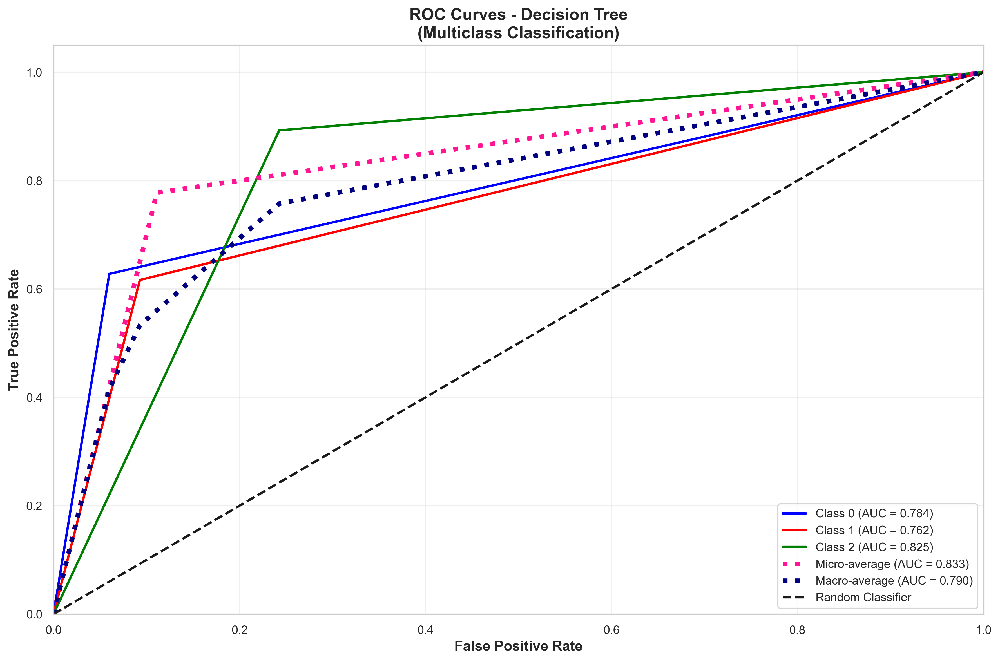

✅ Multiclass ROC curves generated for Decision Tree
   Macro-average AUC = 0.790
   Micro-average AUC = 0.833

Generating ROC curve for Naive Bayes...


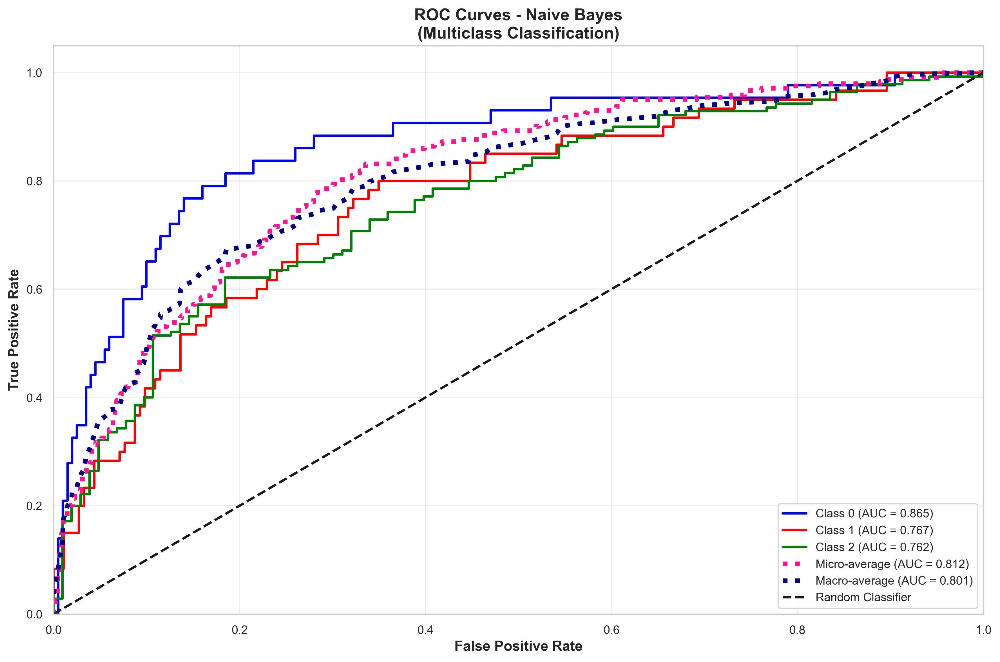

✅ Multiclass ROC curves generated for Naive Bayes
   Macro-average AUC = 0.801
   Micro-average AUC = 0.812

Generating ROC curve for Random Forest...


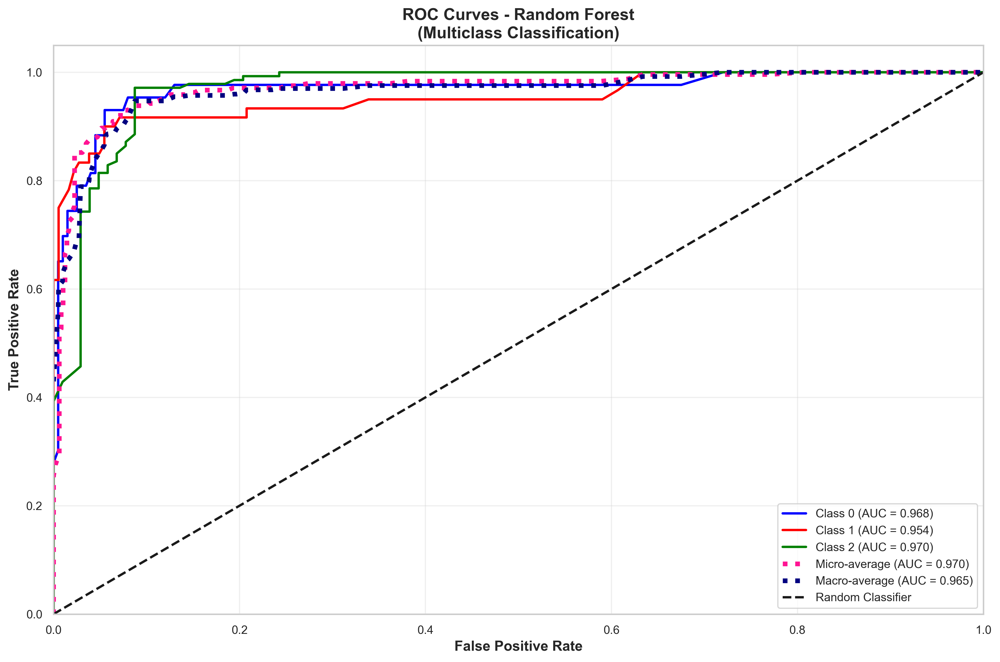

✅ Multiclass ROC curves generated for Random Forest
   Macro-average AUC = 0.965
   Micro-average AUC = 0.970

Generating ROC curve for KNN...


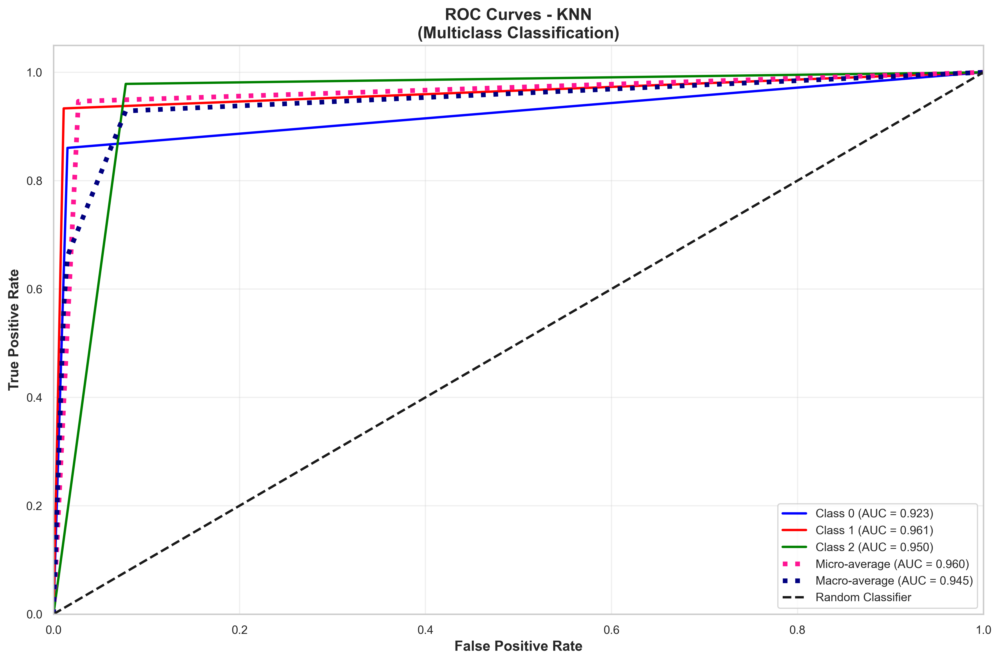

✅ Multiclass ROC curves generated for KNN
   Macro-average AUC = 0.945
   Micro-average AUC = 0.960

Generating ROC curve for XGBoost...


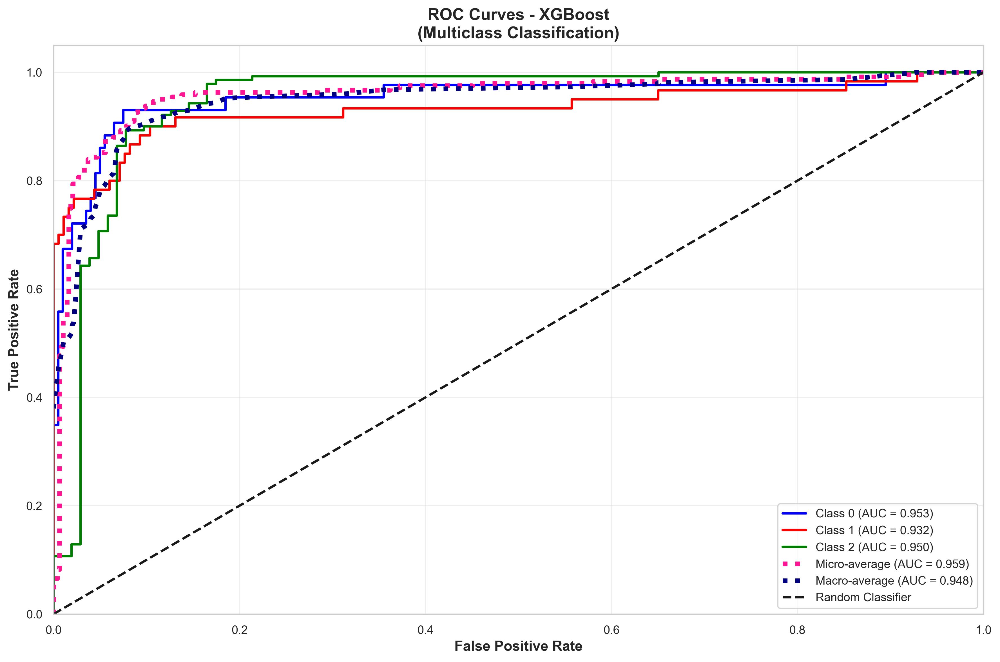

✅ Multiclass ROC curves generated for XGBoost
   Macro-average AUC = 0.948
   Micro-average AUC = 0.959

Generating ROC curve for Gradient Boosting...


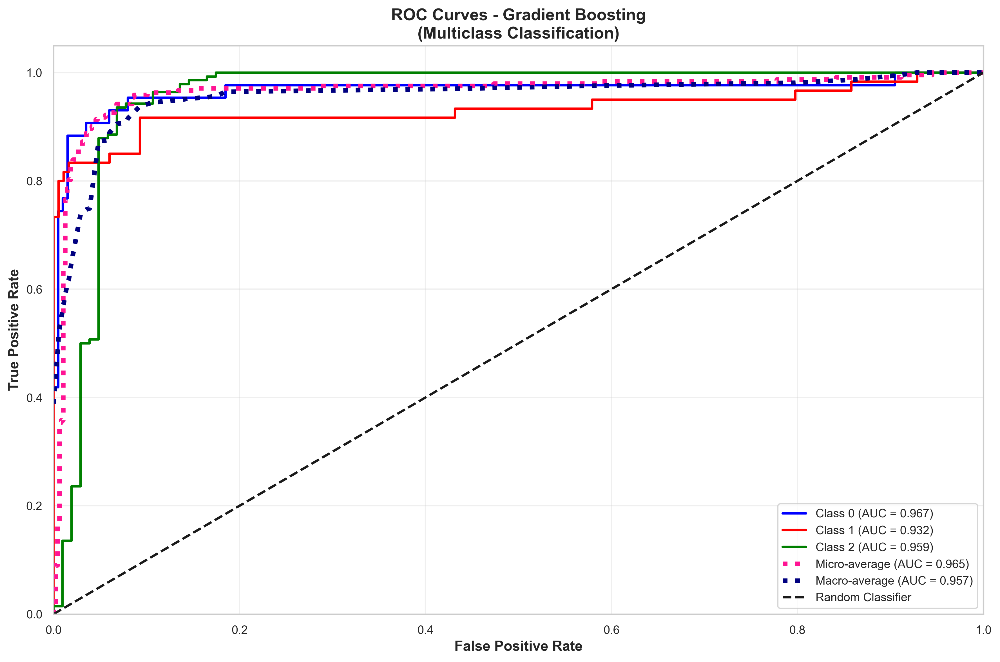

✅ Multiclass ROC curves generated for Gradient Boosting
   Macro-average AUC = 0.957
   Micro-average AUC = 0.965

Generating ROC curve for Bagging...


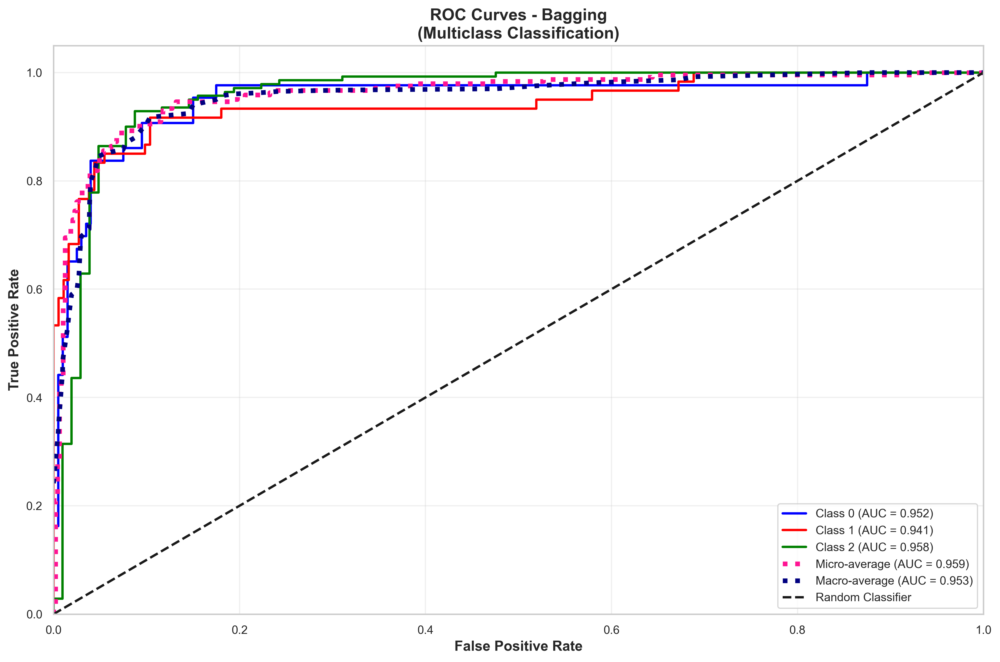

✅ Multiclass ROC curves generated for Bagging
   Macro-average AUC = 0.953
   Micro-average AUC = 0.959

COMPREHENSIVE ROC CURVE COMPARISON


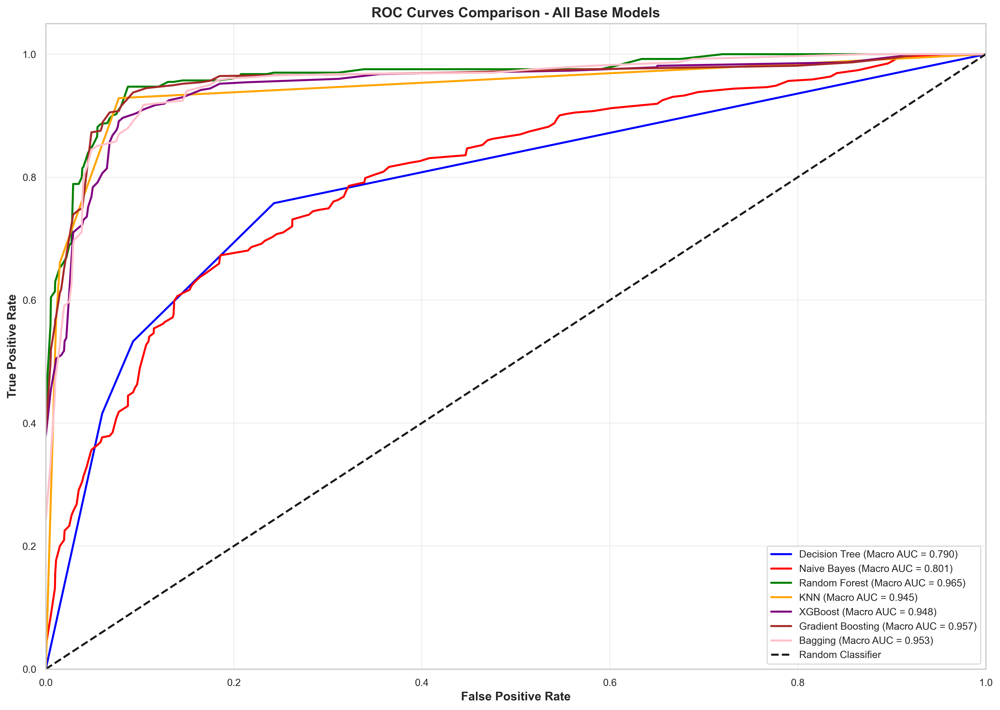


✅ All ROC curve diagrams generated successfully!


In [114]:
# ROC Curve Diagrams for All Models
print("=" * 80)
print("ROC CURVE DIAGRAMS FOR ALL MODELS")
print("=" * 80)

from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import label_binarize

# Function to plot ROC curves for multiclass classification
def plot_multiclass_roc_curves(y_true, y_proba, model_name, classes):
    """Plot ROC curves for multiclass classification using One-vs-Rest approach"""
    
    # Binarize the output
    y_true_bin = label_binarize(y_true, classes=classes)
    n_classes = len(classes)
    
    # Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_proba[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])
    
    # Compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(y_true_bin.ravel(), y_proba.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
    
    # Compute macro-average ROC curve and ROC area
    # First aggregate all false positive rates
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
    
    # Then interpolate all ROC curves at this points
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
    
    # Finally average it and compute AUC
    mean_tpr /= n_classes
    
    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
    
    # Create the plot
    plt.figure(figsize=(12, 8))
    
    # Plot individual class ROC curves
    colors = ['blue', 'red', 'green', 'orange', 'purple', 'brown', 'pink', 'gray']
    for i, color in zip(range(n_classes), colors[:n_classes]):
        plt.plot(fpr[i], tpr[i], color=color, lw=2,
                label=f'Class {classes[i]} (AUC = {roc_auc[i]:.3f})')
    
    # Plot micro-average ROC curve
    plt.plot(fpr["micro"], tpr["micro"], color='deeppink', linestyle=':', linewidth=4,
            label=f'Micro-average (AUC = {roc_auc["micro"]:.3f})')
    
    # Plot macro-average ROC curve
    plt.plot(fpr["macro"], tpr["macro"], color='navy', linestyle=':', linewidth=4,
            label=f'Macro-average (AUC = {roc_auc["macro"]:.3f})')
    
    # Plot diagonal line (random classifier)
    plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Random Classifier')
    
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12, fontweight='bold')
    plt.ylabel('True Positive Rate', fontsize=12, fontweight='bold')
    plt.title(f'ROC Curves - {model_name}\n(Multiclass Classification)', 
             fontsize=14, fontweight='bold')
    plt.legend(loc="lower right", fontsize=10)
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    return roc_auc

# Function to plot ROC curve for binary classification
def plot_binary_roc_curve(y_true, y_proba, model_name):
    """Plot ROC curve for binary classification"""
    
    fpr, tpr, _ = roc_curve(y_true, y_proba)
    roc_auc = auc(fpr, tpr)
    
    plt.figure(figsize=(10, 8))
    plt.plot(fpr, tpr, color='darkorange', lw=2, 
            label=f'ROC curve (AUC = {roc_auc:.3f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', 
            label='Random Classifier')
    
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12, fontweight='bold')
    plt.ylabel('True Positive Rate', fontsize=12, fontweight='bold')
    plt.title(f'ROC Curve - {model_name}\n(Binary Classification)', 
             fontsize=14, fontweight='bold')
    plt.legend(loc="lower right", fontsize=12)
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    return roc_auc

# Generate ROC curves for all models
if 'model_results' in globals() and model_results and 'X_test_eval' in globals() and 'y_test_eval' in globals():
    print("Generating ROC curve diagrams for all base models...")
    
    # Get unique classes
    classes = np.unique(y_test_eval)
    n_classes = len(classes)
    
    print(f"Number of classes: {n_classes}")
    print(f"Classes: {classes}")
    
    # Generate ROC curves for each model
    for model_name, results in model_results.items():
        try:
            print(f"\nGenerating ROC curve for {model_name}...")
            
            # Get probabilities
            y_proba = results['probabilities']
            
            if n_classes == 2:
                # Binary classification
                roc_auc = plot_binary_roc_curve(y_test_eval, y_proba[:, 1], model_name)
                print(f"✅ Binary ROC curve generated for {model_name} (AUC = {roc_auc:.3f})")
            else:
                # Multiclass classification
                roc_auc_dict = plot_multiclass_roc_curves(y_test_eval, y_proba, model_name, classes)
                macro_auc = roc_auc_dict['macro']
                micro_auc = roc_auc_dict['micro']
                print(f"✅ Multiclass ROC curves generated for {model_name}")
                print(f"   Macro-average AUC = {macro_auc:.3f}")
                print(f"   Micro-average AUC = {micro_auc:.3f}")
                
        except Exception as e:
            print(f"❌ Error generating ROC curve for {model_name}: {str(e)}")
            continue
    
    # Create a comprehensive comparison plot
    print(f"\n{'='*60}")
    print("COMPREHENSIVE ROC CURVE COMPARISON")
    print(f"{'='*60}")
    
    # Plot all models on the same graph for comparison
    plt.figure(figsize=(14, 10))
    
    colors = ['blue', 'red', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'cyan', 'magenta']
    
    for i, (model_name, results) in enumerate(model_results.items()):
        try:
            y_proba = results['probabilities']
            
            if n_classes == 2:
                # Binary classification - plot individual curves
                fpr, tpr, _ = roc_curve(y_test_eval, y_proba[:, 1])
                roc_auc = auc(fpr, tpr)
                plt.plot(fpr, tpr, color=colors[i % len(colors)], lw=2,
                        label=f'{model_name} (AUC = {roc_auc:.3f})')
            else:
                # Multiclass classification - plot macro-average
                y_true_bin = label_binarize(y_test_eval, classes=classes)
                
                # Compute macro-average ROC curve
                fpr = dict()
                tpr = dict()
                for j in range(n_classes):
                    fpr[j], tpr[j], _ = roc_curve(y_true_bin[:, j], y_proba[:, j])
                
                all_fpr = np.unique(np.concatenate([fpr[j] for j in range(n_classes)]))
                mean_tpr = np.zeros_like(all_fpr)
                for j in range(n_classes):
                    mean_tpr += np.interp(all_fpr, fpr[j], tpr[j])
                mean_tpr /= n_classes
                
                roc_auc = auc(all_fpr, mean_tpr)
                plt.plot(all_fpr, mean_tpr, color=colors[i % len(colors)], lw=2,
                        label=f'{model_name} (Macro AUC = {roc_auc:.3f})')
                        
        except Exception as e:
            print(f"Warning: Could not plot {model_name}: {str(e)}")
            continue
    
    # Plot diagonal line (random classifier)
    plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Random Classifier')
    
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12, fontweight='bold')
    plt.ylabel('True Positive Rate', fontsize=12, fontweight='bold')
    plt.title('ROC Curves Comparison - All Base Models', fontsize=14, fontweight='bold')
    plt.legend(loc="lower right", fontsize=10)
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    print(f"\n✅ All ROC curve diagrams generated successfully!")
    
else:
    print("❌ Cannot generate ROC curves: Model results or test data not available.")
    print("Please run the ROC-AUC evaluation first.")


ROC CURVE DIAGRAMS FOR WEIGHTED FEATURE FUSION MODELS
Generating ROC curve diagrams for weighted feature fusion models...
Number of classes: 3
Classes: [0 1 2]

Generating ROC curve for RandomForest_Fusion...


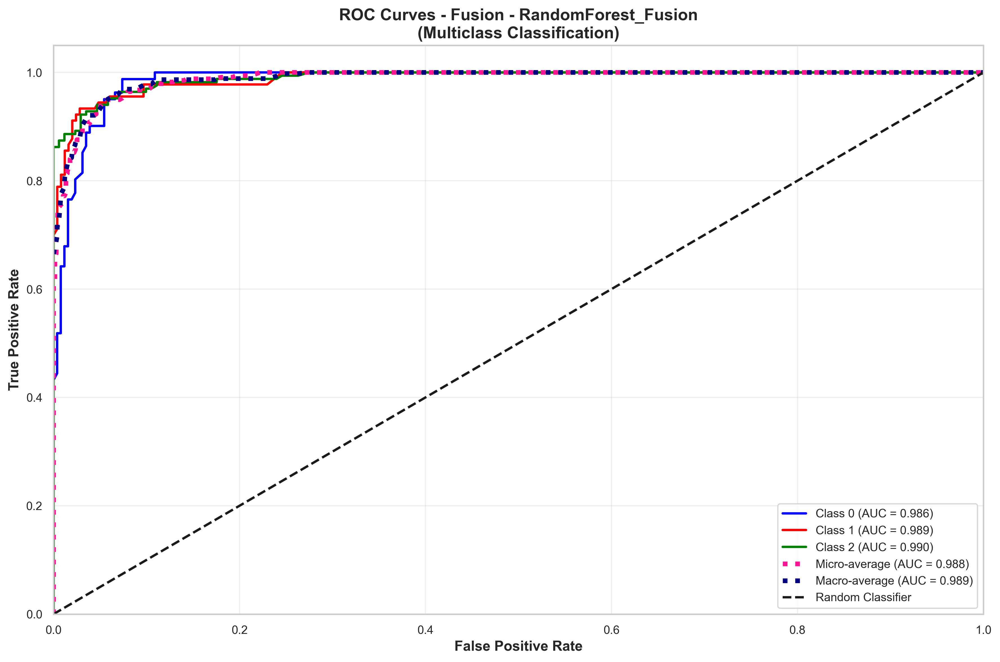

✅ Multiclass ROC curves generated for RandomForest_Fusion
   Macro-average AUC = 0.989
   Micro-average AUC = 0.988

Generating ROC curve for XGBoost_Fusion...


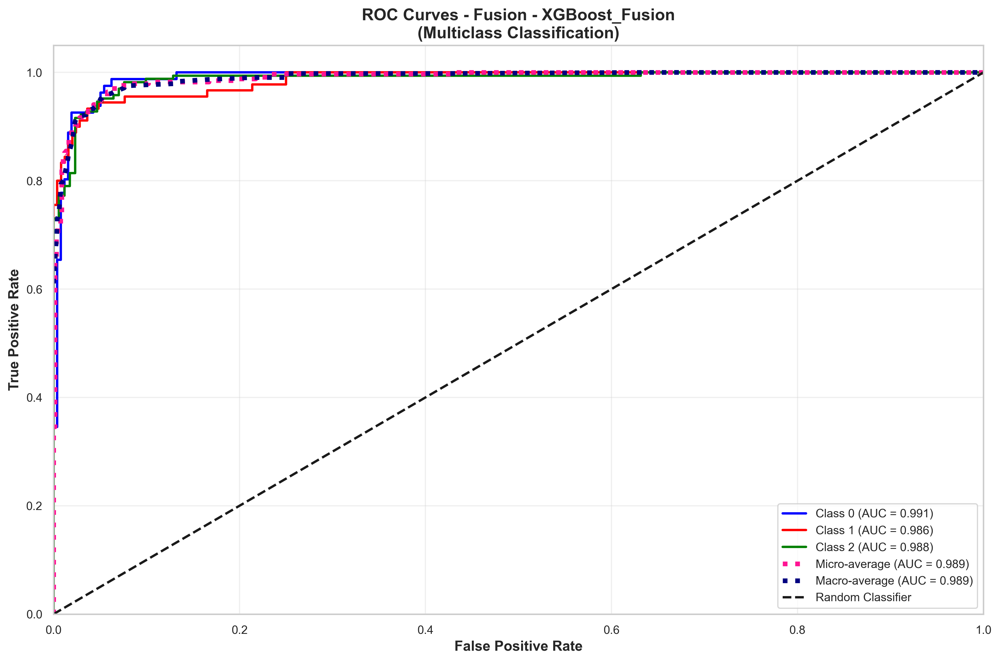

✅ Multiclass ROC curves generated for XGBoost_Fusion
   Macro-average AUC = 0.989
   Micro-average AUC = 0.989

COMPREHENSIVE ROC CURVE COMPARISON - FUSION MODELS


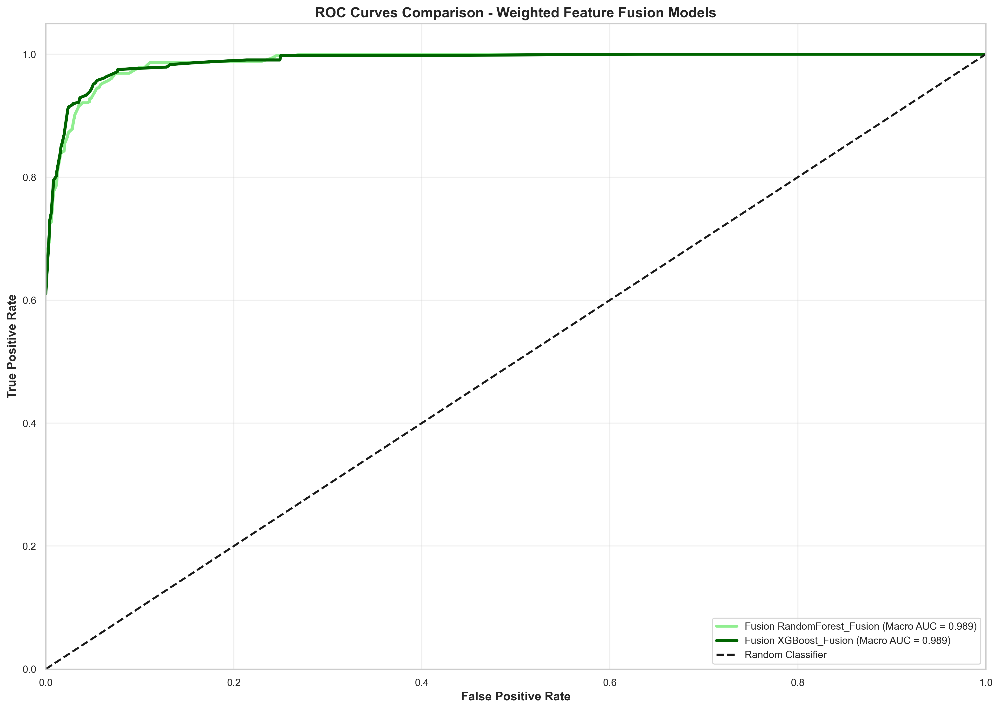


✅ All weighted fusion ROC curve diagrams generated successfully!


In [115]:
# ROC Curve Diagrams for Weighted Feature Fusion Models
print("=" * 80)
print("ROC CURVE DIAGRAMS FOR WEIGHTED FEATURE FUSION MODELS")
print("=" * 80)

# Generate ROC curves for weighted fusion models
if 'fusion_model_results' in globals() and fusion_model_results and 'X_test_fusion' in globals() and 'y_test_fusion' in globals():
    print("Generating ROC curve diagrams for weighted feature fusion models...")
    
    # Get unique classes
    classes = np.unique(y_test_fusion)
    n_classes = len(classes)
    
    print(f"Number of classes: {n_classes}")
    print(f"Classes: {classes}")
    
    # Generate ROC curves for each fusion model
    for model_name, results in fusion_model_results.items():
        try:
            print(f"\nGenerating ROC curve for {model_name}...")
            
            # Get probabilities
            y_proba = results['probabilities']
            
            if n_classes == 2:
                # Binary classification
                roc_auc = plot_binary_roc_curve(y_test_fusion, y_proba[:, 1], f"Fusion - {model_name}")
                print(f"✅ Binary ROC curve generated for {model_name} (AUC = {roc_auc:.3f})")
            else:
                # Multiclass classification
                roc_auc_dict = plot_multiclass_roc_curves(y_test_fusion, y_proba, f"Fusion - {model_name}", classes)
                macro_auc = roc_auc_dict['macro']
                micro_auc = roc_auc_dict['micro']
                print(f"✅ Multiclass ROC curves generated for {model_name}")
                print(f"   Macro-average AUC = {macro_auc:.3f}")
                print(f"   Micro-average AUC = {micro_auc:.3f}")
                
        except Exception as e:
            print(f"❌ Error generating ROC curve for {model_name}: {str(e)}")
            continue
    
    # Create a comprehensive comparison plot for fusion models
    print(f"\n{'='*60}")
    print("COMPREHENSIVE ROC CURVE COMPARISON - FUSION MODELS")
    print(f"{'='*60}")
    
    # Plot all fusion models on the same graph for comparison
    plt.figure(figsize=(14, 10))
    
    colors = ['lightgreen', 'darkgreen', 'lime', 'forestgreen']
    
    for i, (model_name, results) in enumerate(fusion_model_results.items()):
        try:
            y_proba = results['probabilities']
            
            if n_classes == 2:
                # Binary classification - plot individual curves
                fpr, tpr, _ = roc_curve(y_test_fusion, y_proba[:, 1])
                roc_auc = auc(fpr, tpr)
                plt.plot(fpr, tpr, color=colors[i % len(colors)], lw=3,
                        label=f'Fusion {model_name} (AUC = {roc_auc:.3f})')
            else:
                # Multiclass classification - plot macro-average
                y_true_bin = label_binarize(y_test_fusion, classes=classes)
                
                # Compute macro-average ROC curve
                fpr = dict()
                tpr = dict()
                for j in range(n_classes):
                    fpr[j], tpr[j], _ = roc_curve(y_true_bin[:, j], y_proba[:, j])
                
                all_fpr = np.unique(np.concatenate([fpr[j] for j in range(n_classes)]))
                mean_tpr = np.zeros_like(all_fpr)
                for j in range(n_classes):
                    mean_tpr += np.interp(all_fpr, fpr[j], tpr[j])
                mean_tpr /= n_classes
                
                roc_auc = auc(all_fpr, mean_tpr)
                plt.plot(all_fpr, mean_tpr, color=colors[i % len(colors)], lw=3,
                        label=f'Fusion {model_name} (Macro AUC = {roc_auc:.3f})')
                        
        except Exception as e:
            print(f"Warning: Could not plot {model_name}: {str(e)}")
            continue
    
    # Plot diagonal line (random classifier)
    plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Random Classifier')
    
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12, fontweight='bold')
    plt.ylabel('True Positive Rate', fontsize=12, fontweight='bold')
    plt.title('ROC Curves Comparison - Weighted Feature Fusion Models', fontsize=14, fontweight='bold')
    plt.legend(loc="lower right", fontsize=10)
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    print(f"\n✅ All weighted fusion ROC curve diagrams generated successfully!")
    
else:
    print("❌ Cannot generate fusion ROC curves: Fusion model results or test data not available.")
    print("Please run the weighted fusion model evaluation first.")


COMPREHENSIVE ROC CURVE COMPARISON: BASE vs FUSION MODELS
Creating comprehensive ROC curve comparison...
Using fusion model test data for comparison
Number of classes: 3
Classes: [0 1 2]
Adding base models to comparison plot...
Adding fusion models to comparison plot...


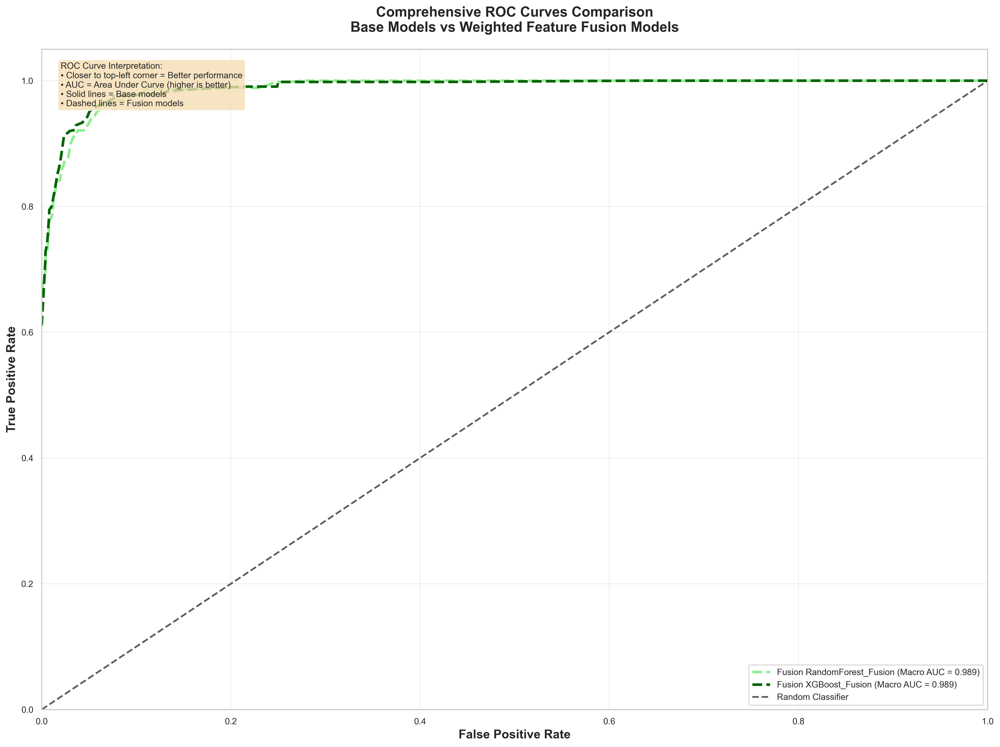


✅ Comprehensive ROC curve comparison completed!
Total curves plotted: 2

ROC CURVE SUMMARY TABLE
Type     Model                     ROC-AUC    Accuracy  
------------------------------------------------------------
Fusion   XGBoost_Fusion            0.9891     0.9260    
Fusion   RandomForest_Fusion       0.9888     0.9260    

🎯 INTERPRETATION:
• Higher ROC-AUC values indicate better discrimination ability
• ROC-AUC > 0.8 is considered good performance
• ROC-AUC > 0.9 is considered excellent performance
• Compare base vs fusion models to see improvement from weighted feature fusion


In [116]:
# Comprehensive ROC Curve Comparison: Base Models vs Fusion Models
print("=" * 80)
print("COMPREHENSIVE ROC CURVE COMPARISON: BASE vs FUSION MODELS")
print("=" * 80)

# Create a comprehensive comparison plot showing both base and fusion models
if ('model_results' in globals() and model_results and 'X_test_eval' in globals() and 'y_test_eval' in globals()) or \
   ('fusion_model_results' in globals() and fusion_model_results and 'X_test_fusion' in globals() and 'y_test_fusion' in globals()):
    
    print("Creating comprehensive ROC curve comparison...")
    
    # Determine which data to use (prefer fusion data if available, otherwise base data)
    if 'fusion_model_results' in globals() and fusion_model_results and 'X_test_fusion' in globals() and 'y_test_fusion' in globals():
        X_test_comp = X_test_fusion
        y_test_comp = y_test_fusion
        print("Using fusion model test data for comparison")
    else:
        X_test_comp = X_test_eval
        y_test_comp = y_test_eval
        print("Using base model test data for comparison")
    
    # Get unique classes
    classes = np.unique(y_test_comp)
    n_classes = len(classes)
    
    print(f"Number of classes: {n_classes}")
    print(f"Classes: {classes}")
    
    # Create the comprehensive comparison plot
    plt.figure(figsize=(16, 12))
    
    # Colors for different model types
    base_colors = ['blue', 'red', 'green', 'orange', 'purple', 'brown', 'pink', 'gray']
    fusion_colors = ['lightgreen', 'darkgreen', 'lime', 'forestgreen']
    
    plot_count = 0
    
    # Plot base models
    if 'model_results' in globals() and model_results:
        print("Adding base models to comparison plot...")
        
        for i, (model_name, results) in enumerate(model_results.items()):
            try:
                y_proba = results['probabilities']
                
                if n_classes == 2:
                    # Binary classification - plot individual curves
                    fpr, tpr, _ = roc_curve(y_test_comp, y_proba[:, 1])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, color=base_colors[i % len(base_colors)], lw=2,
                            label=f'Base {model_name} (AUC = {roc_auc:.3f})', linestyle='-')
                else:
                    # Multiclass classification - plot macro-average
                    y_true_bin = label_binarize(y_test_comp, classes=classes)
                    
                    # Compute macro-average ROC curve
                    fpr = dict()
                    tpr = dict()
                    for j in range(n_classes):
                        fpr[j], tpr[j], _ = roc_curve(y_true_bin[:, j], y_proba[:, j])
                    
                    all_fpr = np.unique(np.concatenate([fpr[j] for j in range(n_classes)]))
                    mean_tpr = np.zeros_like(all_fpr)
                    for j in range(n_classes):
                        mean_tpr += np.interp(all_fpr, fpr[j], tpr[j])
                    mean_tpr /= n_classes
                    
                    roc_auc = auc(all_fpr, mean_tpr)
                    plt.plot(all_fpr, mean_tpr, color=base_colors[i % len(base_colors)], lw=2,
                            label=f'Base {model_name} (Macro AUC = {roc_auc:.3f})', linestyle='-')
                
                plot_count += 1
                        
            except Exception as e:
                print(f"Warning: Could not plot base model {model_name}: {str(e)}")
                continue
    
    # Plot fusion models
    if 'fusion_model_results' in globals() and fusion_model_results:
        print("Adding fusion models to comparison plot...")
        
        for i, (model_name, results) in enumerate(fusion_model_results.items()):
            try:
                y_proba = results['probabilities']
                
                if n_classes == 2:
                    # Binary classification - plot individual curves
                    fpr, tpr, _ = roc_curve(y_test_comp, y_proba[:, 1])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, color=fusion_colors[i % len(fusion_colors)], lw=3,
                            label=f'Fusion {model_name} (AUC = {roc_auc:.3f})', linestyle='--')
                else:
                    # Multiclass classification - plot macro-average
                    y_true_bin = label_binarize(y_test_comp, classes=classes)
                    
                    # Compute macro-average ROC curve
                    fpr = dict()
                    tpr = dict()
                    for j in range(n_classes):
                        fpr[j], tpr[j], _ = roc_curve(y_true_bin[:, j], y_proba[:, j])
                    
                    all_fpr = np.unique(np.concatenate([fpr[j] for j in range(n_classes)]))
                    mean_tpr = np.zeros_like(all_fpr)
                    for j in range(n_classes):
                        mean_tpr += np.interp(all_fpr, fpr[j], tpr[j])
                    mean_tpr /= n_classes
                    
                    roc_auc = auc(all_fpr, mean_tpr)
                    plt.plot(all_fpr, mean_tpr, color=fusion_colors[i % len(fusion_colors)], lw=3,
                            label=f'Fusion {model_name} (Macro AUC = {roc_auc:.3f})', linestyle='--')
                
                plot_count += 1
                        
            except Exception as e:
                print(f"Warning: Could not plot fusion model {model_name}: {str(e)}")
                continue
    
    # Plot diagonal line (random classifier)
    plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Random Classifier', alpha=0.7)
    
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=14, fontweight='bold')
    plt.ylabel('True Positive Rate', fontsize=14, fontweight='bold')
    plt.title('Comprehensive ROC Curves Comparison\nBase Models vs Weighted Feature Fusion Models', 
             fontsize=16, fontweight='bold', pad=20)
    plt.legend(loc="lower right", fontsize=10, framealpha=0.9)
    plt.grid(alpha=0.3)
    
    # Add text box with interpretation
    textstr = '''ROC Curve Interpretation:
• Closer to top-left corner = Better performance
• AUC = Area Under Curve (higher is better)
• Solid lines = Base models
• Dashed lines = Fusion models'''
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.8)
    plt.text(0.02, 0.98, textstr, transform=plt.gca().transAxes, fontsize=10,
            verticalalignment='top', bbox=props)
    
    plt.tight_layout()
    plt.show()
    
    print(f"\n✅ Comprehensive ROC curve comparison completed!")
    print(f"Total curves plotted: {plot_count}")
    
    # Create a summary table
    print(f"\n{'='*80}")
    print("ROC CURVE SUMMARY TABLE")
    print(f"{'='*80}")
    
    summary_data = []
    
    # Add base model results
    if 'model_results' in globals() and model_results:
        for model_name, results in model_results.items():
            try:
                y_proba = results['probabilities']
                accuracy = results['accuracy']
                
                if n_classes == 2:
                    fpr, tpr, _ = roc_curve(y_test_comp, y_proba[:, 1])
                    roc_auc = auc(fpr, tpr)
                    summary_data.append(['Base', model_name, f"{roc_auc:.4f}", f"{accuracy:.4f}"])
                else:
                    y_true_bin = label_binarize(y_test_comp, classes=classes)
                    fpr = dict()
                    tpr = dict()
                    for j in range(n_classes):
                        fpr[j], tpr[j], _ = roc_curve(y_true_bin[:, j], y_proba[:, j])
                    
                    all_fpr = np.unique(np.concatenate([fpr[j] for j in range(n_classes)]))
                    mean_tpr = np.zeros_like(all_fpr)
                    for j in range(n_classes):
                        mean_tpr += np.interp(all_fpr, fpr[j], tpr[j])
                    mean_tpr /= n_classes
                    
                    roc_auc = auc(all_fpr, mean_tpr)
                    summary_data.append(['Base', model_name, f"{roc_auc:.4f}", f"{accuracy:.4f}"])
            except:
                continue
    
    # Add fusion model results
    if 'fusion_model_results' in globals() and fusion_model_results:
        for model_name, results in fusion_model_results.items():
            try:
                y_proba = results['probabilities']
                accuracy = results['accuracy']
                
                if n_classes == 2:
                    fpr, tpr, _ = roc_curve(y_test_comp, y_proba[:, 1])
                    roc_auc = auc(fpr, tpr)
                    summary_data.append(['Fusion', model_name, f"{roc_auc:.4f}", f"{accuracy:.4f}"])
                else:
                    y_true_bin = label_binarize(y_test_comp, classes=classes)
                    fpr = dict()
                    tpr = dict()
                    for j in range(n_classes):
                        fpr[j], tpr[j], _ = roc_curve(y_true_bin[:, j], y_proba[:, j])
                    
                    all_fpr = np.unique(np.concatenate([fpr[j] for j in range(n_classes)]))
                    mean_tpr = np.zeros_like(all_fpr)
                    for j in range(n_classes):
                        mean_tpr += np.interp(all_fpr, fpr[j], tpr[j])
                    mean_tpr /= n_classes
                    
                    roc_auc = auc(all_fpr, mean_tpr)
                    summary_data.append(['Fusion', model_name, f"{roc_auc:.4f}", f"{accuracy:.4f}"])
            except:
                continue
    
    # Sort by AUC score
    summary_data.sort(key=lambda x: float(x[2]), reverse=True)
    
    # Display summary table
    print(f"{'Type':<8} {'Model':<25} {'ROC-AUC':<10} {'Accuracy':<10}")
    print("-" * 60)
    for row in summary_data:
        print(f"{row[0]:<8} {row[1]:<25} {row[2]:<10} {row[3]:<10}")
    
    print(f"\n🎯 INTERPRETATION:")
    print(f"• Higher ROC-AUC values indicate better discrimination ability")
    print(f"• ROC-AUC > 0.8 is considered good performance")
    print(f"• ROC-AUC > 0.9 is considered excellent performance")
    print(f"• Compare base vs fusion models to see improvement from weighted feature fusion")
    
else:
    print("❌ Cannot create comprehensive comparison: No model results available.")
    print("Please run the ROC-AUC evaluations first.")
